In [1]:
import scanpy as sc
import anndata as ad
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

In [2]:
sc.__version__

'1.10.2'

In [3]:
# plt.style.use("seaborn-v0_8-colorblind")

In [4]:
sc.settings.set_figure_params(dpi=50, facecolor="white")
plt.rcParams["axes.grid"] = False
%matplotlib inline

In [5]:
import cospar as cs
import pandas as pd
cs.logging.print_version()
cs.settings.verbosity = 2  # range: 0 (error),1 (warning),2 (info),3 (hint).
cs.settings.set_figure_params(
    format="png", figsize=[4, 3.5], dpi=75, fontsize=14, pointsize=3
)

Running cospar 0.3.3 (python 3.12.4) on 2025-03-20 12:24.


ERROR: XMLRPC request failed [code: -32500]
RuntimeError: PyPI no longer supports 'pip search' (or XML-RPC search). Please use https://pypi.org/search (via a browser) instead. See https://warehouse.pypa.io/api-reference/xml-rpc.html#deprecated-methods for more information.


# 1. Load and analysis of single-cell transcriptomic data

In [6]:
# sc alignment dir, from preprocess 1_run_aln.sh
filedir =  "/autofs/bal31/jhsu/home/projects/sc/data/hemo_paper_larry/larry-maester-d4/sc/2_bam/outs/"
filename =  filedir + "/filtered_feature_bc_matrix.h5"
adata = sc.read_10x_h5(filename)
adata.var_names_make_unique()

/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 5566 × 36601
    var: 'gene_ids', 'feature_types', 'genome'

In [7]:
# QC
# mitochondrial genes, "MT-" for human, "Mt-" for mouse
adata.var["mt"] = adata.var_names.str.startswith("MT-")
# ribosomal genes
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes
adata.var["hb"] = adata.var_names.str.contains("^HB[^(P)]")

sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt", "ribo", "hb"], inplace=True, log1p=True
)

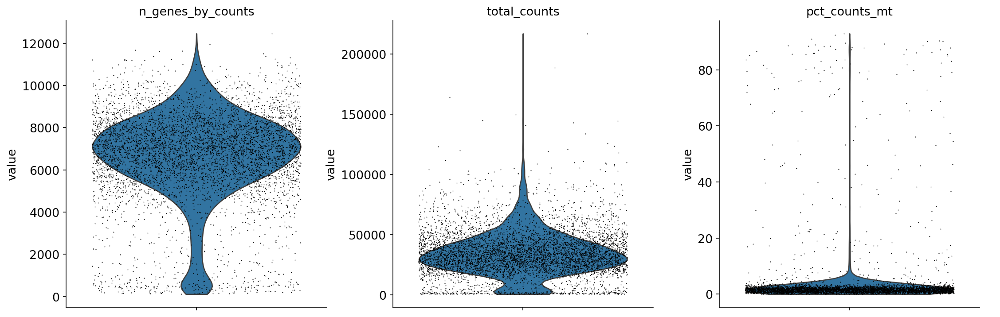

In [8]:
sc.pl.violin(
    adata,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

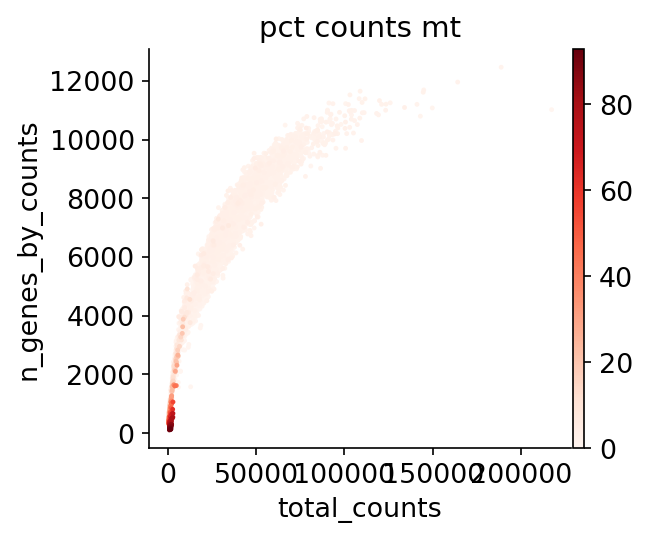

In [9]:
sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

In [10]:
_adata = adata[adata.obs['pct_counts_mt'] < 8]
adata = _adata

_adata = adata[adata.obs['total_counts'] < 100000]
adata = _adata

_adata = adata[adata.obs['n_genes_by_counts'] > 4000]
adata = _adata

sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=3)

/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:166: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_genes"] = number


In [12]:
# find and drop doublet
sc.pp.scrublet(adata)

In [13]:
# adata.obs['predicted_doublet']
_adata = adata[adata.obs['predicted_doublet'] == False]
adata = _adata

In [14]:
# Saving original count data
adata.layers["counts"] = adata.X.copy()

/tmp/ipykernel_906731/3737923038.py:2: ImplicitModificationWarning: Setting element `.layers['counts']` of view, initializing view as actual.
  adata.layers["counts"] = adata.X.copy()


In [15]:
# Normalizing to median total counts
sc.pp.normalize_total(adata)
# Logarithmize the data
sc.pp.log1p(adata)

In [16]:
sc.pp.highly_variable_genes(adata, n_top_genes=2000)

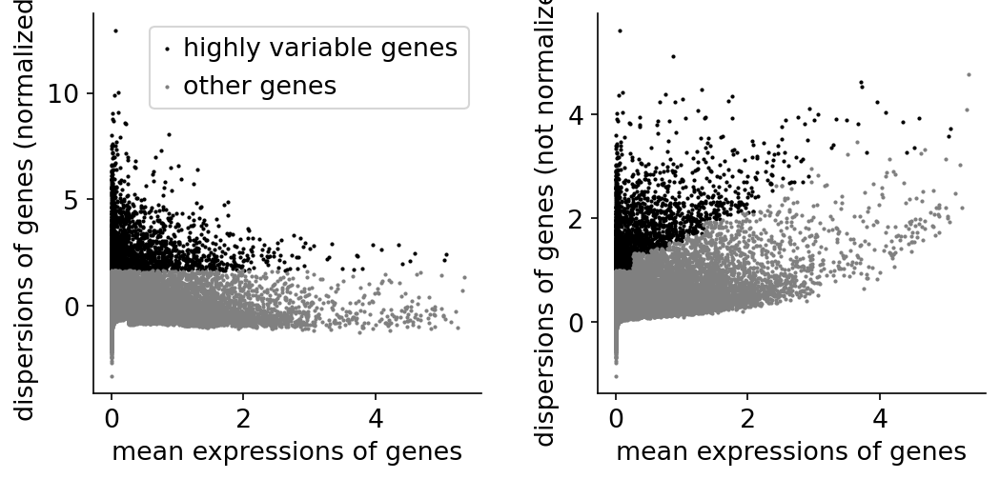

In [17]:
sc.pl.highly_variable_genes(adata)

In [18]:
sc.tl.pca(adata)

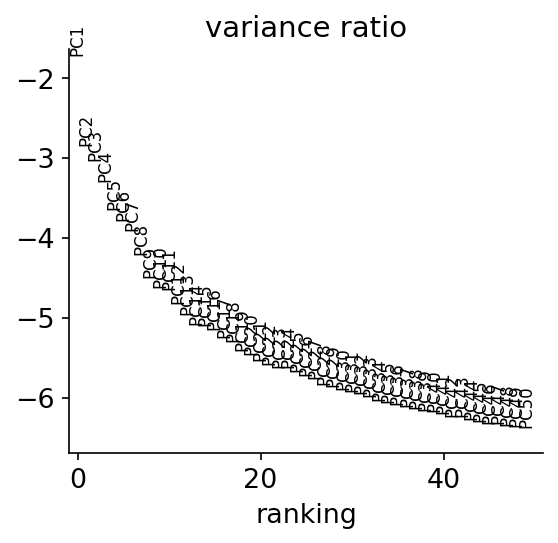

In [19]:
sc.pl.pca_variance_ratio(adata, n_pcs=50, log=True)

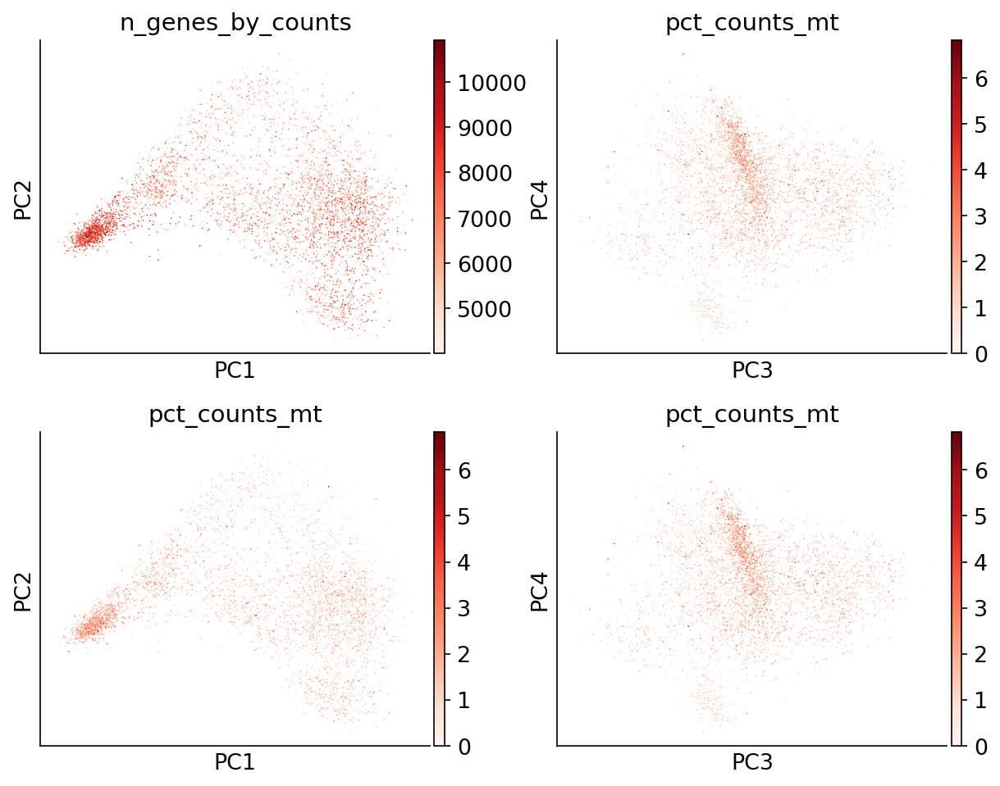

In [20]:
sc.pl.pca(
    adata,
    color=["n_genes_by_counts", "pct_counts_mt", "pct_counts_mt", "pct_counts_mt"],
    dimensions=[(0, 1), (2, 3), (0, 1), (2, 3)],
    ncols=2,
    size=2,
)

In [21]:
sc.pp.neighbors(adata, random_state=42)

In [22]:
sc.tl.umap(adata)

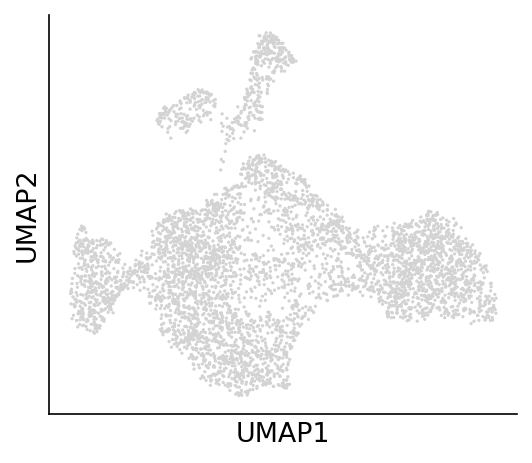

In [23]:
sc.pl.umap(
    adata,
    size=10,
)

In [24]:
sc.tl.leiden(adata, flavor="igraph", n_iterations=2)

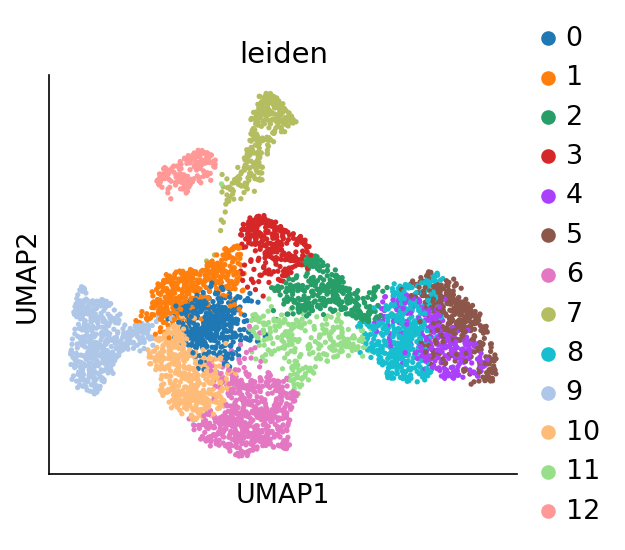

In [25]:
sc.pl.umap(adata, color=["leiden"])

In [26]:
sc.tl.draw_graph(adata)

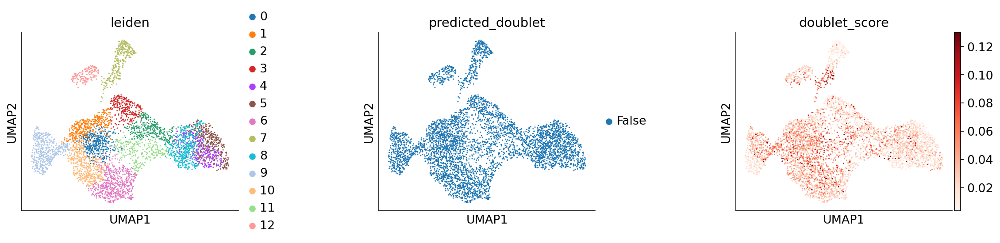

In [27]:
sc.pl.umap(
    adata,
    color=["leiden", "predicted_doublet", "doublet_score"],
    # increase horizontal space between panels
    wspace=0.5,
    size=8,
)

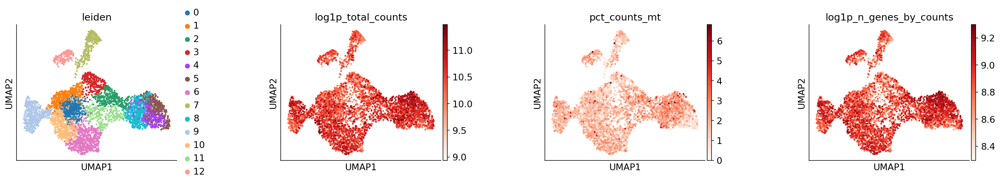

In [28]:
sc.pl.umap(
    adata,
    color=["leiden", "log1p_total_counts", "pct_counts_mt", "log1p_n_genes_by_counts"],
    wspace=0.5,
    ncols=8,
)

In [29]:
for res in [0.1, 0.5, 1.0, 2.0]:
    sc.tl.leiden(
        adata, key_added=f"leiden_res_{res:4.2f}", resolution=res, flavor="igraph"
    )

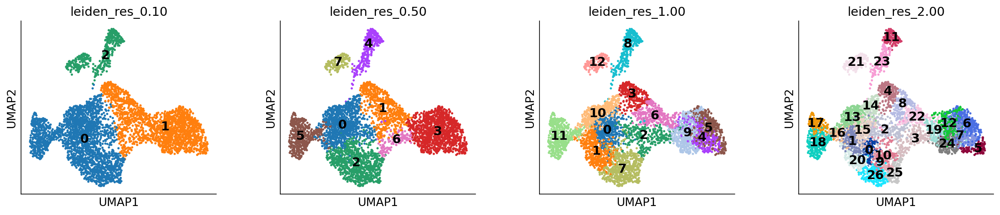

In [30]:
sc.pl.umap(
    adata,
    color=["leiden_res_0.10", "leiden_res_0.50", "leiden_res_1.00", "leiden_res_2.00"],
    legend_loc="on data",
)

In [31]:
# check marker expression for each cluster
marker_genes = {'AM': ['VTCN1', 'ISL1'],
 'Endoderm': ['FOXA2', 'GATA6', 'SOX17'],
 'PSC-like': ['POU5F1', 'SOX17', 'NANOG', 'NANOS3', 'TFAP2C'],
 'PSC-Ect': ['L1TD1', 'TERF1', 'DNMT3B', 'SEMA6A', 'NES'],
 'TB-like': ['KRT8', 'KRT18', 'CDH1', 'TFAP2A', 'PTN', 'GATA3'],
 'YSE': ['APOA1', 'APOA2', 'APOE', 'AFP', 'KRT19'],
 'Ect-like': ['KCNQ1OT1', 'SNHG14', 'DST', 'PRTG', 'TBX3'],
 'NE-like': ['SFRP2', 'GPC3', 'PAX6', 'FZD3', 'SOX2'],
 'NC': ['PLP1', 'FOXD3', 'PAX3', 'SOX10', 'SOX11'],
 'Mes-like': ['PITX1', 'TMEM88', 'HAND1', 'BMP4', 'ACTC1', 'ISL1'],
 'Mes-PS': ['TBXT', 'MESP1', 'EOMES', 'PDGFRA'],
 'CM-like': ['NKX2-5', 'MSX1', 'MSX2', 'MDK', 'ID3'],
 'Fibro': ['ANGPT1', 'HGF', 'FBN1', 'ITGA1', 'MME', 'PDGFRA', 'ACTA2'],
 'EC': ['KDR', 'CDH5', 'PECAM1', 'VWF', 'CD34'],
 'HPC': ['RUNX1', 'IL5RA', 'ITGB2', 'CEBPB', 'IFI6'],
 'Ery': ['HBZ', 'HBA1', 'HBA2', 'GYPA', 'TFRC'],
 'Mk': ['PF4', 'PPBP', 'GP9', 'PLEK', 'THBS1'],
 'EMP': ['GYPB', 'GIHCG', 'HDC', 'ARHGDIB', 'GMFG'],
 'MP-1': ['PRG2', 'EPX', 'PRSS57', 'MS4A3'],
 'MP-2': ['LMO4', 'GATA2', 'PTPRC', 'KCNK17', 'FCER1G'],
 'Mono': ['CD14', 'S100A9', 'S100B']}

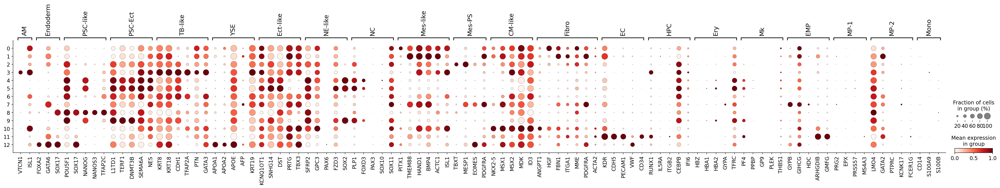

In [32]:
sc.pl.dotplot(adata, marker_genes, groupby="leiden_res_1.00", standard_scale="var")

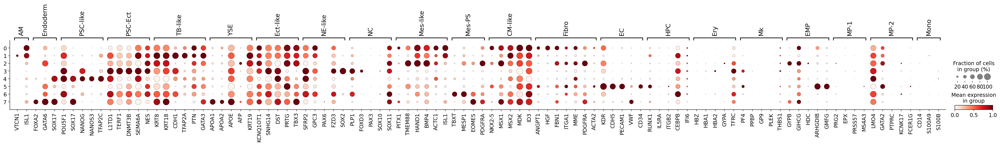

In [33]:
sc.pl.dotplot(adata, marker_genes, groupby="leiden_res_0.50", standard_scale="var")

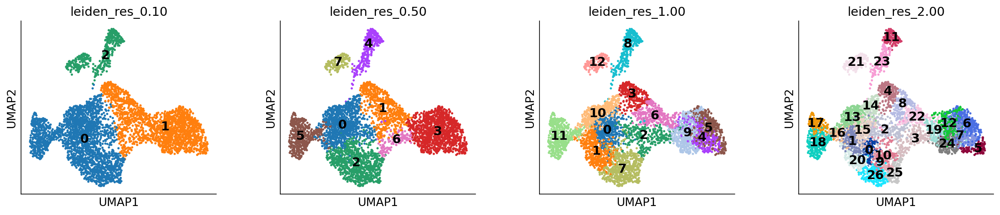

In [34]:
sc.pl.umap(
    adata,
    color=["leiden_res_0.10", "leiden_res_0.50", "leiden_res_1.00", "leiden_res_2.00"],
    legend_loc="on data",
)

In [35]:
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(adata, groupby="leiden_res_0.50", method="wilcoxon")

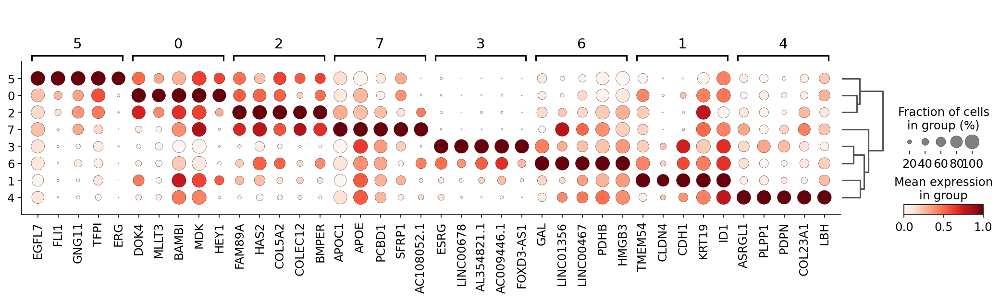

In [36]:
sc.pl.rank_genes_groups_dotplot(
    adata, groupby="leiden_res_0.50", standard_scale="var", n_genes=5
)

In [37]:
sc.get.rank_genes_groups_df(adata, group="7").head(5)

,names,scores,logfoldchanges,pvals,pvals_adj
0,APOC1,20.286230,4.023979,1.701521e-91,4.954150e-87
1,APOE,18.984570,2.028485,2.288027e-80,3.330910e-76
2,PCBD1,18.427885,2.520887,7.849241e-76,7.617950e-72
3,SFRP1,18.091408,3.426408,3.724466e-73,2.711039e-69
4,AC108052.1,18.035082,4.239683,1.033426e-72,6.017845e-69


In [38]:
# Using following query to comfirm cell type with chatGPT-4o
print("I am analysising early stage of human embryonic organoids hematopoiesis single cell data.")
gn = 8
print("based on the gene expression umap, there are %s groups in my data" % (gn))
print("i want to find the group like 'Ectoderm', 'Mesoderm', 'PSC-like', 'TB-like', 'Endoderm', 'Ect-like', 'Fibro', 'PSC-Ect', 'Mes-like', 'PSC-like', 'TB-like', 'CM-like', 'YSE', 'Endo', 'NC', 'NE-like', etc.")
print("please help me identify or find the cell types based on the following group id and its most differed expressed gene (rank by rank genes scores):")      
for i in range(gn):
    print("group %s: %s" % (i, ','.join(sc.get.rank_genes_groups_df(adata, group=str(i)).head(15)['names'].values.tolist())))

I am analysising early stage of human embryonic organoids hematopoiesis single cell data.
based on the gene expression umap, there are 8 groups in my data
i want to find the group like 'Ectoderm', 'Mesoderm', 'PSC-like', 'TB-like', 'Endoderm', 'Ect-like', 'Fibro', 'PSC-Ect', 'Mes-like', 'PSC-like', 'TB-like', 'CM-like', 'YSE', 'Endo', 'NC', 'NE-like', etc.
please help me identify or find the cell types based on the following group id and its most differed expressed gene (rank by rank genes scores):
group 0: DOK4,MLLT3,BAMBI,MDK,HEY1,UNC5C,B2M,GNAS,SEPTIN7,GLI3,CTHRC1,CDH11,HAND2,C1orf21,NRP2
group 1: TMEM54,CLDN4,CDH1,KRT19,ID1,GRHL2,ID4,RAB25,KRT8,ERRFI1,EPCAM,PATJ,TFAP2A,MIR205HG,EZR
group 2: FAM89A,HAS2,COL5A2,COLEC12,BMPER,TMEM88,BMP4,HS3ST3A1,ALPK2,LGR5,GLIPR2,HECW2,ANXA6,APLNR,SLPI
group 3: ESRG,LINC00678,AL354821.1,AC009446.1,FOXD3-AS1,SOX2,TERF1,USP44,DPPA4,PTPRZ1,AC022140.1,GRID2,TDGF1,UGP2,GABRB3
group 4: ASRGL1,PLPP1,PDPN,COL23A1,LBH,SAT1,ITGA6,PRDM1,SOX17,TMEM123,CERT1,MKRN

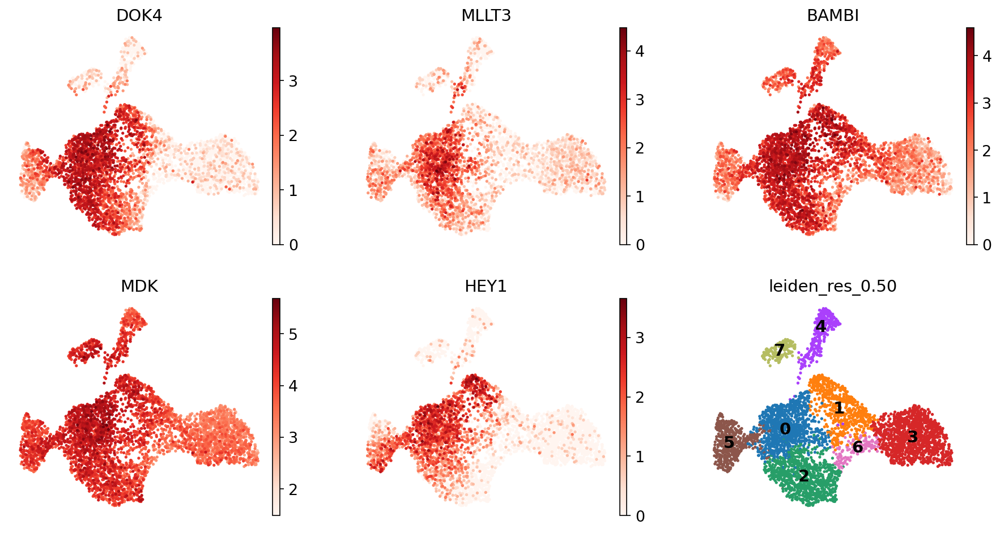

In [39]:
dc_cluster_genes = sc.get.rank_genes_groups_df(adata, group="0").head(5)["names"]
sc.pl.umap(
    adata,
    color=[*dc_cluster_genes, "leiden_res_0.50"],
    legend_loc="on data",
    frameon=False,
    ncols=3,
)

In [40]:
# check marker expression for each cluster
marker_genes = {'AM': ['VTCN1', 'ISL1'],
 'Endoderm': ['FOXA2', 'GATA6', 'SOX17'],
 'PSC-like': ['POU5F1', 'SOX17', 'NANOG', 'NANOS3', 'TFAP2C'],
 'PSC-Ect': ['L1TD1', 'TERF1', 'DNMT3B', 'SEMA6A', 'NES'],
 'TB-like': ['KRT8', 'KRT18', 'CDH1', 'TFAP2A', 'PTN', 'GATA3'],
 'YSE': ['APOA1', 'APOA2', 'APOE', 'AFP', 'KRT19'],
 'Ect-like': ['KCNQ1OT1', 'SNHG14', 'DST', 'PRTG', 'TBX3'],
 'NE-like': ['SFRP2', 'GPC3', 'PAX6', 'FZD3', 'SOX2'],
 'NC': ['PLP1', 'FOXD3', 'PAX3', 'SOX10', 'SOX11'],
 'Mes-like': ['PITX1', 'TMEM88', 'HAND1', 'BMP4', 'ACTC1', 'ISL1'],
 'Mes-PS': ['TBXT', 'MESP1', 'EOMES', 'PDGFRA'],
 'CM-like': ['NKX2-5', 'MSX1', 'MSX2', 'MDK', 'ID3'],
 'Fibro': ['ANGPT1', 'HGF', 'FBN1', 'ITGA1', 'MME', 'PDGFRA', 'ACTA2'],
 'EC': ['KDR', 'CDH5', 'PECAM1', 'VWF', 'CD34'],
 'HPC': ['RUNX1', 'IL5RA', 'ITGB2', 'CEBPB', 'IFI6'],
 'Ery': ['HBZ', 'HBA1', 'HBA2', 'GYPA', 'TFRC'],
 'Mk': ['PF4', 'PPBP', 'GP9', 'PLEK', 'THBS1'],
 'EMP': ['GYPB', 'GIHCG', 'HDC', 'ARHGDIB', 'GMFG'],
 'MP-1': ['PRG2', 'EPX', 'PRSS57', 'MS4A3'],
 'MP-2': ['LMO4', 'GATA2', 'PTPRC', 'KCNK17', 'FCER1G'],
 'Mono': ['CD14', 'S100A9', 'S100B']}

In [41]:
adata.obs["cell_type"] = adata.obs["leiden_res_0.50"].map(
    {
        "0": "Mes-like",
        "1": "TB-like",
        "2": "Fibro",
        "3": "PSC-Ect",
        "4": "PSC-like",
        "5": "EC",
        "6": "Mes-PS",
        "7": "Endoderm",
    }
)
# Mesoderm (Primitive Streak/Cardiac)

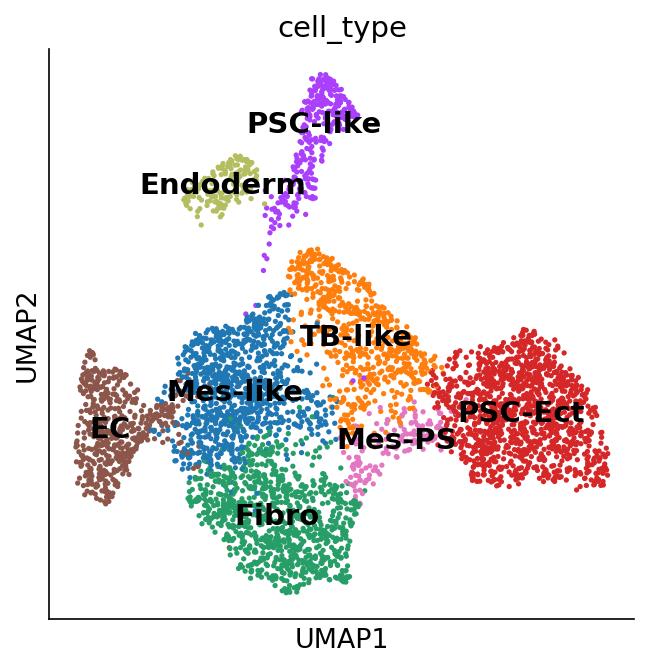

In [42]:
fig, ax = plt.subplots(figsize=(5, 5))
sc.pl.umap(adata, color=["cell_type"], legend_loc="on data", ax=ax)

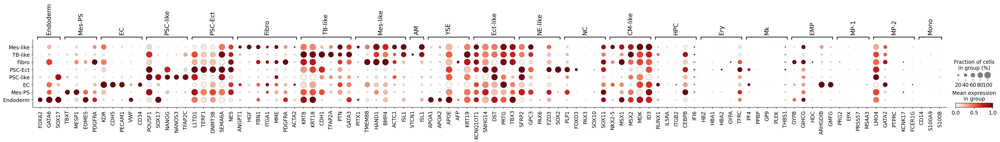

In [43]:
n_marker_genes = {i: marker_genes[i] for i in ['Mes-like', 'TB-like', 'Fibro', 'PSC-Ect', 'PSC-like', 'EC', 'Mes-PS', 'Endoderm'][::-1]}
n_marker_genes = n_marker_genes | {i: marker_genes[i] for i in marker_genes}

sc.pl.dotplot(adata, n_marker_genes, groupby="cell_type", standard_scale="var")

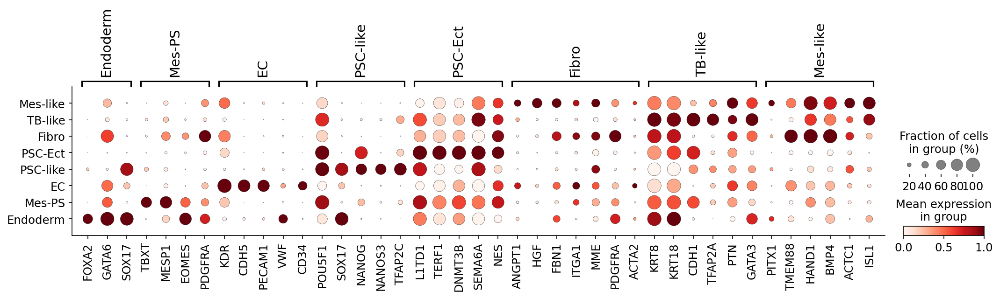

In [44]:
n_marker_genes = {i: marker_genes[i] for i in ['Mes-like', 'TB-like', 'Fibro', 'PSC-Ect', 'PSC-like', 'EC', 'Mes-PS', 'Endoderm'][::-1]}
# n_marker_genes = n_marker_genes | {i: marker_genes[i] for i in marker_genes}

sc.pl.dotplot(adata, n_marker_genes, groupby="cell_type", standard_scale="var")

In [45]:
# save result
results_file = filedir + "/rst_d4.h5ad"
adata.write(results_file, compression="gzip")

In [46]:
adata.obs['cell_type'].to_csv(filedir + "/cell_type_0310.csv")

In [47]:
# reload data
results_file = filedir + "/rst_d4.h5ad"
adata = ad.read_h5ad(results_file)

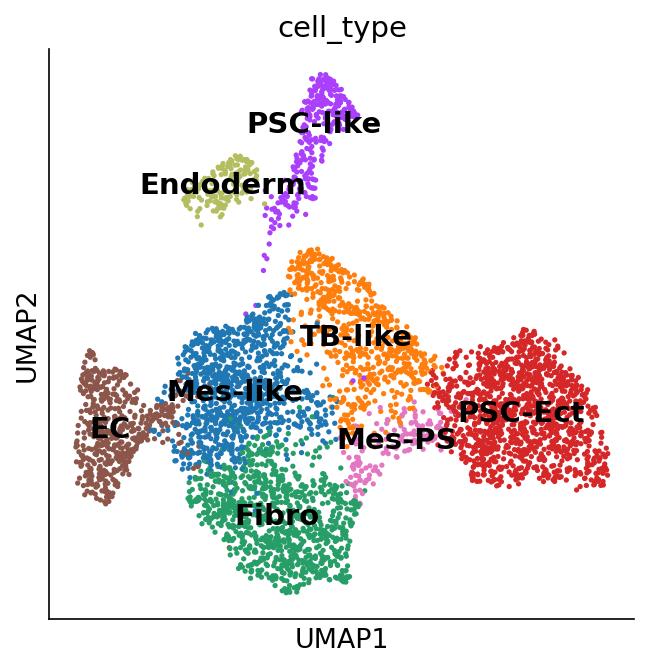

In [48]:
fig, ax = plt.subplots(figsize=(5, 5))
sc.pl.umap(adata, color=["cell_type"], legend_loc="on data", ax=ax)

# 2. Load MAESTER mtDNA data

In [49]:
# run preprocess/2_run_snp.sh and preprocess/3_run_mquad.sh to get informative snp
# run MAESTER_get_clone_D4 to further filter snp and get clone information
maester_p = "/autofs/bal31/jhsu/home/projects/sc/data/hemo_paper_larry/larry-maester-d4/maester/tree_out/"

maester_c_f = maester_p + "clone.csv"
maester_clone_df = pd.read_csv(maester_c_f, header=0)
maester_clone_df.barcode = maester_clone_df.barcode.apply(lambda x: x+"-1")
print(maester_clone_df.head())
maester_clone_df.clone.value_counts()

af_o_df = pd.read_csv(maester_p + "clone_af.csv", sep="\t", header=0,  index_col=0)
af_m = af_o_df.to_numpy(dtype=np.float64)

snp_id = ["%s%s>%s" % (tuple(i.split("_")[1:])) for i in af_o_df.index]
print(len(snp_id))

af_df = pd.DataFrame(af_m.T, columns=snp_id, dtype=np.float64)
af_columns = af_df.columns
# print(len(af_columns))/
af_columns_o = sorted(af_columns, key=lambda x:int(x[:-3]))
af_df = af_df[af_columns_o]
af_df['barcode'] = af_o_df.columns + "-1"
af_df.head(3)

              barcode     clone
0  AAACCCACAAGACCTT-1  clone_A2
1  AAACCCACATCGCTGG-1  clone_A0
2  AAACCCAGTCAGGTAG-1  clone_A1
3  AAACCCAGTCGTCAGC-1  clone_A0
4  AAACCCATCAAACCTG-1  clone_A1
35


,1123C>A,1380G>A,1521T>A,1522T>A,1525C>A,1526T>A,2317G>A,2349G>A,2352T>A,2501C>A,...,8087T>G,8271A>T,8576T>G,9025G>A,9204A>G,12136T>G,12139A>G,13037C>T,15016C>A,barcode
0,0.093333,0.045455,0.0,0.0,0.000000,0.000000,0.007353,0.011321,0.026616,0.019608,...,0.049020,0.023055,0.026178,0.0,0.078947,0.094340,0.037037,0.0,0.100000,AAACCCACAAGACCTT-1
1,0.044444,0.033333,0.0,0.0,0.021739,0.021277,0.019231,0.000000,0.018405,0.034884,...,0.035533,0.031153,0.077922,0.0,0.174312,0.054945,0.014085,0.0,0.022222,AAACCCACATCGCTGG-1
2,0.060606,0.057143,0.0,0.0,0.000000,0.066667,0.019608,0.006623,0.033557,0.033333,...,0.033058,0.051546,0.020408,0.0,0.064516,0.000000,0.029412,0.0,0.000000,AAACCCAGTCAGGTAG-1


In [50]:
c_o = sorted(maester_clone_df['clone'].unique(), key=lambda x:int(x[7:]))
print(c_o)
# maester_clone_df.head()

['clone_A0', 'clone_A1', 'clone_A2']


Text(0.5, 1.0, 'Mean AF')

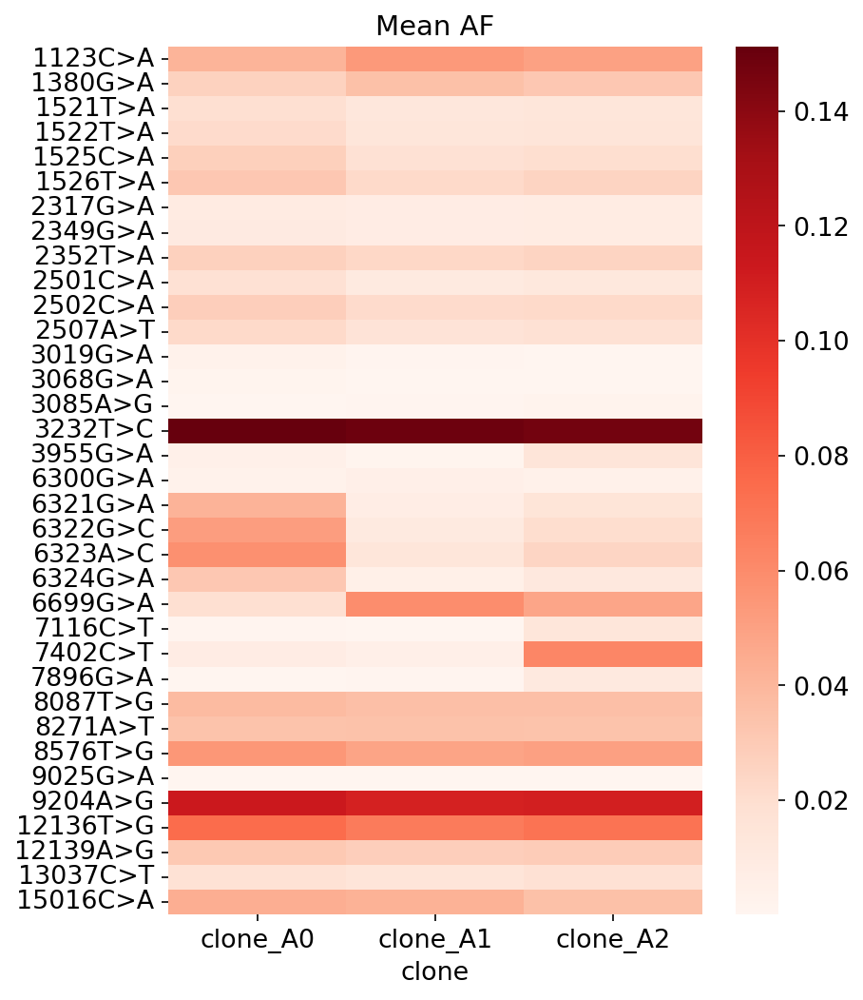

In [53]:
tmp_merge_o = pd.merge(af_df, maester_clone_df, how='inner')
tar_merge = tmp_merge_o.groupby('clone').agg({i: 'mean' for i in af_columns})
tar_merge = tar_merge[af_columns_o]
tar_merge = tar_merge.reindex(c_o)

import seaborn as sns
plt.figure(figsize = (6,8))
ax = sns.heatmap(tar_merge.T, cmap="Reds", xticklabels=True, yticklabels=True)
ax.set_title("Mean AF")

In [54]:
mer_df = pd.merge(adata.obs, tmp_merge_o, how='left', left_index=True, right_on='barcode')
mer_df.shape

(4682, 63)

In [55]:
# filter cell without maester label
_adata = adata[mer_df.clone.notna()]
_adata.obs = pd.merge(_adata.obs, tmp_merge_o, how='left', left_index=True, right_on='barcode')
_adata

/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:767: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


AnnData object with n_obs × n_vars = 4616 × 29116
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_genes', 'doublet_score', 'predicted_doublet', 'leiden', 'leiden_res_0.10', 'leiden_res_0.50', 'leiden_res_1.00', 'leiden_res_2.00', 'cell_type', '1123C>A', '1380G>A', '1521T>A', '1522T>A', '1525C>A', '1526T>A', '2317G>A', '2349G>A', '2352T>A', '2501C>A', '2502C>A', '2507A>T', '3019G>A', '3068G>A', '3085A>G', '3232T>C', '3955G>A', '6300G>A', '6321G>A', '6322G>C', '6323A>C', '6324G>A', '6699G>A', '7116C>T', '7402C>T', '7896G>A', '8087T>G', '8271A>T', '8576T>G', '9025G>A', '9204A>G', '12136T>G', '12139A>G', '13037C>T', '15016C>A', 'barco

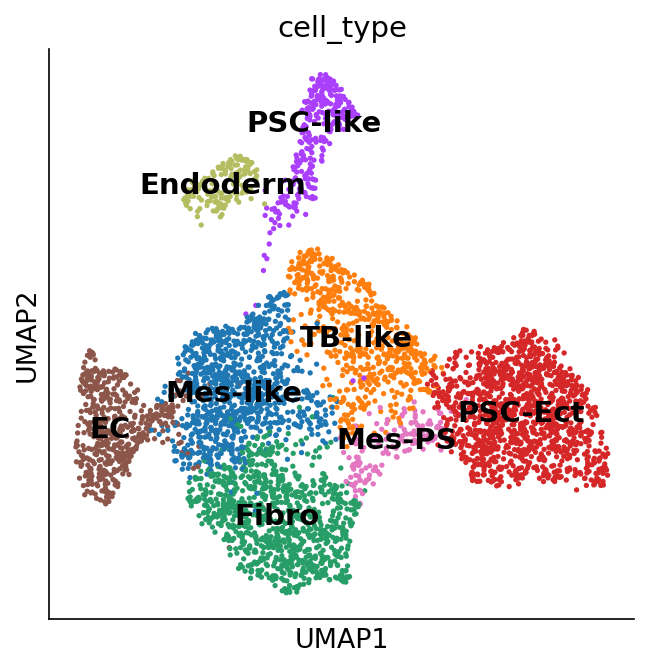

In [56]:
fig, ax = plt.subplots(figsize=(5, 5))
sc.pl.umap(_adata, color=["cell_type"], legend_loc="on data", ax=ax)

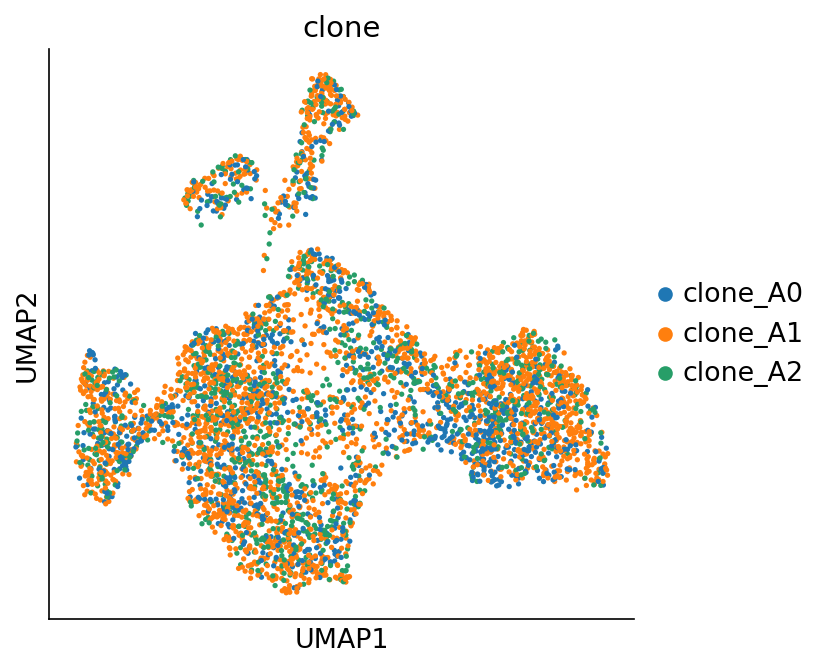

In [57]:
fig, ax = plt.subplots(figsize=(5, 5))
sc.pl.umap(_adata, color=["clone"],  ax=ax)

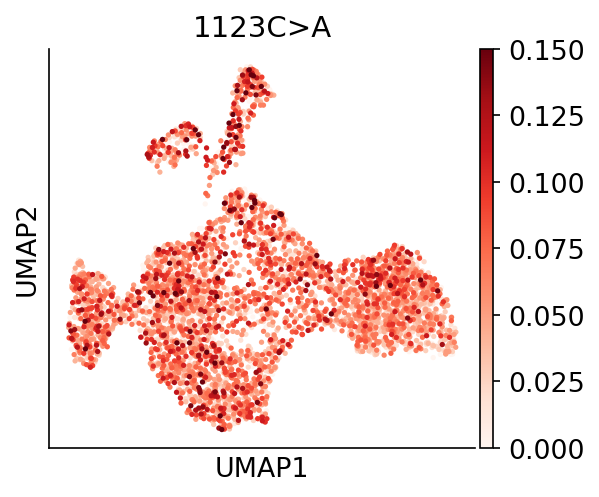

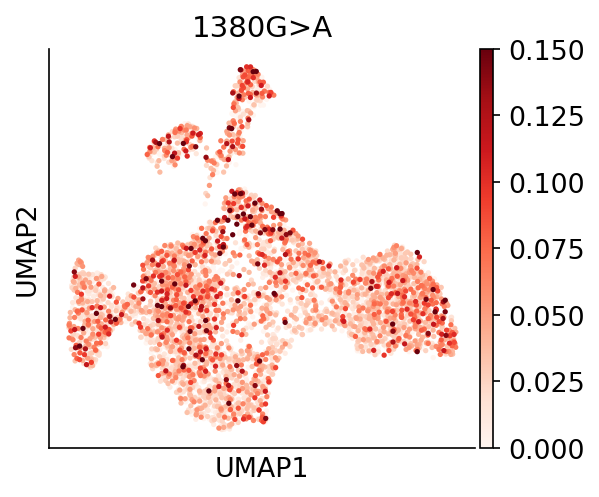

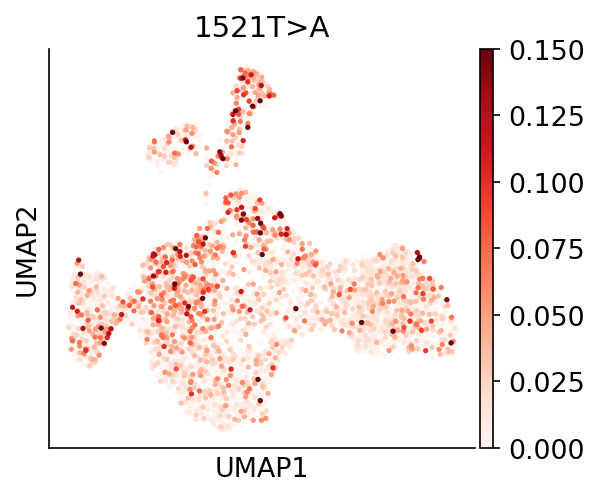

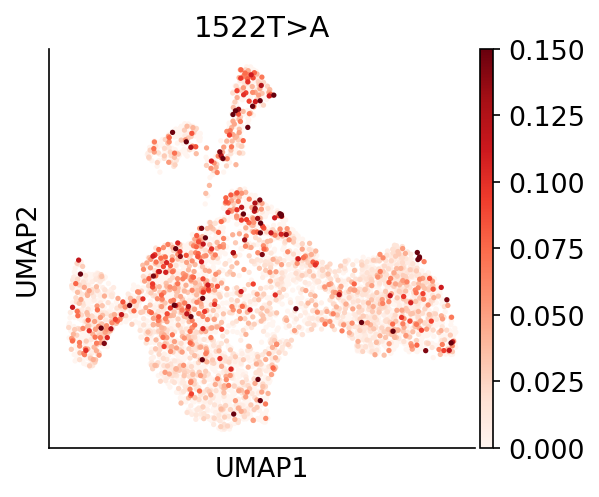

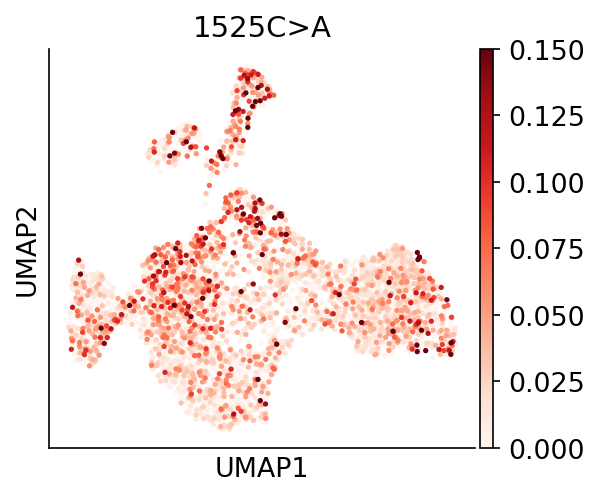

...

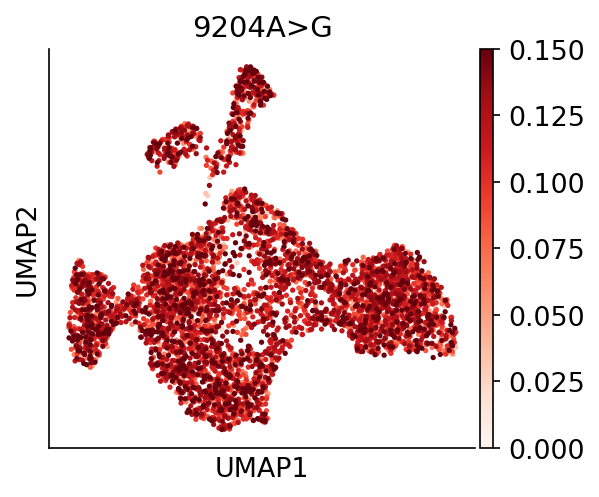

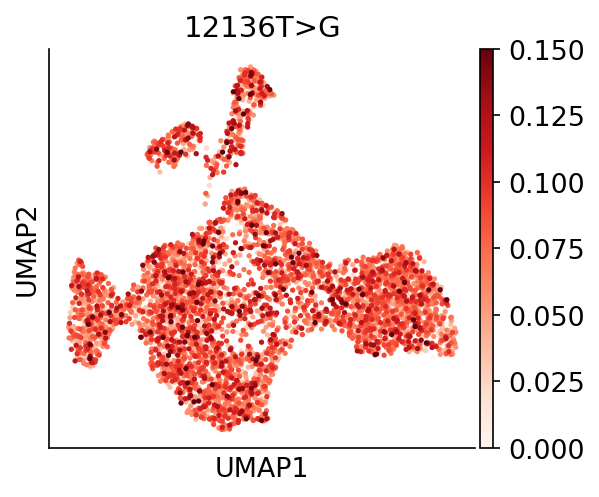

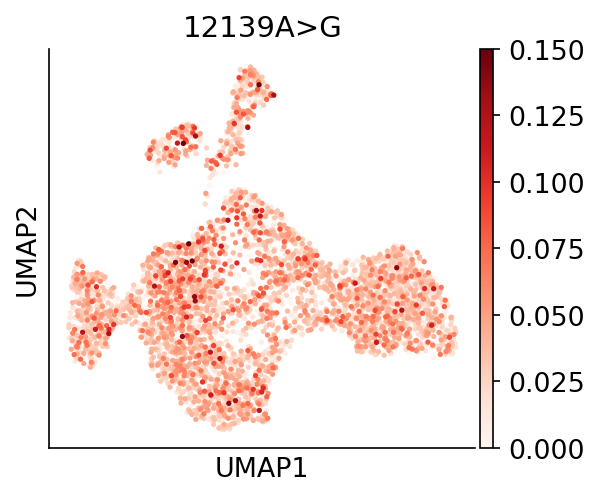

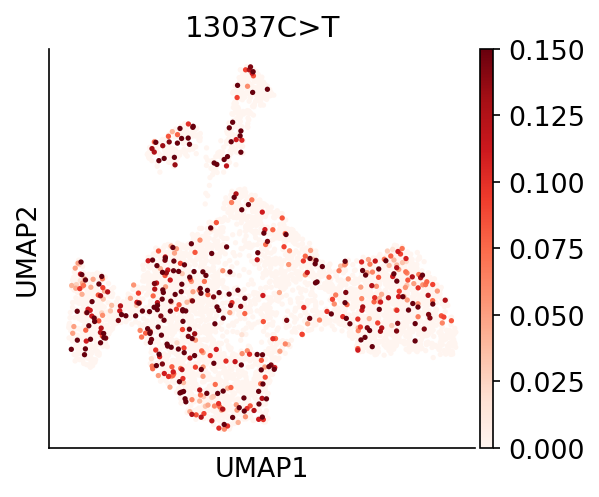

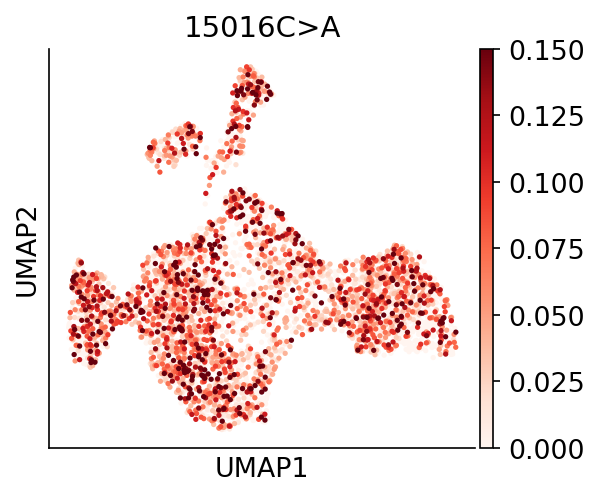

In [58]:
# check each mtDNA AF in umap
for snp_id in af_df.columns[:-1]:
    sc.pl.umap(_adata, color=[snp_id], vmax=0.15)

In [62]:
#cell cell distance

import multiprocessing as mp
from datetime import datetime


def get_cell_dis_dev(mat, v_prior, i, j):
    if i < j:
        # return (abs(mat[i, :] - mat[j, :]) * v_prior).sum()
        return (abs(mat[i, :] - mat[j, :]) * 1).sum()
    else:
        return 0

def get_distance(mat, n_core=64):
    cell_n, _v_n = mat.shape

    v_mean_af = mat.mean(0)
    v_prior = 1 - v_mean_af

    p = mp.Pool(n_core)
    results = p.starmap(get_cell_dis_dev, ((mat, v_prior, i, j) for i in range(cell_n) for j in range(cell_n) ))
    results = np.array(results).reshape(cell_n, cell_n)
#     # assign all element
    i_lower = np.tril_indices(cell_n, -1)
    results[i_lower] = results.T[i_lower]

    p.close()
    p.join()
    return results

# get cell-cell distance
start_time = datetime.now()
_af_df = _adata.X[:, _adata.var['highly_variable']].todense()
_tmp_tar_label = _adata.obs['cell_type']

tar_m = np.array(_af_df)
ps_map = get_distance(tar_m)
end_time = datetime.now()

print('Computed cell-cell distance. (in {}s)'.format(end_time - start_time))

Computed cell-cell distance. (in 0:00:54.376743s)


4616


[Text(1, 0.5, 'Endoderm'),
 Text(1, 1.5, 'PSC-like'),
 Text(1, 2.5, 'EC'),
 Text(1, 3.5, 'Mes-like'),
 Text(1, 4.5, 'Fibro'),
 Text(1, 5.5, 'Mes-PS'),
 Text(1, 6.5, 'PSC-Ect'),
 Text(1, 7.5, 'TB-like')]

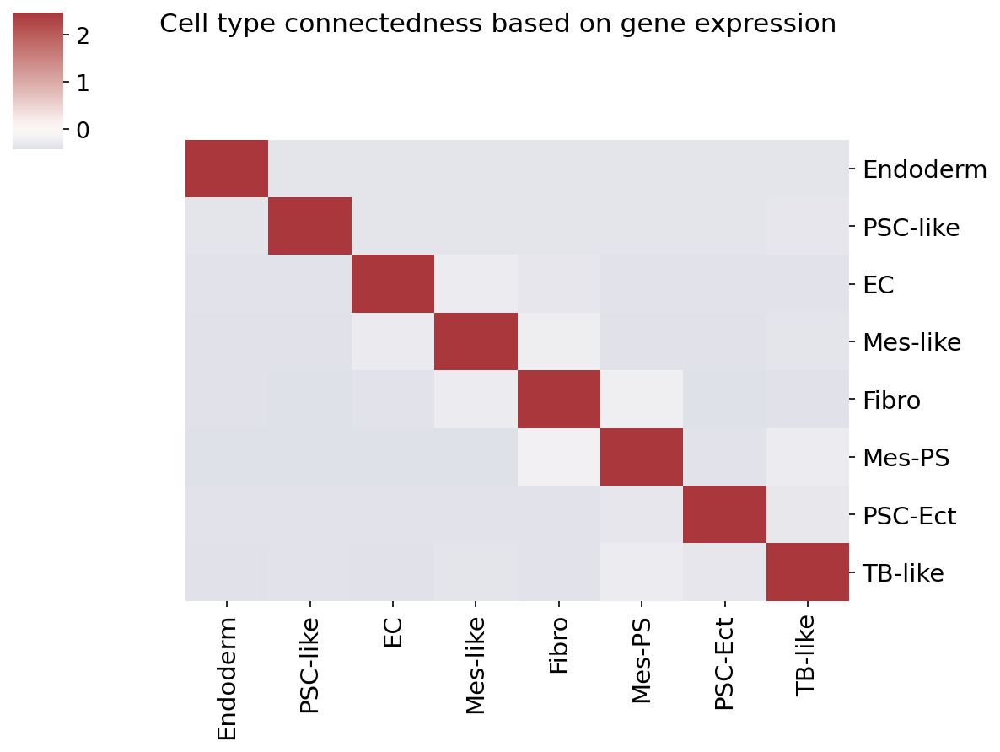

In [63]:
import seaborn as sns
# connectness
import networkx as nx


def from_dist_to_graph(d, k_param=30, return_nx_graph=True):
    if not isinstance(d, np.ndarray):
        d = d.values

    n_cells = d.shape[0]
    knn_mat = np.zeros((n_cells, k_param), dtype=int)
    knd_mat = np.zeros((n_cells, k_param))
    print(n_cells)
    # Find k nearest neighbors for each cell
    for i in range(n_cells):
        knn_indices = np.argsort(d[i, :])[:k_param]
        knn_mat[i, :] = knn_indices
        knd_mat[i, :] = d[i, knn_indices]

    nn_dist = knn_mat[:, :k_param]
    knn = nn_dist
    
    # Compute mutual k-nearest neighbors (MNN)
    knn2 = []
    for i in range(knn.shape[0]):
        xx = np.apply_along_axis(lambda x: i in x, 1, knn[knn[i, 1:], :])
        if np.sum(xx) > 0:
            temp_knn = np.concatenate(([knn[i, 0]], knn[i, 1:][xx]))
            temp_el = [[temp_knn[0], neighbor] for neighbor in temp_knn[1:]]
        # else:
        #     temp_el = [[knn[i, 0], knn[i, 1]]]
            knn2.extend(temp_el)

    el = np.array(knn2)
    graph = nx.Graph()
    graph.add_nodes_from(range(n_cells))

    graph.add_edges_from(el)

    mutual_knn = nx.to_numpy_array(graph, nodelist=range(n_cells))
    
    # mutual_knn = nx.to_numpy_array(graph, nodelist=sorted(graph.nodes()))

    # mutual_knn = nx.to_numpy_array(graph)
    if return_nx_graph:
        return mutual_knn, graph
    else:
        return mutual_knn, _

def aggregate_distance_matrix_by_class(X, class_df, cls_n="clone"):
    # Get unique classes
    classes = class_df.iloc[:, 0].unique()
    # Initialize a dictionary to store the results
    results = {}
    # Iterate over each class as the target class
    for target_class in classes:
        # Get the nodes that belong to the target class
        # print(target_class)
        target_nodes = class_df[class_df[cls_n] == target_class].index
        # print(target_nodes)
        # Initialize a dictionary to count connections to each class
        connection_counts = {cls: 0 for cls in classes}
        total_connections = 0
        # Iterate over each node in the target class
        for node in target_nodes:
            # Get the connections of the current node
            connections = X[node, :]
            # Count connections to each class
            for connected_node in np.where(connections == 1)[0]:
                connected_class = class_df.loc[connected_node, cls_n]
                # print(target_class, connected_node, connected_class)
                connection_counts[connected_class] += 1
                total_connections += 1
        # Calculate the proportion of connections to each class
        proportions = {cls: (count / total_connections * 100 if total_connections > 0 else 0) for cls, count in connection_counts.items()}
        # Store the result for the target class
        results[target_class] = proportions
    # Convert the result dictionary to a DataFrame for a better presentation
    results_df = pd.DataFrame(results).T
    return results_df, sorted(classes)


def get_connectness(ps_map, cls_df, af_df, k_param=30, cls_n = 'cell_type'):
    knn_mat, knn_graph = from_dist_to_graph(ps_map, k_param, return_nx_graph=True)
    X = knn_mat

    class_df = cls_df[["barcode", cls_n]].set_index('barcode')
    results_df, no = aggregate_distance_matrix_by_class(X, class_df, cls_n)

    tmp_df = results_df.loc[no, no]
    tmp_df = (tmp_df + tmp_df.T ) / 2
    g = sns.clustermap(tmp_df, annot=False, xticklabels=True, yticklabels=True, row_cluster=True, col_cluster=False, figsize=(8,6), z_score=0, cmap="vlag", center=0)
    plt.close()
    row_order = g.dendrogram_row.reordered_ind
    tmp_df_reordered = tmp_df.iloc[row_order, row_order]
    g = sns.clustermap(tmp_df_reordered, annot=False, xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=False, figsize=(8,6), z_score=0, cmap="vlag", center=0)
    g.fig.suptitle("Cell type in mtDNA lineage-tracing-based neighborhood", fontsize=15)
    g.ax_heatmap.set_xlabel("Cell type of clonal neighbors", fontsize=15)
    g.ax_heatmap.set_ylabel("Cell type of query cells", fontsize=15)
    g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize=14)  # Set x-axis label size
    g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), fontsize=14) 
    # _out_png_f = "%s/2_clone_connectness.png" % (out_dir)
    # plt.savefig(_out_png_f, bbox_inches='tight')



k_param=30

o_af_df = _adata.X[:, _adata.var['highly_variable']].todense()
cls_df = _adata.obs[['barcode', 'cell_type']].copy()
cls_n = 'cell_type'


knn_mat, knn_graph = from_dist_to_graph(ps_map, k_param, return_nx_graph=True)
# nx.draw(knn_graph)
X = knn_mat

class_df = cls_df[["barcode", cls_n]].set_index('barcode').reset_index()[[cls_n]]
results_df, no = aggregate_distance_matrix_by_class(X, class_df, cls_n)

tmp_df = results_df.loc[no, no]
tmp_df = (tmp_df + tmp_df.T ) / 2
g = sns.clustermap(tmp_df, annot=False, xticklabels=True, yticklabels=True, row_cluster=True, col_cluster=True, figsize=(8,6), z_score=0, cmap="vlag", center=0)
plt.close()
row_order = g.dendrogram_row.reordered_ind
tmp_df_reordered = tmp_df.iloc[row_order, row_order]
# tmp_df_reordered = (tmp_df_reordered - tmp_df_reordered.stack().std()) /  tmp_df_reordered.stack().std()
g = sns.clustermap(tmp_df_reordered, annot=False, xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=False, figsize=(8,6),  z_score=0, cmap="vlag", center=0)
g.fig.suptitle("Cell type connectedness based on gene expression", fontsize=15)
# g.ax_heatmap.set_xlabel("Cell type of clonal neighbors", fontsize=15)
# g.ax_heatmap.set_ylabel("Cell type of query cells", fontsize=15)
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize=14)  # Set x-axis label size
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), fontsize=14) 

In [64]:
#cell cell distance

import multiprocessing as mp
from datetime import datetime


def get_cell_dis_dev(mat, v_prior, i, j):
    if i < j:
        # return (abs(mat[i, :] - mat[j, :]) * v_prior).sum()
        return (abs(mat[i, :] - mat[j, :]) * 1).sum()
    else:
        return 0

def get_distance(mat, n_core=64):
    cell_n, _v_n = mat.shape

    v_mean_af = mat.mean(0)
    v_prior = 1 - v_mean_af

    p = mp.Pool(n_core)
    results = p.starmap(get_cell_dis_dev, ((mat, v_prior, i, j) for i in range(cell_n) for j in range(cell_n) ))
    results = np.array(results).reshape(cell_n, cell_n)
#     # assign all element
    i_lower = np.tril_indices(cell_n, -1)
    results[i_lower] = results.T[i_lower]

    p.close()
    p.join()
    return results

# get cell-cell distance
start_time = datetime.now()
# cell * variants

_tar_df = tmp_merge_o.merge(_adata.obs[['barcode', 'cell_type']], how='left').dropna().reset_index()
_tar_col = af_columns_o
_af_df = _tar_df[_tar_col]

tar_m = np.array(_af_df)
ps_map = get_distance(tar_m)
end_time = datetime.now()

print('Computed cell-cell distance. (in {}s)'.format(end_time - start_time))

Computed cell-cell distance. (in 0:00:25.270163s)


4616


[Text(1, 0.5, 'Mes-like'),
 Text(1, 1.5, 'PSC-like'),
 Text(1, 2.5, 'PSC-Ect'),
 Text(1, 3.5, 'Fibro'),
 Text(1, 4.5, 'Mes-PS'),
 Text(1, 5.5, 'TB-like'),
 Text(1, 6.5, 'EC'),
 Text(1, 7.5, 'Endoderm')]

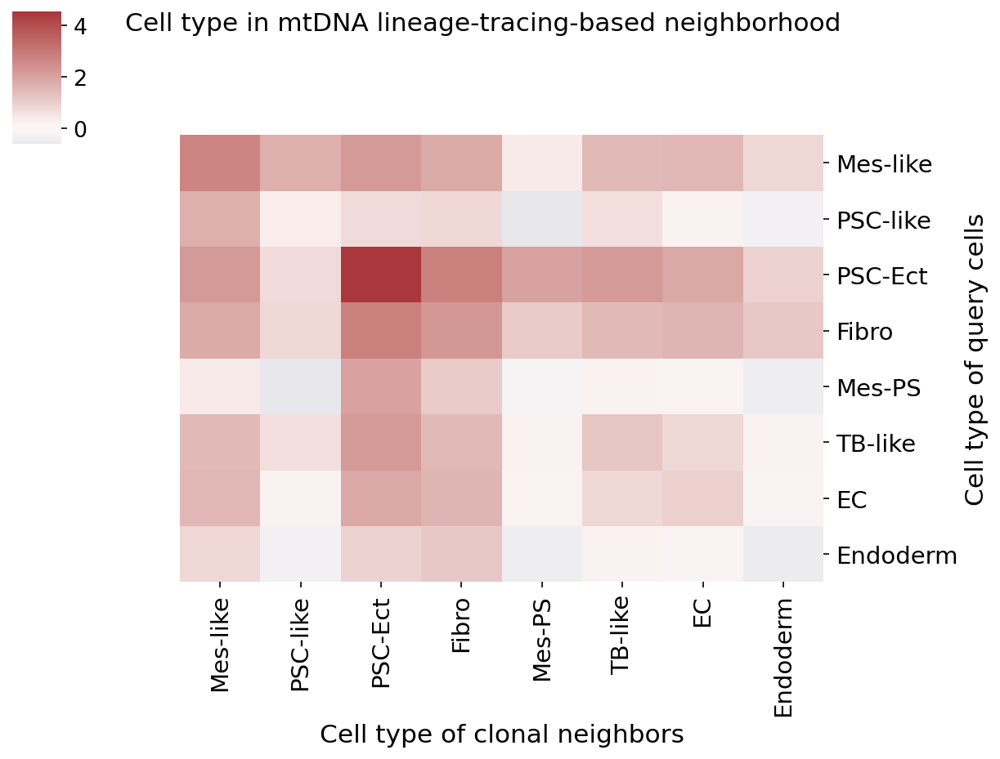

In [65]:
import seaborn as sns
# connectness
import networkx as nx


def from_dist_to_graph(d, k_param=30, return_nx_graph=True):
    if not isinstance(d, np.ndarray):
        d = d.values

    n_cells = d.shape[0]
    knn_mat = np.zeros((n_cells, k_param), dtype=int)
    knd_mat = np.zeros((n_cells, k_param))
    print(n_cells)
    # Find k nearest neighbors for each cell
    for i in range(n_cells):
        knn_indices = np.argsort(d[i, :])[:k_param]
        knn_mat[i, :] = knn_indices
        knd_mat[i, :] = d[i, knn_indices]

    nn_dist = knn_mat[:, :k_param]
    knn = nn_dist
    
    # Compute mutual k-nearest neighbors (MNN)
    knn2 = []
    for i in range(knn.shape[0]):
        xx = np.apply_along_axis(lambda x: i in x, 1, knn[knn[i, 1:], :])
        if np.sum(xx) > 0:
            temp_knn = np.concatenate(([knn[i, 0]], knn[i, 1:][xx]))
            temp_el = [[temp_knn[0], neighbor] for neighbor in temp_knn[1:]]
        # else:
        #     temp_el = [[knn[i, 0], knn[i, 1]]]
            knn2.extend(temp_el)

    el = np.array(knn2)
    graph = nx.Graph()
    graph.add_nodes_from(range(n_cells))

    graph.add_edges_from(el)

    mutual_knn = nx.to_numpy_array(graph, nodelist=range(n_cells))
    
    # mutual_knn = nx.to_numpy_array(graph, nodelist=sorted(graph.nodes()))

    # mutual_knn = nx.to_numpy_array(graph)
    if return_nx_graph:
        return mutual_knn, graph
    else:
        return mutual_knn, _

def aggregate_distance_matrix_by_class(X, class_df, cls_n="clone"):
    # Get unique classes
    classes = class_df.iloc[:, 0].unique()
    # Initialize a dictionary to store the results
    results = {}
    # Iterate over each class as the target class
    for target_class in classes:
        # Get the nodes that belong to the target class
        # print(target_class)
        target_nodes = class_df[class_df[cls_n] == target_class].index
        # print(target_nodes)
        # Initialize a dictionary to count connections to each class
        connection_counts = {cls: 0 for cls in classes}
        total_connections = 0
        # Iterate over each node in the target class
        for node in target_nodes:
            # Get the connections of the current node
            connections = X[node, :]
            # Count connections to each class
            for connected_node in np.where(connections == 1)[0]:
                connected_class = class_df.loc[connected_node, cls_n]
                # print(target_class, connected_node, connected_class)
                connection_counts[connected_class] += 1
                total_connections += 1
        # Calculate the proportion of connections to each class
        proportions = {cls: (count / total_connections * 100 if total_connections > 0 else 0) for cls, count in connection_counts.items()}
        # Store the result for the target class
        results[target_class] = proportions
    # Convert the result dictionary to a DataFrame for a better presentation
    results_df = pd.DataFrame(results).T
    return results_df, sorted(classes)


def get_connectness(ps_map, cls_df, af_df, k_param=30, cls_n = 'cell_type'):
    knn_mat, knn_graph = from_dist_to_graph(ps_map, k_param, return_nx_graph=True)
    X = knn_mat

    class_df = cls_df[["barcode", cls_n]].set_index('barcode')
    results_df, no = aggregate_distance_matrix_by_class(X, class_df, cls_n)

    tmp_df = results_df.loc[no, no]
    tmp_df = (tmp_df + tmp_df.T ) / 2
    g = sns.clustermap(tmp_df, annot=False, xticklabels=True, yticklabels=True, row_cluster=True, col_cluster=False, figsize=(8,6), z_score=0, cmap="vlag", center=0)
    plt.close()
    row_order = g.dendrogram_row.reordered_ind
    tmp_df_reordered = tmp_df.iloc[row_order, row_order]
    g = sns.clustermap(tmp_df_reordered, annot=False, xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=False, figsize=(8,6), z_score=0, cmap="vlag", center=0)
    g.fig.suptitle("Cell type in mtDNA lineage-tracing-based neighborhood", fontsize=15)
    g.ax_heatmap.set_xlabel("Cell type of clonal neighbors", fontsize=15)
    g.ax_heatmap.set_ylabel("Cell type of query cells", fontsize=15)
    g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize=14)  # Set x-axis label size
    g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), fontsize=14) 
    # _out_png_f = "%s/2_clone_connectness.png" % (out_dir)
    # plt.savefig(_out_png_f, bbox_inches='tight')



k_param=30
o_af_df = _af_df
cls_df = _tar_df[['barcode', 'cell_type']].copy()
cls_n = 'cell_type'

knn_mat, knn_graph = from_dist_to_graph(ps_map, k_param, return_nx_graph=True)
# nx.draw(knn_graph)
X = knn_mat

class_df = cls_df[["barcode", cls_n]].set_index('barcode').reset_index()[[cls_n]]
results_df, no = aggregate_distance_matrix_by_class(X, class_df, cls_n)

tmp_df = results_df.loc[no, no]
tmp_df = (tmp_df + tmp_df.T ) / 2
g = sns.clustermap(tmp_df, annot=False, xticklabels=True, yticklabels=True, row_cluster=True, col_cluster=False, figsize=(8,6), z_score=0, cmap="vlag", center=0)
plt.close()
row_order = g.dendrogram_row.reordered_ind
tmp_df_reordered = tmp_df.iloc[row_order, row_order]
tmp_df_reordered = (tmp_df_reordered - tmp_df_reordered.stack().std()) /  tmp_df_reordered.stack().std()
g = sns.clustermap(tmp_df_reordered, annot=False, xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=False, figsize=(8,6),  cmap="vlag", center=0)
g.fig.suptitle("Cell type in mtDNA lineage-tracing-based neighborhood", fontsize=15)
g.ax_heatmap.set_xlabel("Cell type of clonal neighbors", fontsize=15)
g.ax_heatmap.set_ylabel("Cell type of query cells", fontsize=15)
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize=14)  # Set x-axis label size
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), fontsize=14) 



# get_connectness(ps_map, cls_df, o_af_df, k_param)

# 3. Load Larry dataset

In [66]:
# get from preprocess/LARRY_barcode.ipynb
_c_larry_path = "/autofs/bal31/jhsu/home/projects/sc/Larry/Larry_1.larry_clones.csv"
larry_df = pd.read_csv(_c_larry_path, header=None)
larry_df["barcode"] = larry_df[[1]]
larry_df["clone"] = larry_df[2]

larry_df = larry_df[['barcode', 'clone']]
larry_df = larry_df[larry_df['clone'] != ''].dropna()
larry_df.shape

(4663, 2)

In [67]:
_larry_df = pd.merge(pd.DataFrame({'barcode': adata.obs_names}), larry_df, how='left')
_larry_df.shape, _larry_df.head()

((4682, 2),
               barcode                                     clone
 0  AAACCCACAAGACCTT-1  GGTTTGAGCACAGATTACAATAGACCCGGTCTCGAGACAA
 1  AAACCCACATCGCTGG-1                                       NaN
 2  AAACCCAGTCAGGTAG-1  TGACTGAACTCATTCAACAAGGGAAAGAGTGGTAAGCGAA
 3  AAACCCAGTCGTCAGC-1  TAACTGATACCAAATAACGGCTGATGAGGTCGCAAGTTAT
 4  AAACCCATCAAACCTG-1  CCGTTGGCTTCATCGCACTGCCGAACCCGTCGATAGCAAG)

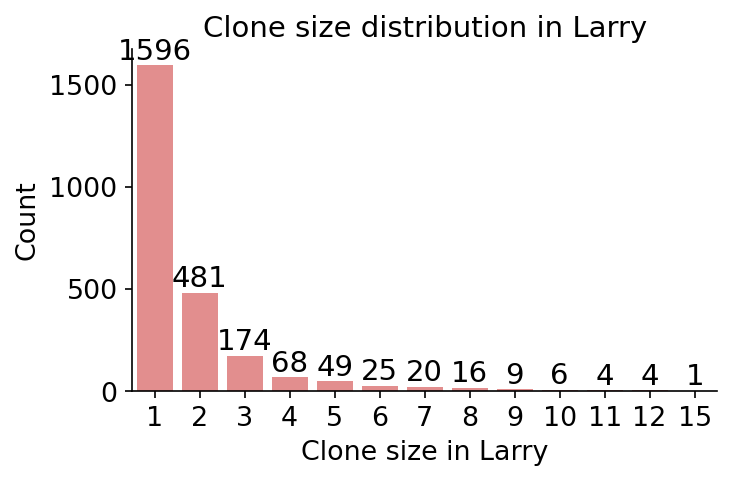

In [68]:
_l_clone_s_df = _larry_df.groupby(['clone']).size().reset_index(name='Size')
# _l_clone_s_df

tmp_df = _l_clone_s_df['Size'].value_counts().reset_index(name='Count')
tmp_df

fig, ax = plt.subplots(figsize=(5, 3))

p = sns.barplot(x='Size', y='Count', data=tmp_df, color='lightcoral', ax=ax)
p.set(title='Clone size distribution in Larry')
p.set(xlabel="Clone size in Larry")
p.set(ylabel='Count')

for i in p.containers:
    p.bar_label(i,)

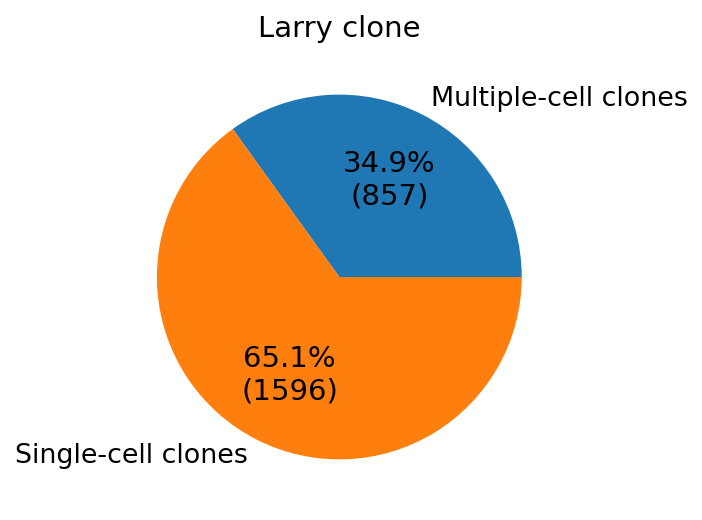

In [69]:
_t1, _t2 = tmp_df['Count'].sum() - tmp_df[tmp_df['Size'] == 1]['Count'].values[0], tmp_df[tmp_df['Size'] == 1]['Count'].values[0]
_tmp_p_tb = pd.DataFrame({'number': [_t1, _t2]},
                  index=['Multiple-cell clones', 'Single-cell clones'])

def autopct_format(values):
    def my_format(pct):
        total = values.sum().values[0]
        val = int(round(pct*total/100.0))
        return '{:.1f}%\n({v:d})'.format(pct, v=val)
    return my_format

# plt.pie(mydata,labels = mylabels, autopct=autopct_format(mydata))

fig, ax = plt.subplots( 
    nrows=1,
    ncols=1,
    figsize=(4, 4)
)
_tmp_p_tb.plot(kind='pie', y='number', autopct=autopct_format(_tmp_p_tb), ax=ax)
ax.set_title("Larry clone")
ax.set_ylabel('')
ax.get_legend().remove()

In [70]:
# _l_clone_s_df[_l_clone_s_df['Size'] >= 2].clone

In [71]:
t_larry_df = _larry_df[_larry_df['clone'].isin(_l_clone_s_df[_l_clone_s_df['Size'] >= 2].clone)]
t_larry_df.shape

(2667, 2)

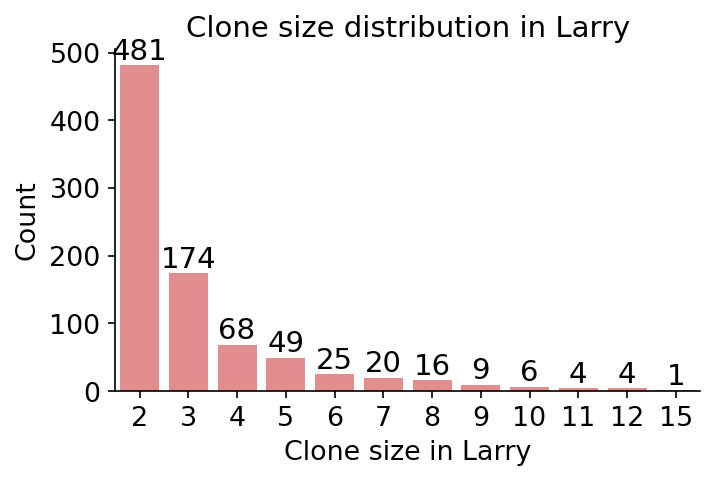

In [72]:
_l_clone_s_df = t_larry_df.groupby(['clone']).size().reset_index(name='Size')
# _l_clone_s_df

tmp_df = _l_clone_s_df['Size'].value_counts().reset_index(name='Count')
tmp_df

fig, ax = plt.subplots(figsize=(5, 3))

p = sns.barplot(x='Size', y='Count', data=tmp_df, color='lightcoral', ax=ax)
p.set(title='Clone size distribution in Larry')
p.set(xlabel="Clone size in Larry")
p.set(ylabel='Count')

for i in p.containers:
    p.bar_label(i,)

In [74]:
t_adata = adata[adata.obs_names.isin(t_larry_df.barcode)]

t_df_time = pd.DataFrame(data={'time_info': [1] * len(t_adata.obs_names)})
t_df_time.head()
adata_orig = cs.pp.initialize_adata_object(
    X_state=t_adata.layers['counts'],
    gene_names=t_adata.var_names,
    cell_names=t_adata.obs_names,
    time_info=t_df_time["time_info"],
    state_info=t_adata.obs['cell_type'],
    X_emb=t_adata.obsm['X_umap'],
    X_pca =t_adata.obsm['X_pca'],
    data_des="my_data",
)

Create new anndata object
Time points with clonal info: []


In [75]:
df1 = t_adata.obs['cell_type'].to_frame().reset_index().rename(columns={"index":"barcode"})
df2 = t_larry_df
_tar_df1 = pd.merge(df1, df2, how="inner", on="barcode").dropna()
_tar_df2 = _tar_df1.groupby("clone").agg({ "cell_type": lambda x: x.nunique(), "barcode": 'size'})
_l1_clone_size = len(_tar_df2.index)
_l1_clone_size_cell = _tar_df2.barcode.sum()
_l1_clone_ind_cellfate = len(_tar_df2[_tar_df2['cell_type'] <= 1].index)
_l1_clone_ind_cellfate_cell = _tar_df2[_tar_df2['cell_type'] <= 1].barcode.sum()
_l1_clone_size, _l1_clone_size_cell, _l1_clone_ind_cellfate, _l1_clone_ind_cellfate_cell

(857, 2667, 360, 840)

In [721]:
# cs.pp.get_highly_variable_genes(
#     adata_orig,
#     normalized_counts_per_cell=10000,
#     min_counts=3,
#     min_cells=3,
#     min_gene_vscore_pctl=90,
# )


In [76]:
cs.pp.get_X_clone(adata_orig, t_larry_df["barcode"], t_larry_df["clone"])

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2667/2667 [00:00<00:00, 924174.55it/s]

reorder clones


Text(0.5, 1.0, 'D4 dataset')

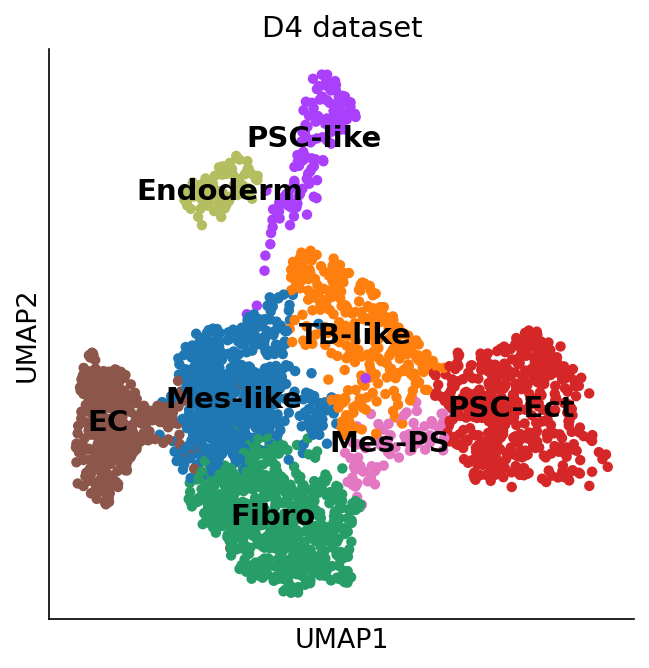

In [78]:
fig, ax = plt.subplots(figsize=(5, 5))
ax = sc.pl.embedding (adata_orig, basis="X_emb",  color="state_info", legend_loc="on data", show=False, ax=ax, size=100)
ax.set_xlabel('UMAP1')
ax.set_ylabel('UMAP2')
ax.set_title('D4 dataset')

Data saved at adata.uns['barcode_heatmap']


<Axes: title={'center': '857 clones'}>

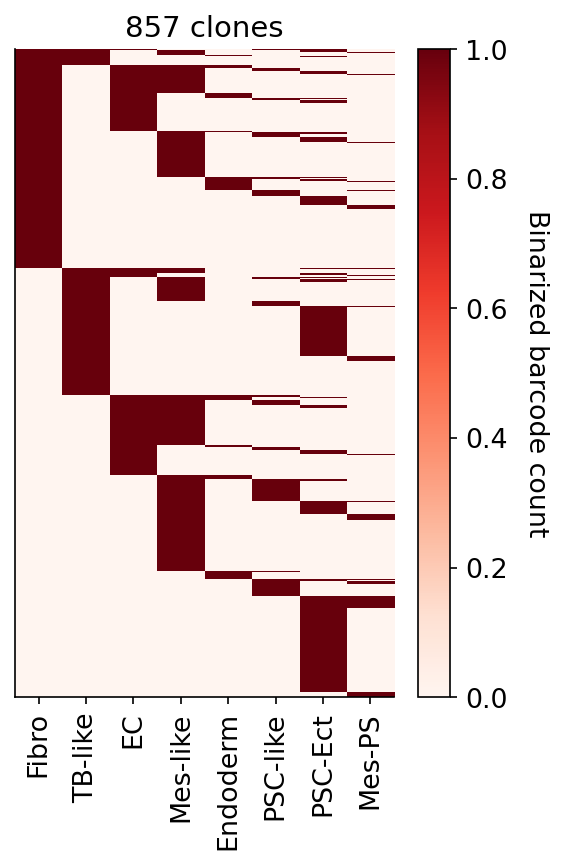

In [79]:
selected_times = None

cs.pl.barcode_heatmap(
    adata_orig,
    color_bar=True,
    log_transform=False,
    binarize=True,
)

(8, 360) (8, 497)
1e-10
[0 1 2 3 4 5 6 7]


Text(0.5, -12.833333333333318, 'Cell type')

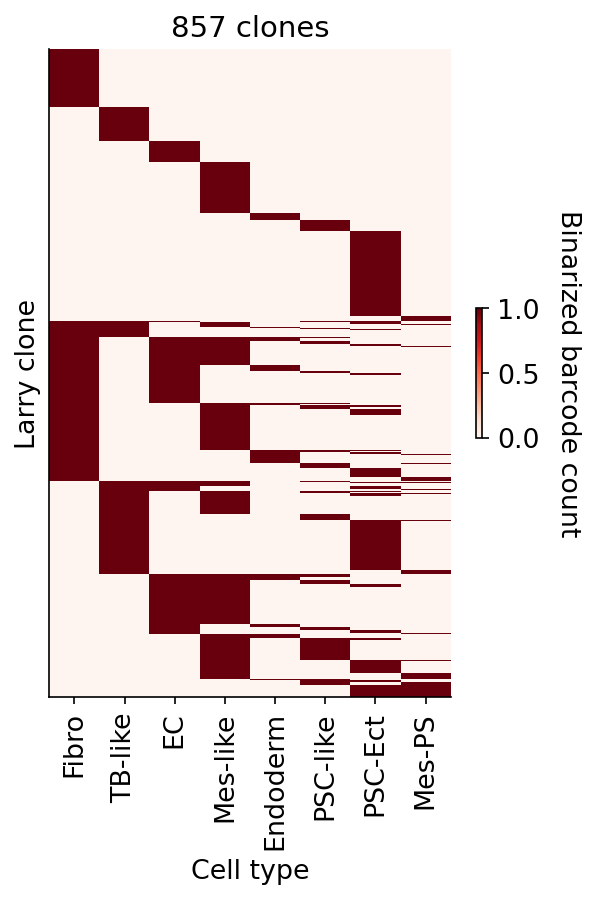

In [110]:
from cospar import tool as tl
from cospar.plotting import _utils as pl_util
from scipy.cluster import hierarchy
color_map_reds = pl_util.darken_cmap(plt.cm.Reds, scale_factor=0.9)
color_map_coolwarm = pl_util.darken_cmap(plt.cm.coolwarm, scale_factor=1)

def heatmap(
    data_matrix,
    order_map_x=True,
    order_map_y=True,
    x_ticks=None,
    y_ticks=None,
    x_tick_style=None,
    y_tick_style=None,
    col_range=[0, 99],
    color_bar_label="",
    log_transform=False,
    color_map=plt.cm.Reds,
    vmin=None,
    vmax=None,
    fig_width=4,
    fig_height=6,
    color_bar=True,
    x_label=None,
    y_label=None,
    x_label_style=None,
    y_label_style=None,
    print_ordered_labels=False,
    pseudo_count=10 ** (-10),
    ax=None,
    semi_triangular=False,
):
    """
    Plot ordered heat map of non-square data_matrix matrix

    Parameters
    ----------
    data_matrix: `np.array`
        The data matrix to be plotted
    order_map_x: `bool`
        Whether to re-order the x coordinate of the matrix or not
    order_map_y: `bool`
        Whether to re-order the y coordinate of the matrix or not
    x_ticks, y_ticks: `list`
        List of variable names for x and y ticks
    color_bar_label: `str`, optional (default: 'cov')
        Color bar label
    data_des: `str`, optional (default: '')
        String to distinguish different saved objects.
    log_transform: `bool`, optional (default: False)
        If true, perform a log transform. This is needed when the data
        matrix has entries varying by several order of magnitude.
    col_range: `tuple`, optional (default: None)
        The default setting is to plot the actual value of the vector.
        If col_range is set within [0,100], it will plot the percentile of the values,
        and the color_bar will show range [0,1]. This re-scaling is useful for
        visualizing gene expression.

    Returns
    ax,
    order_x,
        An integer index for ordered x axis
    order_y,
        An integer index for ordered y axis
    """

    from matplotlib.colors import Normalize as mpl_Normalize

    x_array = np.arange(data_matrix.shape[1])
    y_array = np.arange(data_matrix.shape[0])
    if order_map_x and (data_matrix.shape[1] > 2):
        if data_matrix.shape[0] != data_matrix.shape[1]:
            X = tl.get_normalized_covariance(data_matrix + pseudo_count, method="SW")
            Z = hierarchy.ward(X)
            order_x = hierarchy.leaves_list(hierarchy.optimal_leaf_ordering(Z, X))
        else:
            Z = hierarchy.ward(data_matrix + pseudo_count)
            order_x = hierarchy.leaves_list(
                hierarchy.optimal_leaf_ordering(Z, data_matrix + pseudo_count)
            )
    else:
        order_x = x_array
    print(x_array)

    if order_map_y and (data_matrix.shape[0] > 2):
        if data_matrix.shape[0] != data_matrix.shape[1]:
            order_y = hf.get_hierch_order(data_matrix + pseudo_count)
        else:
            Z = hierarchy.ward(data_matrix + pseudo_count)
            order_y = hierarchy.leaves_list(
                hierarchy.optimal_leaf_ordering(Z, data_matrix + pseudo_count)
            )
    else:
        order_y = y_array

    if log_transform:
        new_data = np.log(data_matrix[order_y][:, order_x] + 1) / np.log(10)
        label_ = " (log10)"
    else:
        new_data = data_matrix[order_y][:, order_x]
        label_ = ""

    col_data = new_data.flatten()
    if vmin is None:
        if col_range is None:
            vmin = np.min(col_data)
        else:
            vmin = np.percentile(col_data, col_range[0])

    if vmax is None:
        if col_range is None:
            vmax = np.max(col_data)
        else:
            vmax = np.percentile(col_data, col_range[1])
            if (vmax == 0) & (np.max(col_data) >= 1):
                vmax = 1
            if (vmax == 0) & (np.max(col_data) <= 1):
                vmax = np.max(col_data)

    if ax is None:
        fig, ax = plt.subplots()
        ax_ = None
    else:
        ax_ = ax

    if semi_triangular:
        upper_triangle_indices = np.triu_indices(new_data.shape[0])
        new_data[upper_triangle_indices] = np.nan

    ax.imshow(
        new_data,
        aspect="auto",
        cmap=color_map,
        vmin=vmin,
        vmax=vmax,
        interpolation="none",
    )

    if x_ticks is None:
        plt.xticks([])
    else:
        plt.xticks(
            x_array,
            np.array(x_ticks)[order_x],
            rotation=90,
            style=x_tick_style,
        )

        if print_ordered_labels:
            x_ticks_print = "','".join(np.array(x_ticks)[order_x])
            print(f"x_order: [{','.join(np.array(order_x).astype(str))}]")
            print(f"x_ticks: ['{x_ticks_print}']")

    if y_ticks is None:
        plt.yticks([])
    else:
        plt.yticks(
            y_array,
            np.array(y_ticks)[order_y],
            style=y_tick_style,
        )

        if print_ordered_labels:
            y_ticks_print = "','".join(np.array(y_ticks)[order_y])
            print(f"y_order: [{','.join(np.array(order_y).astype(str))}]")
            print(f"y_ticks: ['{y_ticks_print}']")

    if x_label is not None:
        ax.set_xlabel(x_label, style=x_label_style)

    if y_label is not None:
        ax.set_ylabel(y_label, style=y_label_style)

    if color_bar:
        norm = mpl_Normalize(vmin=vmin, vmax=vmax)
        cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=color_map), location='right', shrink=0.2)
        cbar.set_label(f"{color_bar_label}{label_}", rotation=270, labelpad=20)
    if ax_ is None:
        plt.gcf().set_size_inches((fig_width, fig_height))
    return ax

def fate_coupling(
    adata,
    source="transition_map",
    color_bar=True,
    rename_fates=None,
    color_map=color_map_reds,
    figure_index="",
    color_bar_label="Clonal coupling score",
    title=None,
    vmax=None,
    semi_triangular=False,
    **kwargs,
):
    """
    Plot fate coupling determined by the transition map.

    The results should be pre-computed from :func:`cospar.tl.fate_coupling`

    Parameters
    ----------
    adata: :class:`~anndata.AnnData` object
        Assume to contain transition maps at adata.uns.
    {source}
    {color_bar}
    {rename_fates}
    {color_map}
    {figure_index}

    Returns
    -------
    ax:
        The axis object of this plot.
    """

    fig_width = 4
    fig_height = 3.5
    fig_point_size = 2


    data_des = adata.uns["data_des"][-1]

    if color_bar:
        fig_width = fig_width + 0.5

    key_word = f"fate_coupling_{source}"
    # available_choices = hf.parse_output_choices(adata, key_word, where="uns")
    X_coupling = adata.uns[key_word]["X_coupling"]
    fate_names = adata.uns[key_word]["fate_names"]
    # rename_fates = hf.rename_list(fate_names, rename_fates)

    if "x_ticks" not in kwargs.keys():
        kwargs["x_ticks"] = rename_fates
    if "y_ticks" not in kwargs.keys():
        kwargs["y_ticks"] = rename_fates

    if vmax is None:
        # vmax = (
        #     np.percentile(X_coupling - np.diag(np.diag(X_coupling)), 95)
        #     + np.percentile(X_coupling - np.diag(np.diag(X_coupling)), 98)
        # ) / 2
        vmax = np.max(X_coupling - np.diag(np.diag(X_coupling)))

    ax = heatmap(
        X_coupling,
        color_bar_label=color_bar_label,
        color_bar=color_bar,
        fig_width=fig_width,
        fig_height=fig_height,
        color_map=color_map,
        vmax=vmax,
        semi_triangular=semi_triangular,
        **kwargs,
    )

    if title is None:
        ax.set_title(f"source: {source}")
    else:
        ax.set_title(title)

    if figure_index != "":
        figure_index == f"_{figure_index}"
    plt.tight_layout()

    return ax

def barcode_heatmap(
    adata,
    selected_times=None,
    selected_fates=None,
    color_bar=True,
    rename_fates=None,
    normalize=False,
    binarize=False,
    log_transform=False,
    fig_width=4,
    fig_height=6,
    figure_index="",
    plot=True,
    pseudocount=10 ** (-10),
    order_map_x=False,
    order_map_y=False,
    fate_normalize_source="X_clone",
    select_clones_with_fates: list = None,
    select_clones_without_fates: list = None,
    select_clones_mode: str = "or",
    **kwargs,
):
    data_des = adata.uns["data_des"][-1]
    data_des = f"{data_des}_clonal"

    coarse_X_clone, mega_cluster_list = tl.coarse_grain_clone_over_cell_clusters(
        adata,
        selected_times=selected_times,
        selected_fates=selected_fates,
        normalize=normalize,
        fate_normalize_source=fate_normalize_source,
        select_clones_with_fates=select_clones_with_fates,
        select_clones_without_fates=select_clones_without_fates,
        select_clones_mode=select_clones_mode,
        **kwargs,
    )
    if rename_fates is None:
        rename_fates = mega_cluster_list

    if len(rename_fates) != len(mega_cluster_list):
        rename_fates = mega_cluster_list

    if "x_ticks" not in kwargs.keys():
        kwargs["x_ticks"] = rename_fates

    coarse_X_clone_new = pl_util.custom_hierachical_ordering(
        np.arange(coarse_X_clone.shape[0]), coarse_X_clone
    )
    ind_ct_t = coarse_X_clone_new[:, (coarse_X_clone_new > 0).sum(0) <= 1]
    # print(ind_ct_t.shape)
    mul_ct_t = coarse_X_clone_new[:, (coarse_X_clone_new > 0).sum(0) > 1]
    print(ind_ct_t.shape, mul_ct_t.shape)
    coarse_X_clone_new = np.concatenate((ind_ct_t, mul_ct_t), axis=1)
    adata.uns["barcode_heatmap"] = {
        "coarse_X_clone": coarse_X_clone,
        "fate_names": rename_fates,
    }
    if plot:
        if binarize:
            final_matrix = coarse_X_clone_new > 0
            color_bar_label = "Binarized barcode count"
        else:
            final_matrix = coarse_X_clone_new
            color_bar_label = "Barcode count"

        if normalize:
            color_bar_label += " (normalized)"

        clone_idx = final_matrix.sum(0) > 0
        print(pseudocount)
        ax = heatmap(
            final_matrix[:, clone_idx].T + pseudocount,
            order_map_x=order_map_x,
            order_map_y=order_map_y,
            color_bar_label=color_bar_label,
            log_transform=log_transform,
            fig_width=fig_width,
            
            fig_height=fig_height,
            color_bar=color_bar,
            **kwargs,
        )
        plt.title(f"{np.sum(clone_idx)} clones")

        # bands = np.array([0, ind_ct_t.shape[1], coarse_X_clone_new.shape[1]])
        # print(bands)
        # bnames = ['H3K4me3', 'H3K9me3']
        # for y, h, bn in zip(bands, np.diff(bands), bnames):
        #     cb = CurlyBrace([990, y+h*0.025], 30, h*.95)
        #     ax.add_patch(cb)
        #     ax.text(1030, y+h/2, bn, va='center')

    

        plt.tight_layout()
        if figure_index != "":
            figure_index == f"_{figure_index}"
    
        return ax

ax = barcode_heatmap(
    adata_orig,
    color_bar=True,
    log_transform=False,
    binarize=True,
)
ax.set_ylabel('Larry clone')
ax.set_xlabel('Cell type')


normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
Results saved as dictionary at adata.uns['fate_coupling_X_clone']
x_order: [0,1,2,3,4,5,6,7]
x_ticks: ['Fibro','TB-like','EC','Mes-like','Endoderm','PSC-like','PSC-Ect','Mes-PS']
y_order: [0,1,2,3,4,5,6,7]
y_ticks: ['Fibro','TB-like','EC','Mes-like','Endoderm','PSC-like','PSC-Ect','Mes-PS']


Text(0.5, 1.0, 'Fate coupling score based on LARRY clone')

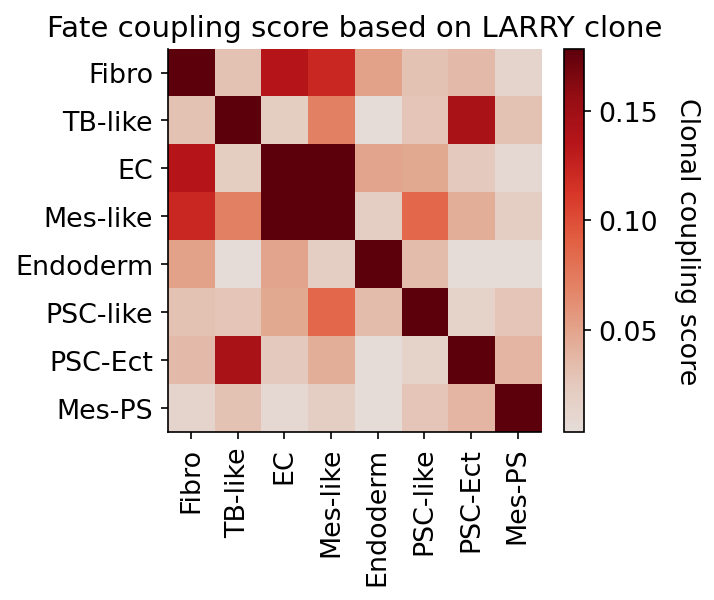

In [113]:
cs.tl.fate_coupling(
    adata_orig, source="X_clone"
)  # compute the fate coupling

fig, ax = plt.subplots(figsize=(5, 4))
cs.pl.fate_coupling(adata_orig, source="X_clone", ax=ax, order_map_x=False, order_map_y=False, print_ordered_labels=True)  # actually plot the coupling
# heatmap(adata_orig.uns["fate_coupling_X_clone"]["X_coupling"], ax=ax, order_map_x=True, order_map_y=True, print_ordered_labels=True)  # actually plot the coupling
ax.set_title('Fate coupling score based on LARRY clone')

normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
Results saved as dictionary at adata.uns['fate_coupling_X_clone']


Text(0.5, 1.0, 'Fate coupling score based on LARRY clone')

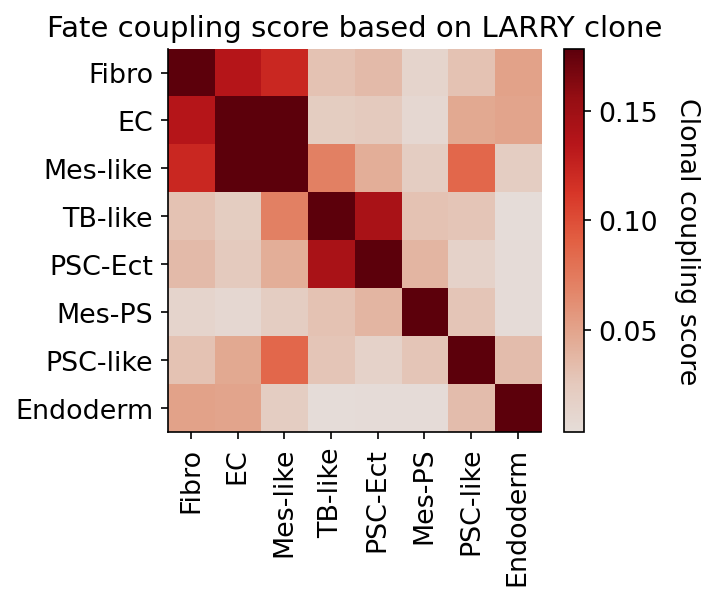

In [114]:
cs.tl.fate_coupling(
    adata_orig, source="X_clone"
)  # compute the fate coupling

fig, ax = plt.subplots(figsize=(5, 4))
cs.pl.fate_coupling(adata_orig, source="X_clone", ax=ax)  # actually plot the coupling
ax.set_title('Fate coupling score based on LARRY clone')

In [115]:
cs.tl.fate_hierarchy(
    adata_orig, source="X_clone"
)  # compute the fate hierarchy
cs.pl.fate_hierarchy(adata_orig, source="X_clone")  # actually plot the hierarchy

normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
Results saved as dictionary at adata.uns['fate_hierarchy_X_clone']

         /-PSC-like
      /-|
     |   \-Endoderm
     |
   /-|      /-PSC-Ect
  |  |   /-|
  |  |  |   \-TB-like
  |   \-|
  |     |      /-Mes-like
--|     |   /-|
  |      \-|   \-EC
  |        |
  |         \-Fibro
  |
   \-Mes-PS


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 857/857 [00:01<00:00, 498.75it/s]


Data saved at adata.uns['clonal_fate_bias']


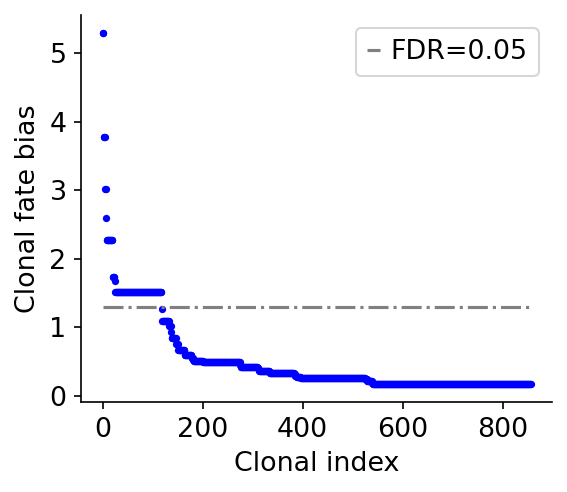

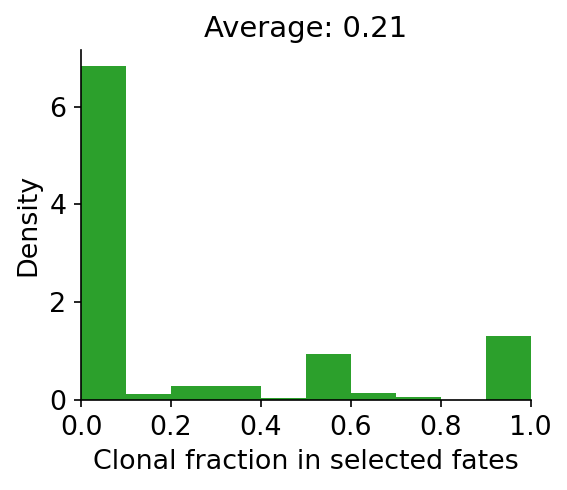

In [116]:
cs.tl.clonal_fate_bias(
    # adata_orig, selected_fate="mes-like", alternative="two-sided"
    adata_orig, selected_fate="PSC-Ect", alternative="two-sided"
)  # compute the fate hierarchy
cs.pl.clonal_fate_bias(adata_orig)  # actually plot the hierarchy

In [118]:
result = adata_orig.uns["clonal_fate_bias"]
result.head()

,clone_id,clone_size,P_value,clonal_fraction_in_target_fate,Fate_bias
236,236,7.0,0.000005,1.0,5.300065
234,234,7.0,0.000005,1.0,5.300065
703,703,5.0,0.000165,1.0,3.781911
259,259,5.0,0.000165,1.0,3.781911
160,160,5.0,0.000165,1.0,3.781911


In [119]:
from cospar import settings
from cospar import help_functions as hf
from matplotlib import pyplot as plt
from cospar.plotting import _utils as pl_util
import os
import numpy as np
# settings.fig_width

<Axes: title={'center': 'ID: 757'}, xlabel='x', ylabel='y'>

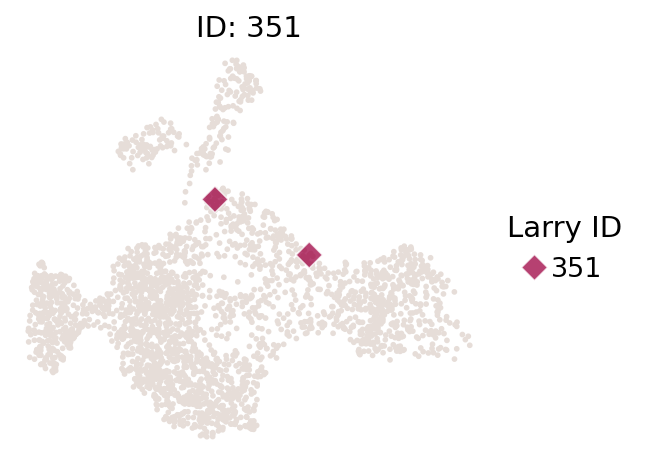

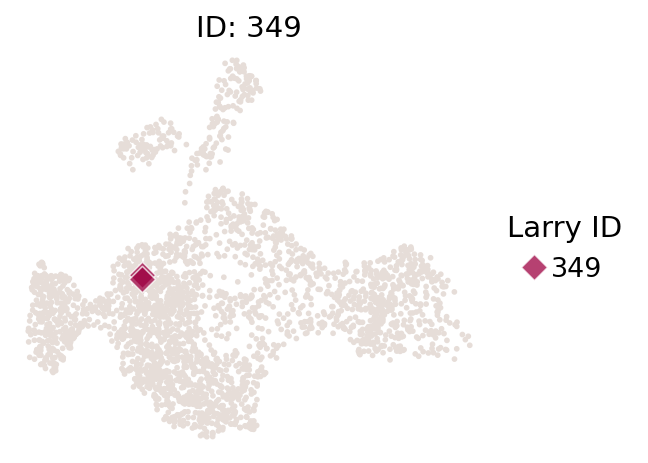

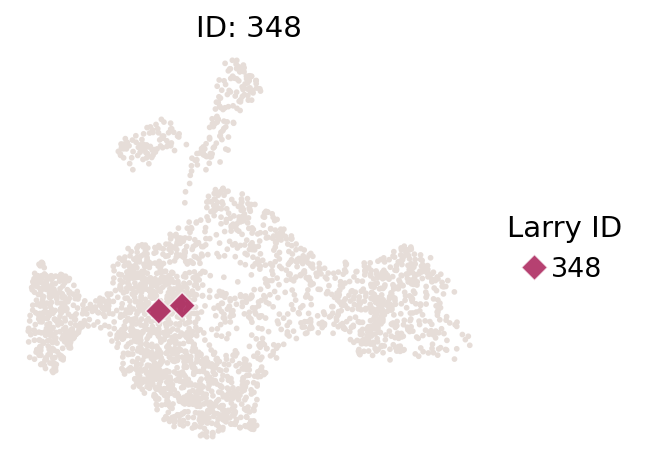

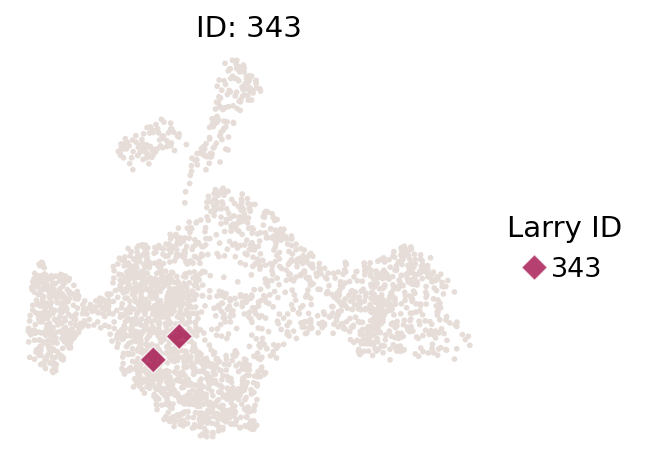

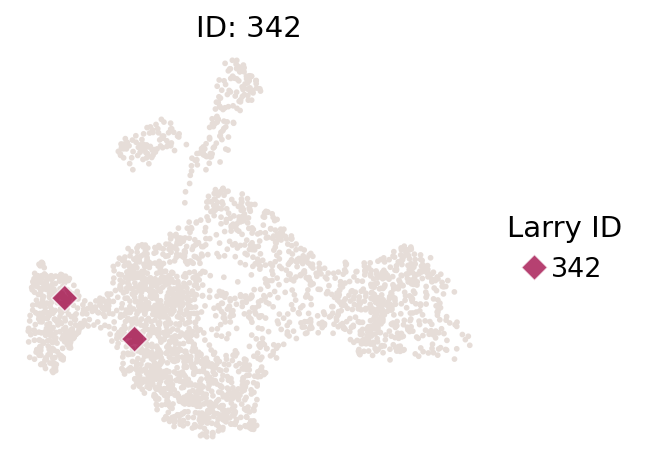

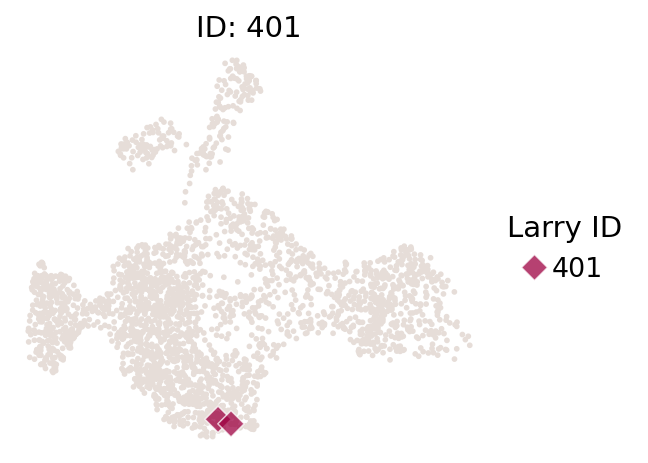

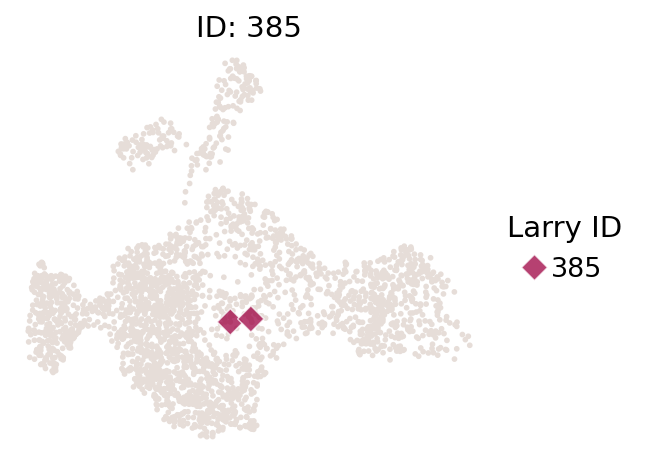

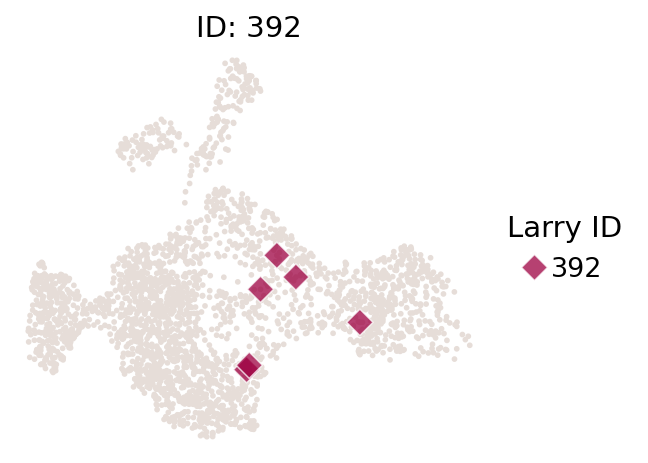

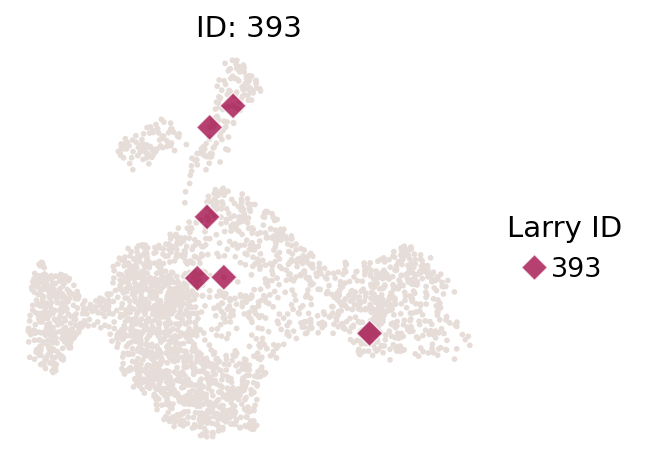

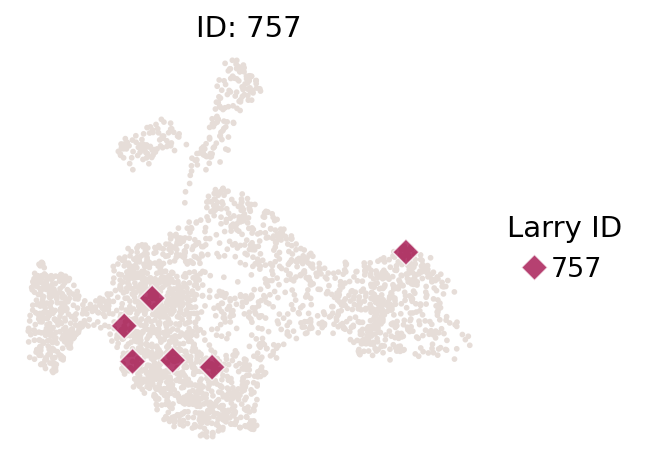

In [124]:

def clones_on_manifold(
    adata,
    selected_clone_list=[0],
    color_list=["red", "blue", "purple", "green", "cyan", "black"],
    selected_annotation_key="time_info",
    selected_annotation_info=None,
    title=None,
    clone_markersize=12,
    clone_markeredgewidth=1,
    markeredgecolor="black",
    **kwargs,
):
    """
    Plot clones on top of state embedding.

    Parameters
    ----------
    adata: :class:`~anndata.AnnData` object
    selected_clone_list: `list`
        List of selected clone ID's.
    color_list: `list`, optional (default: ['red','blue','purple','green','cyan','black'])
        The list of color that defines color at respective time points.
    selected_annotation_info: `list`, optional (default: all)
        Select time points to show corresponding states. If set to be [], use all states.
    title: None
        Default, show the clone id as panel title. Otherwise, show the text string from input 'title'
    clone_markersize: `int`, optional (default: 12)
        Clone marker size
    clone_markeredgewidth: `int`, optional (default: 1)
        Edige size for clone marker
    """

    fig_width = settings.fig_width
    fig_height = settings.fig_height
    point_size = settings.fig_point_size
    x_emb = adata.obsm["X_emb"][:, 0]
    y_emb = adata.obsm["X_emb"][:, 1]
    data_des = adata.uns["data_des"][-1]
    # data_path=settings.data_path
    figure_path = settings.figure_path
    X_clone = adata.obsm["X_clone"]
    time_info = np.array(adata.obs[selected_annotation_key])

    # use only valid time points
    sp_idx = hf.selecting_cells_by_time_points(time_info, selected_annotation_info)
    selected_annotation_info = np.sort(list(set(time_info[sp_idx])))

    selected_clone_list = np.array(selected_clone_list)
    full_id_list = np.arange(X_clone.shape[1])
    valid_idx = np.in1d(full_id_list, selected_clone_list)
    if np.sum(valid_idx) < len(selected_clone_list):
        logg.error(
            f"Valid id range is (0,{X_clone.shape[1]-1}). Please use a smaller ID!"
        )
        selected_clone_list = full_id_list[valid_idx]

    if len(selected_clone_list) == 0:
        logg.error("No valid states selected.")
    else:
        # using all data
        for my_id in selected_clone_list:
            fig = plt.figure(figsize=(fig_width, fig_height))
            ax = plt.subplot(1, 1, 1)
            idx_t = np.zeros(len(time_info), dtype=bool)
            for j, xx in enumerate(selected_annotation_info):
                idx_t0 = time_info == selected_annotation_info[j]
                idx_t = idx_t0 | idx_t

            pl_util.customized_embedding(
                x_emb[idx_t],
                y_emb[idx_t],
                np.zeros(len(y_emb[idx_t])),
                ax=ax,
                point_size=point_size,
            )
            for j, xx in enumerate(selected_annotation_info):
                idx_t = time_info == selected_annotation_info[j]
                idx_clone = X_clone[:, my_id].toarray().flatten() > 0
                # idx = idx_t & idx_clone
                idx = idx_clone

                tmp_d = pd.DataFrame(data={'x':x_emb[idx], 'y':y_emb[idx]})
                tmp_d['Larry ID'] = my_id
                # print(tmp_d)
                # sns.scatterplot(data=tmp_d, x='x', y='y', hue='Larry ID', palette= sns.color_palette("Spectral", as_cmap=True), ax=ax)
                sns.scatterplot(data=tmp_d, x='x', y='y', style='Larry ID', hue='Larry ID', palette= sns.color_palette("Spectral", as_cmap=True), s=80,alpha=0.75, 
                                ax=ax, markers={my_id:'D'})

                
                ax.spines[['top', 'right']].set_visible(False)
                sns.move_legend(ax, bbox_to_anchor=(1, 0.5), loc='center left', frameon=False)

                # ax.plot(
                #     x_emb[idx],
                #     y_emb[idx],
                #     ".",
                #     color=color_list[j % len(color_list)],
                #     label="Larry clone: %s" % (my_id),
                #     markersize=clone_markersize,
                #     markeredgecolor=markeredgecolor,
                #     markeredgewidth=clone_markeredgewidth,
                #     **kwargs,
                # )


                # ax.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
                if title is None:
                    ax.set_title(f"ID: {my_id}")
                else:
                    ax.set_title(title)

            fig.savefig(
                os.path.join(
                    figure_path,
                    f"{data_des}_different_clones_{my_id}.{settings.file_format_figs}",
                )
            )
    return ax


# ids = result["clone_id"][:5]
ids = result["clone_id"][-10:]

clones_on_manifold(
    adata_orig,
    selected_clone_list=ids,
    color_list=["red", "blue", "black"],
    clone_markersize=15,
)

<Axes: title={'center': 'ID: 17'}, xlabel='x', ylabel='y'>

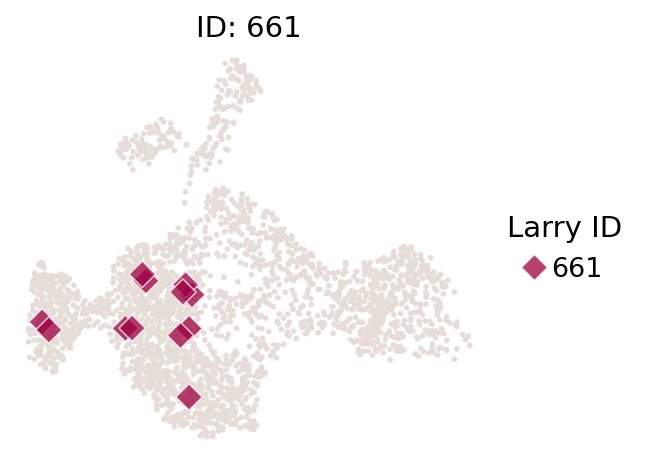

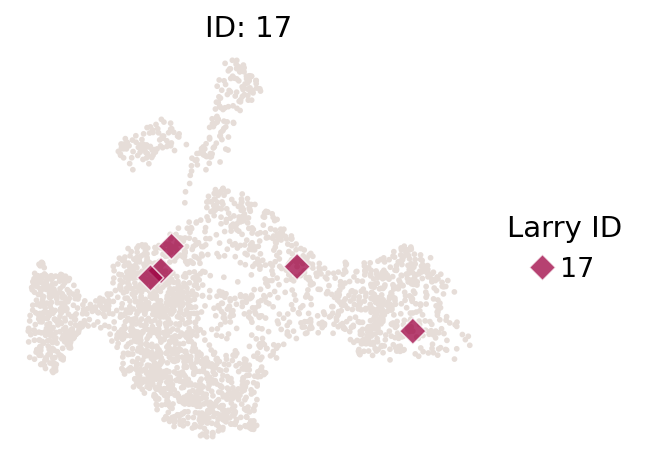

In [125]:
ids = [661, 17]

clones_on_manifold(
    adata_orig,
    selected_clone_list=ids,
    color_list=["red", "blue", "black"],
    clone_markersize=15,
)

In [126]:
l_b = pd.DataFrame(data={"barcode":adata_orig.obs_names})
adata_orig.uns['maester_info'] = pd.merge(l_b, tmp_merge_o, how='left', on='barcode')

351
349
348
343
342
401
385
392
393
757


<Axes: title={'center': 'ID: 757'}, xlabel='x', ylabel='y'>

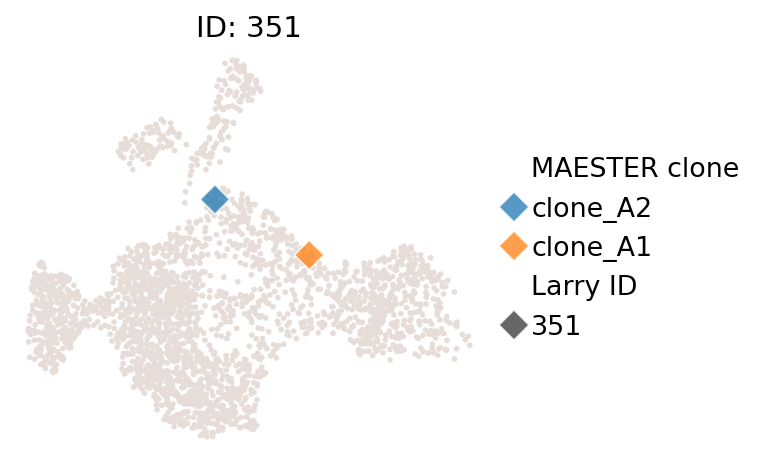

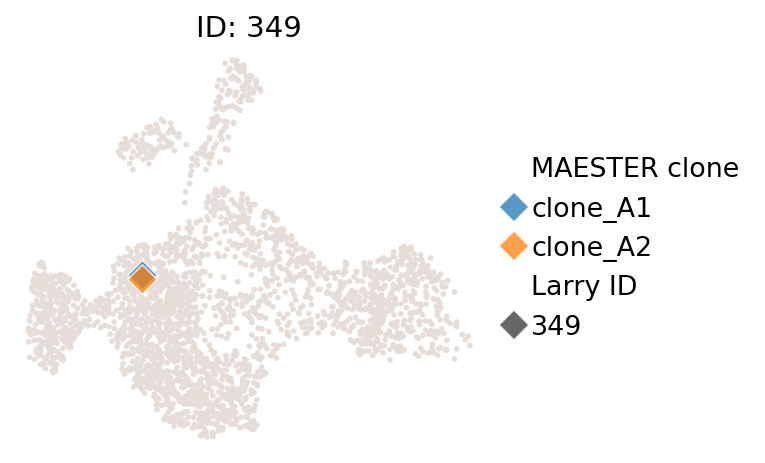

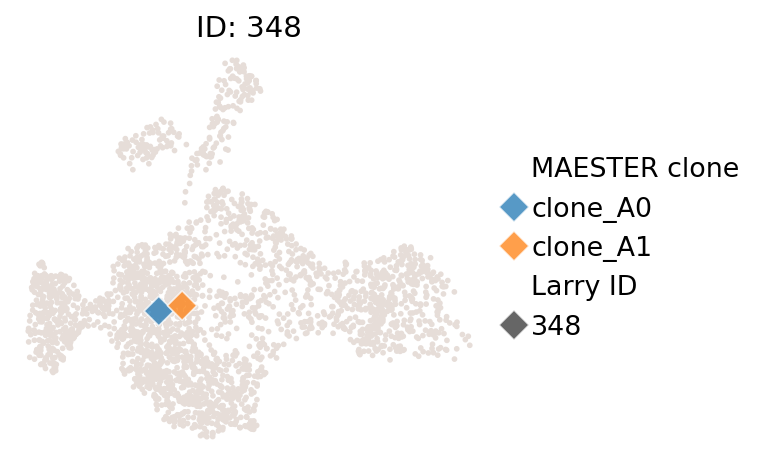

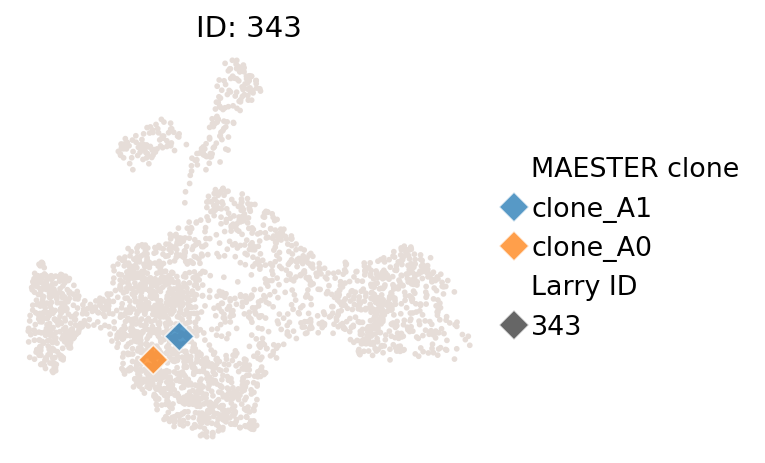

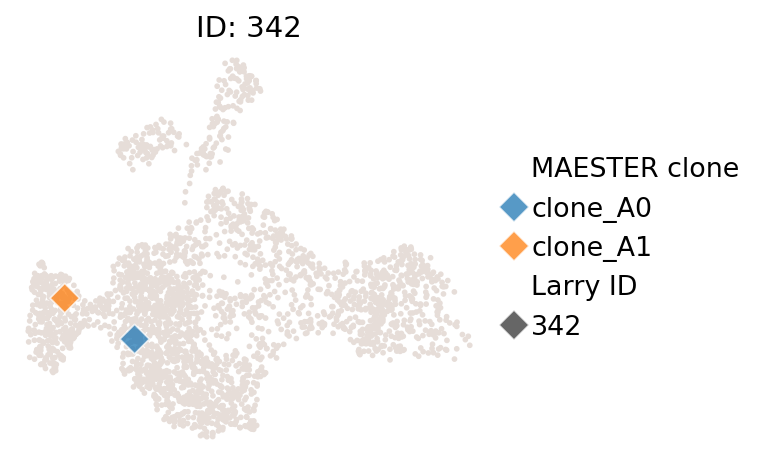

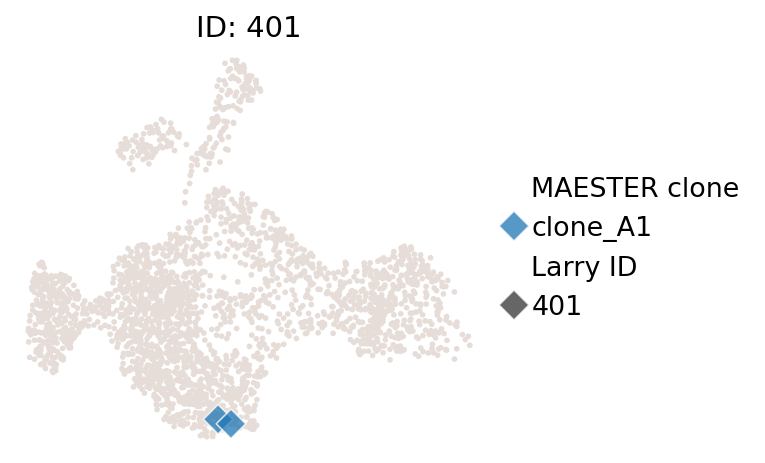

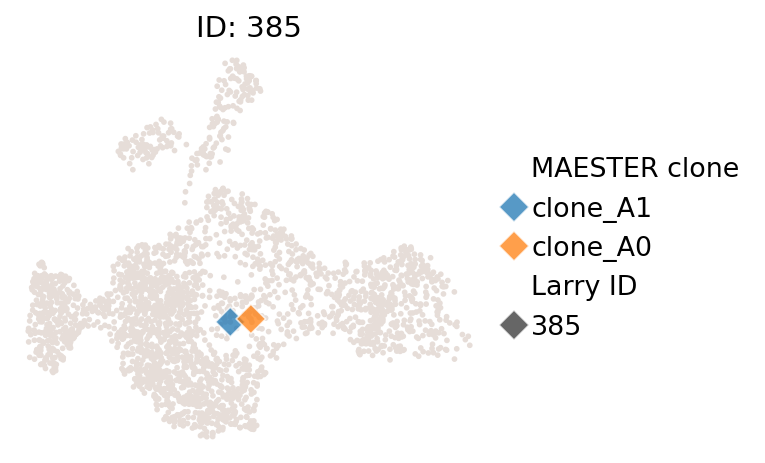

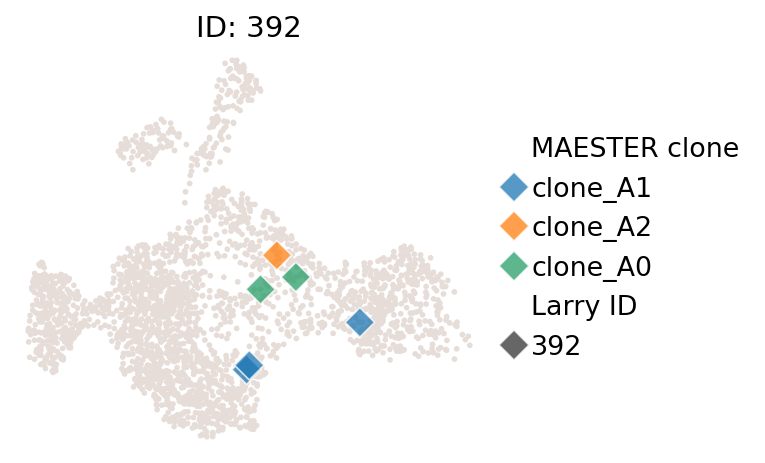

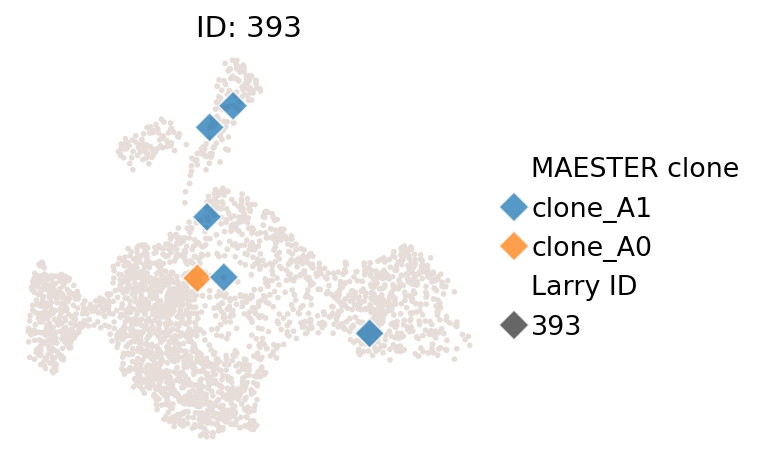

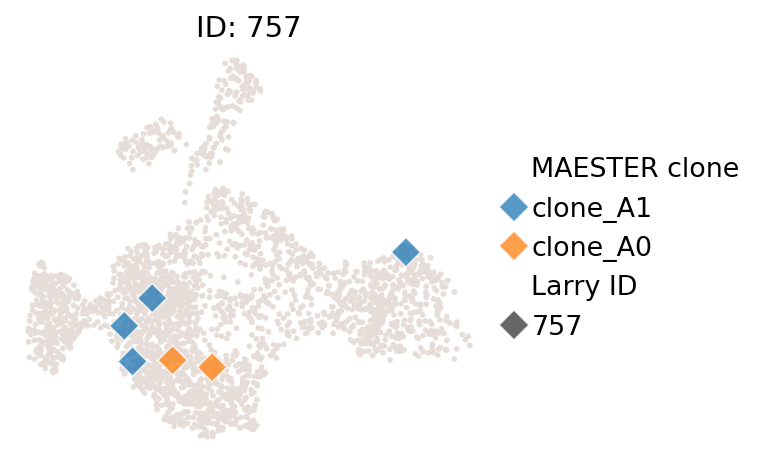

In [127]:
from matplotlib.patches import Patch

def clones_on_manifold(
    adata,
    selected_clone_list=[0],
    color_list=["red", "blue", "purple", "green", "cyan", "black"],
    selected_annotation_key="time_info",
    selected_annotation_info=None,
    title=None,
    clone_markersize=12,
    clone_markeredgewidth=1,
    markeredgecolor="black",
    **kwargs,
):
    """
    Plot clones on top of state embedding.

    Parameters
    ----------
    adata: :class:`~anndata.AnnData` object
    selected_clone_list: `list`
        List of selected clone ID's.
    color_list: `list`, optional (default: ['red','blue','purple','green','cyan','black'])
        The list of color that defines color at respective time points.
    selected_annotation_info: `list`, optional (default: all)
        Select time points to show corresponding states. If set to be [], use all states.
    title: None
        Default, show the clone id as panel title. Otherwise, show the text string from input 'title'
    clone_markersize: `int`, optional (default: 12)
        Clone marker size
    clone_markeredgewidth: `int`, optional (default: 1)
        Edige size for clone marker
    """

    fig_width = settings.fig_width
    fig_height = settings.fig_height
    point_size = settings.fig_point_size
    x_emb = adata.obsm["X_emb"][:, 0]
    y_emb = adata.obsm["X_emb"][:, 1]
    data_des = adata.uns["data_des"][-1]
    # data_path=settings.data_path
    figure_path = settings.figure_path
    X_clone = adata.obsm["X_clone"]
    time_info = np.array(adata.obs[selected_annotation_key])

    # use only valid time points
    sp_idx = hf.selecting_cells_by_time_points(time_info, selected_annotation_info)
    selected_annotation_info = np.sort(list(set(time_info[sp_idx])))

    selected_clone_list = np.array(selected_clone_list)
    full_id_list = np.arange(X_clone.shape[1])
    valid_idx = np.in1d(full_id_list, selected_clone_list)
    if np.sum(valid_idx) < len(selected_clone_list):
        logg.error(
            f"Valid id range is (0,{X_clone.shape[1]-1}). Please use a smaller ID!"
        )
        selected_clone_list = full_id_list[valid_idx]

    if len(selected_clone_list) == 0:
        logg.error("No valid states selected.")
    else:
        # using all data
        for my_id in selected_clone_list:
            fig = plt.figure(figsize=(fig_width, fig_height))
            ax = plt.subplot(1, 1, 1)
            idx_t = np.zeros(len(time_info), dtype=bool)
            for j, xx in enumerate(selected_annotation_info):
                idx_t0 = time_info == selected_annotation_info[j]
                idx_t = idx_t0 | idx_t

            pl_util.customized_embedding(
                x_emb[idx_t],
                y_emb[idx_t],
                np.zeros(len(y_emb[idx_t])),
                ax=ax,
                point_size=point_size,
            )
            for j, xx in enumerate(selected_annotation_info):
                idx_t = time_info == selected_annotation_info[j]
                idx_clone = X_clone[:, my_id].toarray().flatten() > 0
                # idx = idx_t & idx_clone
                idx = idx_clone
                print(my_id)
                tar_m_col = 'clone'
                tmp_d = pd.DataFrame(data={'x':x_emb[idx], 'y':y_emb[idx], 'MAESTER %s' % (tar_m_col):adata_orig.uns['maester_info'].loc[idx_clone, tar_m_col]})
                tmp_d['Larry ID'] = my_id
                # print(tmp_d)
                # print(tmp_d)
                # oi = sorted(tmp_d['MAESTER %s' % (tar_m_col)].unique().tolist(), key = lambda x : int(x[-1])),  
                sns.scatterplot(data=tmp_d, x='x', y='y', style='Larry ID', hue='MAESTER %s' % (tar_m_col), s=100,alpha=0.75, 
                                ax=ax, markers={my_id:'D'})

                ax.spines[['top', 'right']].set_visible(False)
                sns.move_legend(ax, bbox_to_anchor=(1, 0.5), loc='center left', frameon=False)

                # ax.plot(
                #     x_emb[idx],
                #     y_emb[idx],
                #     ".",
                #     color=color_list[j % len(color_list)],
                #     label="Larry clone: %s" % (my_id),
                #     markersize=clone_markersize,
                #     markeredgecolor=markeredgecolor,
                #     markeredgewidth=clone_markeredgewidth,
                #     **kwargs,
                # )


                # ax.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
                if title is None:
                    ax.set_title(f"ID: {my_id}")
                else:
                    ax.set_title(title)

            fig.savefig(
                os.path.join(
                    figure_path,
                    f"{data_des}_different_clones_{my_id}.{settings.file_format_figs}",
                )
            )
    return ax

l_b = pd.DataFrame(data={"barcode":adata_orig.obs_names})
adata_orig.uns['maester_info'] = pd.merge(l_b, tmp_merge_o, how='left', on='barcode')

# ids = result["clone_id"][:5]
ids = result["clone_id"][-10:]

clones_on_manifold(
    adata_orig,
    selected_clone_list=ids,
    color_list=["red", "blue", "black"],
    clone_markersize=15,
)

661
17


<Axes: title={'center': 'ID: 17'}, xlabel='x', ylabel='y'>

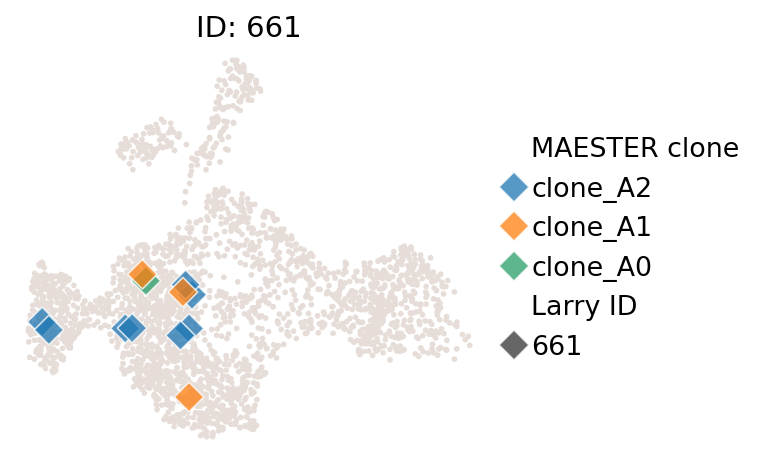

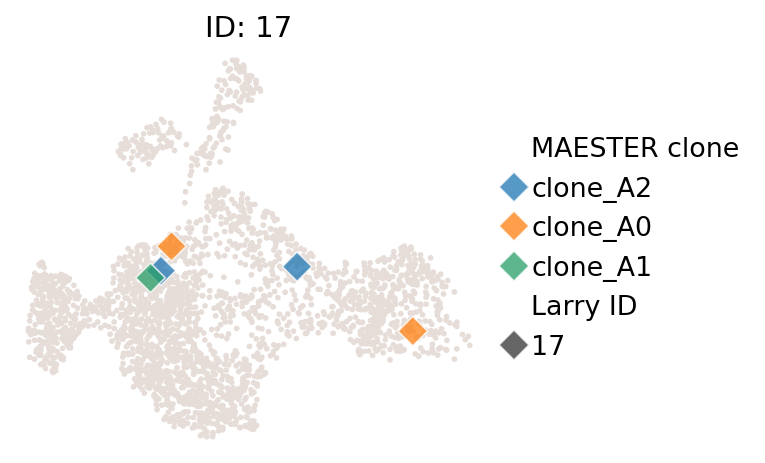

In [128]:
clones_on_manifold(
    adata_orig,
    selected_clone_list=[661, 17],
    color_list=["red", "blue", "black"],
    clone_markersize=15,
)

# 3-1 Larry cells cell fate analysis

In [129]:
# optional checking RNA volocity
import scvelo as scv
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.presenter_view = True  # set max width size for presenter view
scv.set_figure_params('scvelo')  # for beautified visualization


_loom_f = "/autofs/bal31/jhsu/home/projects/sc/data/hemo_paper_larry/larry-maester-d4/sc/2_bam/velocyto/2_bam.loom"
ldata = sc.read(_loom_f, cache=True)
# adata = scv.utils.merge(_adata, ldata)

In [131]:
_adata_orig = adata_orig
vadata = scv.utils.merge(_adata_orig, ldata)
scv.pp.filter_and_normalize(vadata, log=False)
scv.pp.moments(vadata)

Normalized count data: X, spliced, unspliced.
computing neighbors


/tmp/ipykernel_906731/2385636115.py:4: DeprecationWarning: Automatic neighbor calculation is deprecated since scvelo==0.4.0 and will be removed in a future version of scVelo. Please compute neighbors first with Scanpy.
  scv.pp.moments(vadata)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scvelo/preprocessing/moments.py:71: DeprecationWarning: `neighbors` is deprecated since scvelo==0.4.0 and will be removed in a future version of scVelo. Please compute neighbors with Scanpy.
  neighbors(


    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:09) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


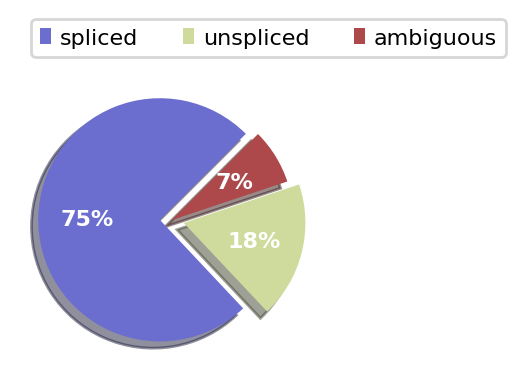

In [132]:
scv.pl.proportions(vadata)

In [133]:
scv.tl.velocity(vadata, mode='stochastic')
scv.tl.velocity_graph(vadata)

computing velocities


/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scvelo/tools/optimization.py:184: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  gamma[i] = np.linalg.pinv(A.T.dot(A)).dot(A.T.dot(y[:, i]))


    finished (0:00:10) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/48 cores)


  0%|          | 0/2667 [00:00<?, ?cells/s]

/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/multiprocessing/popen_fork.py:66: DeprecationWarning: This process (pid=906731) is multi-threaded, use of fork() may lead to deadlocks in the child.
  self.pid = os.fork()


    finished (0:00:37) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_emb', embedded velocity vectors (adata.obsm)


/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/autofs/ba

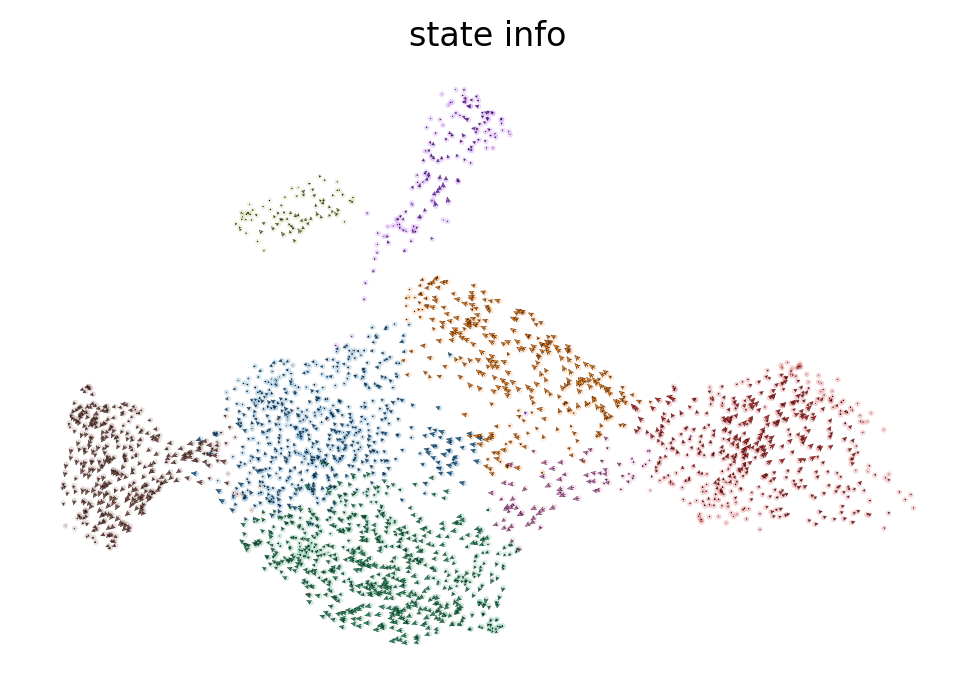

In [134]:
scv.pl.velocity_embedding(vadata, basis='X_emb', color="state_info")

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

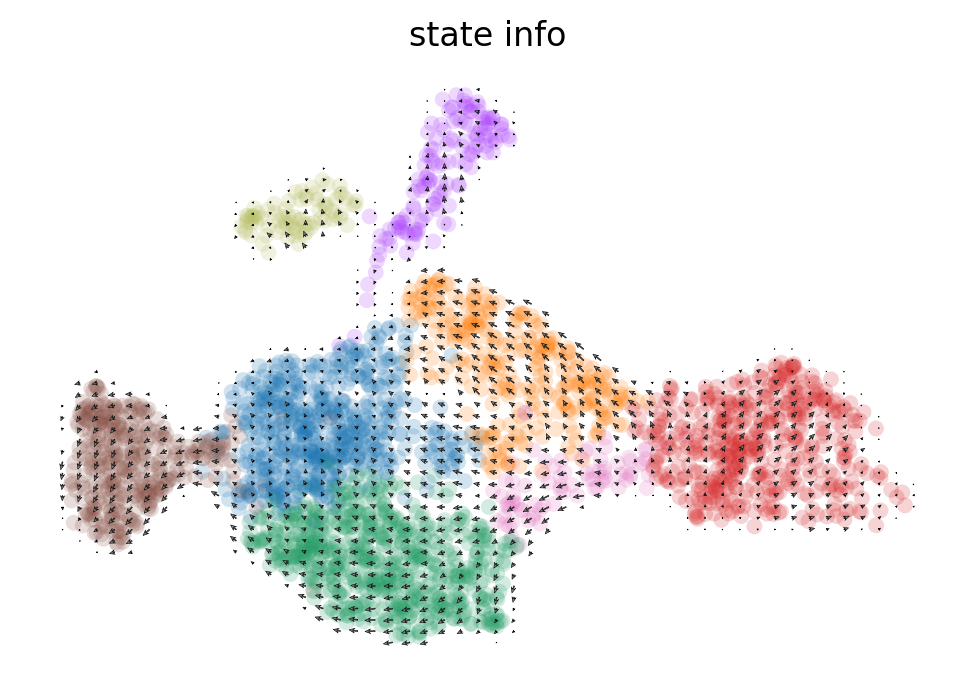

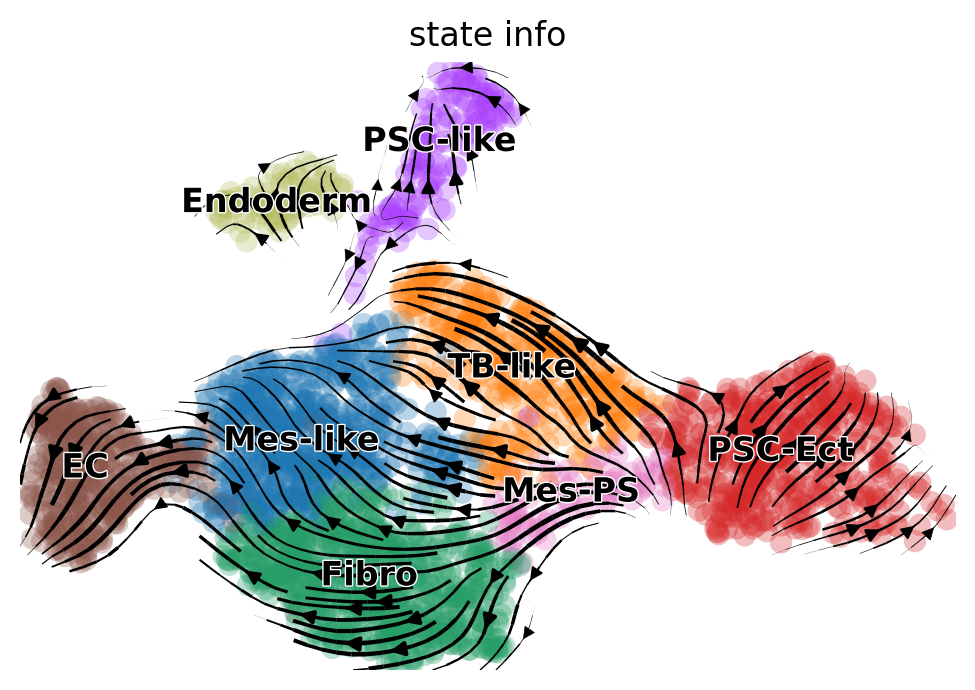

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)


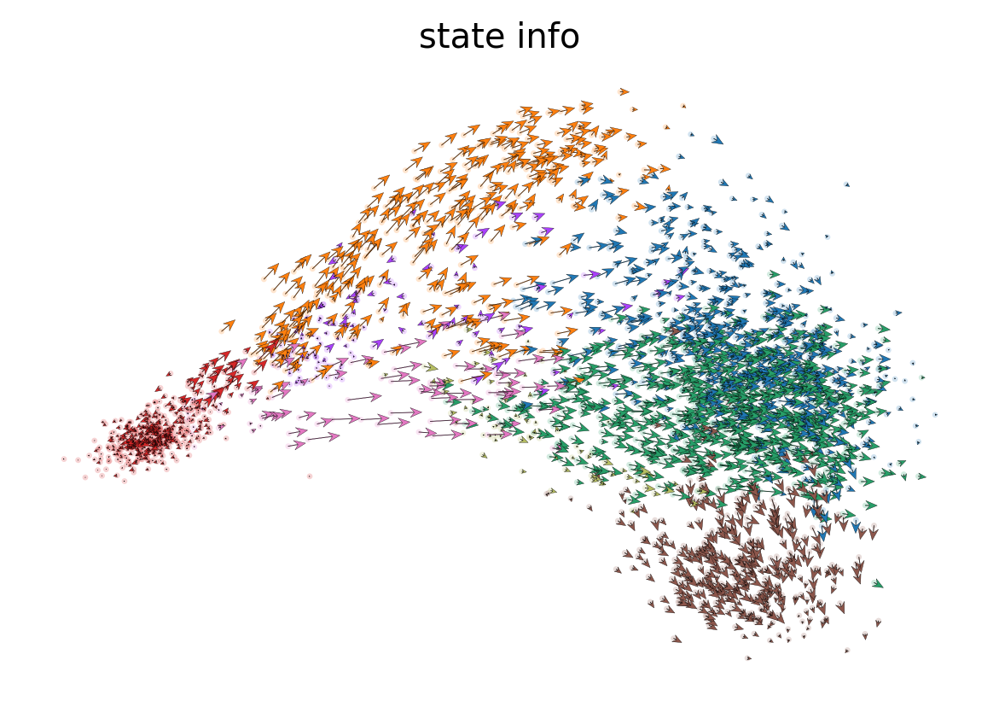

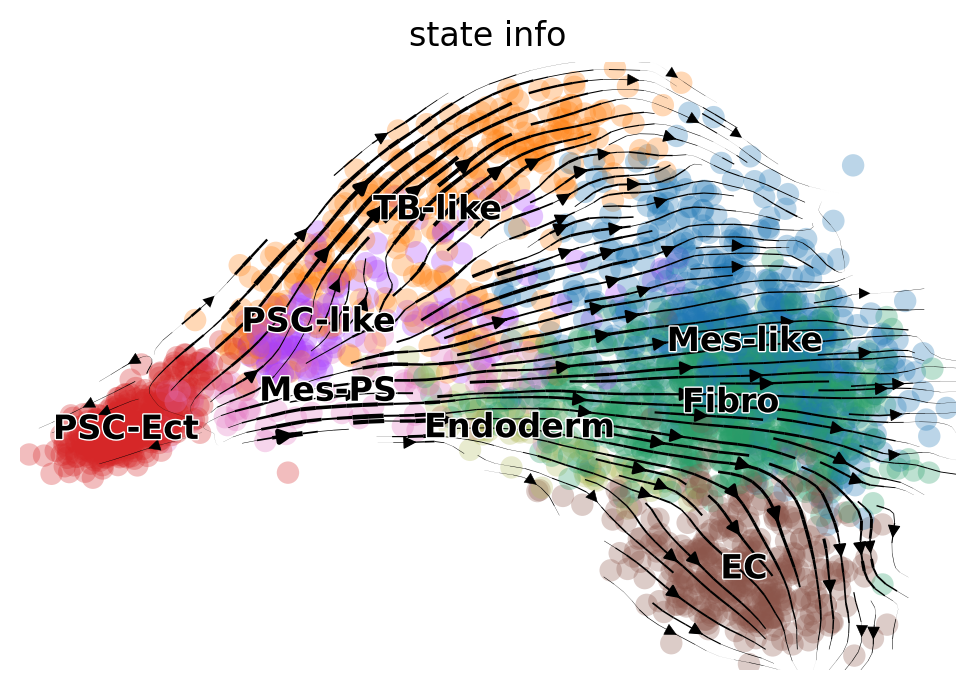

computing terminal states
    identified 2 regions of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


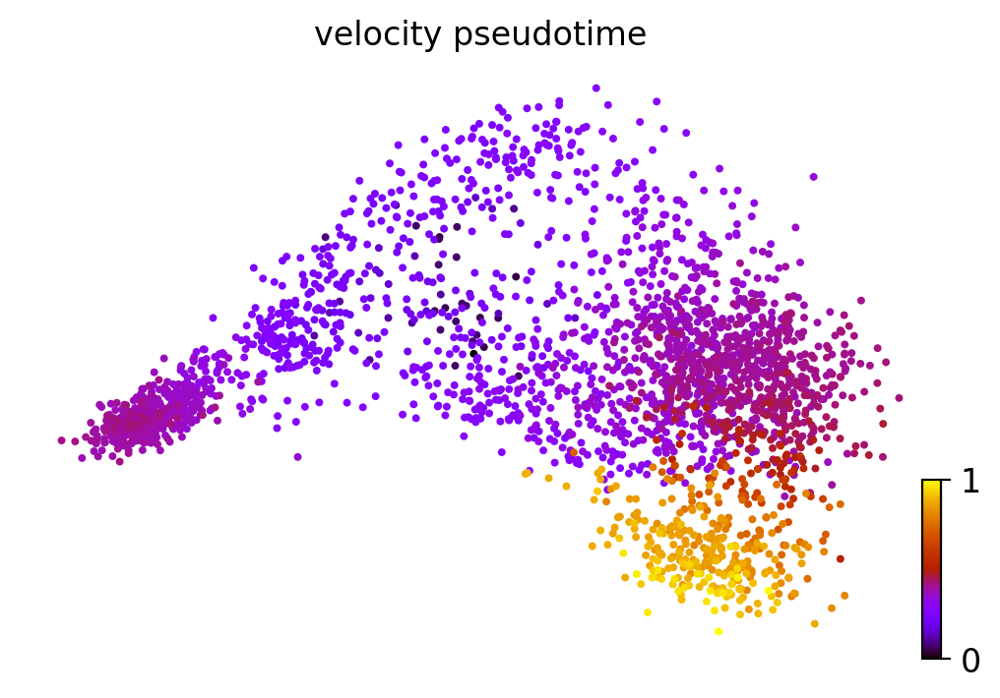

In [135]:
scv.pl.velocity_embedding_grid(vadata, basis='X_emb', color="state_info")
scv.pl.velocity_embedding_stream(vadata, basis='X_emb', color="state_info")
scv.pl.velocity_embedding(vadata, arrow_length=3, arrow_size=2, dpi=120, basis='pca', color="state_info")
scv.pl.velocity_embedding_stream(vadata, basis='pca', color="state_info")
scv.tl.velocity_pseudotime(vadata)
scv.pl.scatter(vadata, color='velocity_pseudotime', cmap='gnuplot')

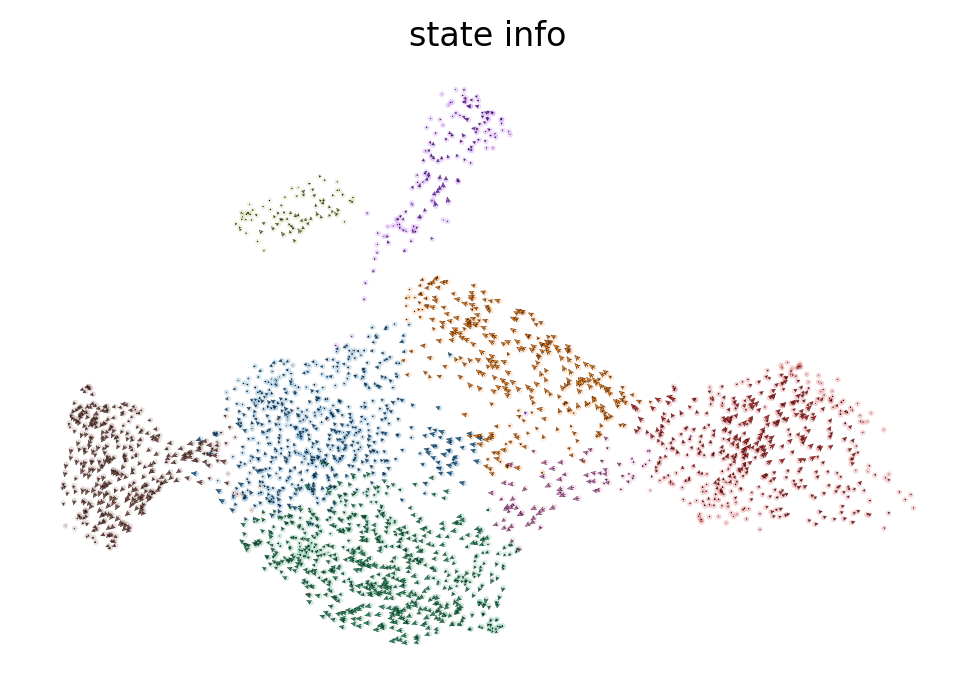

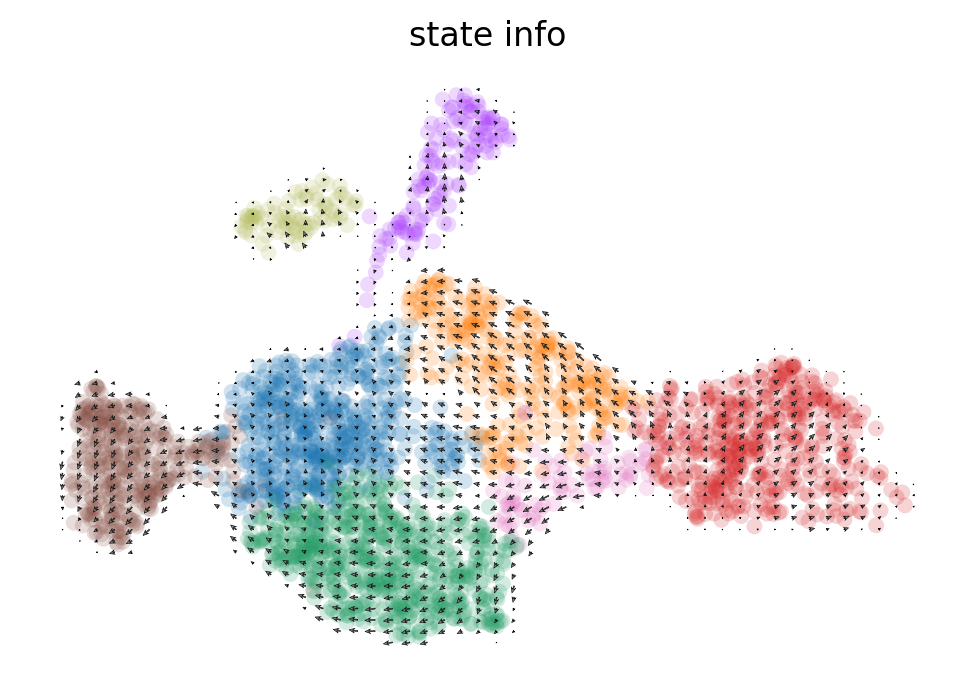

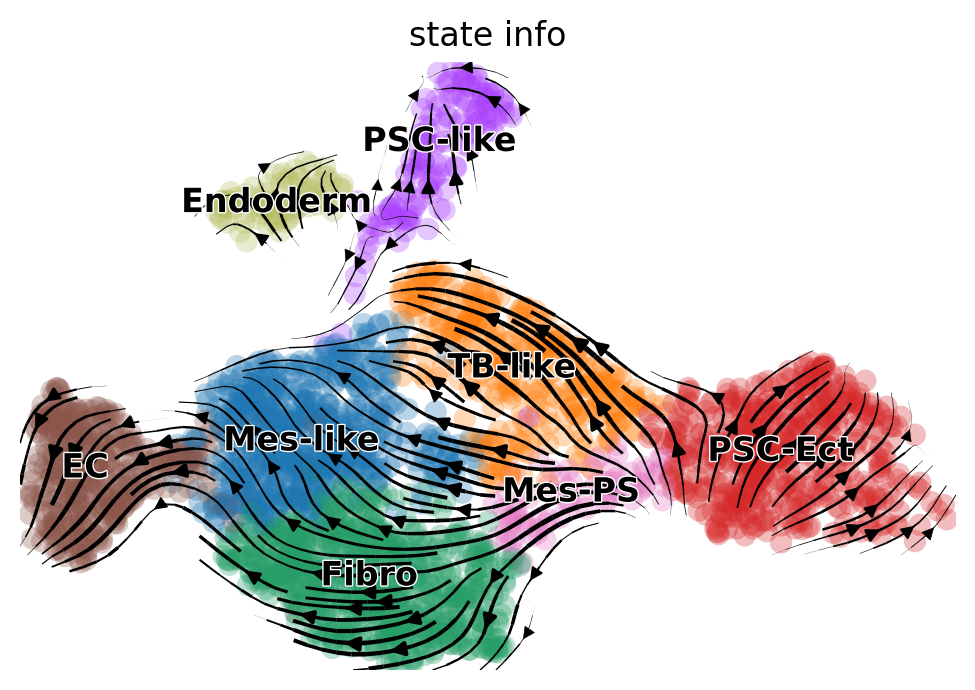

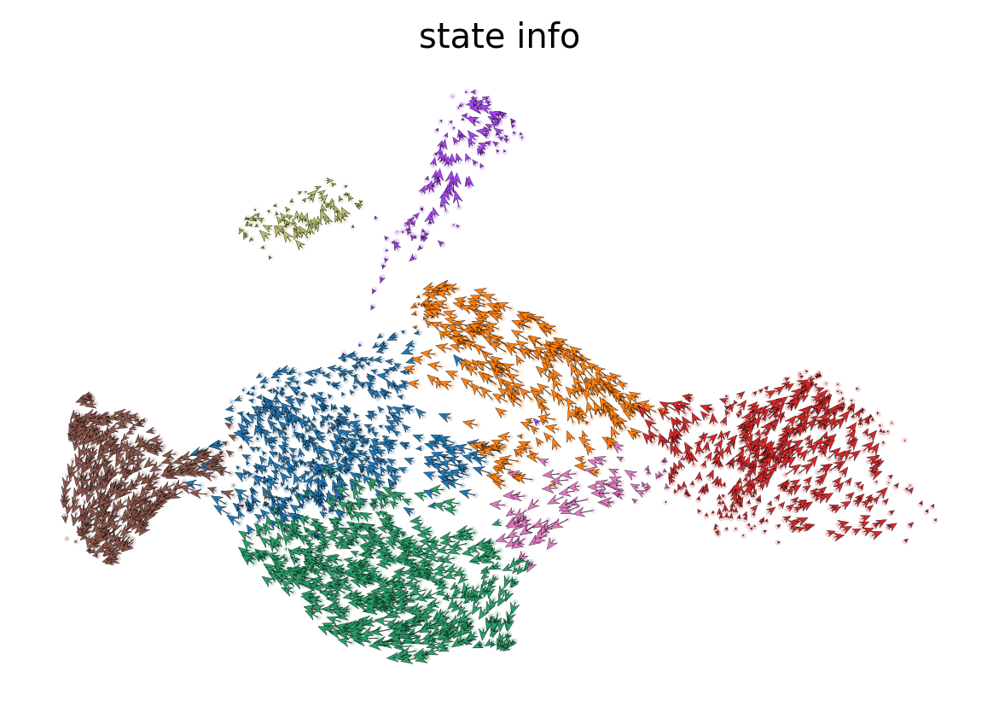

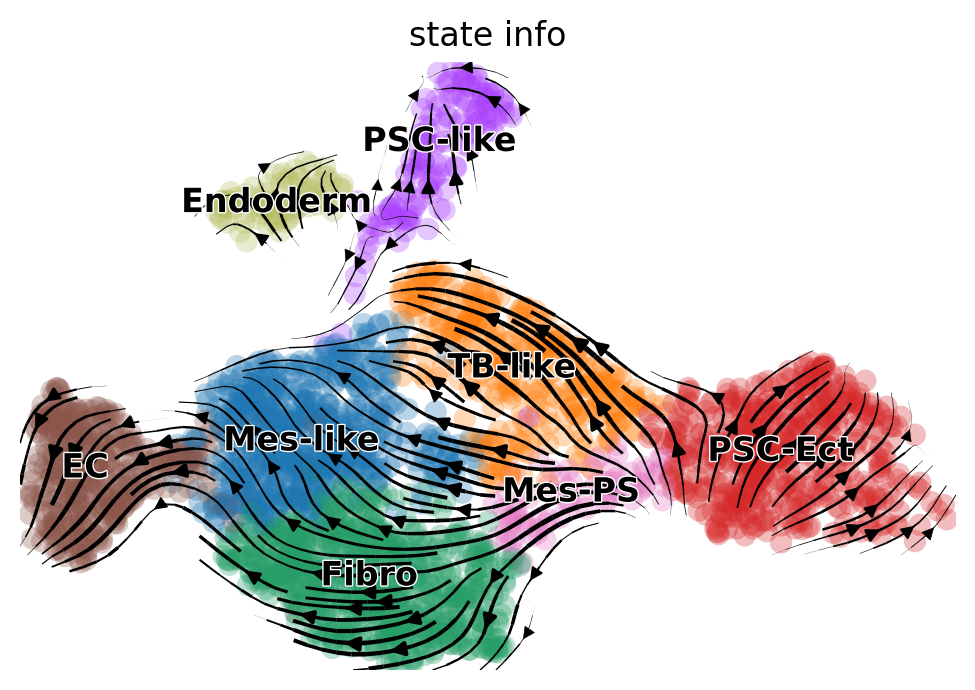

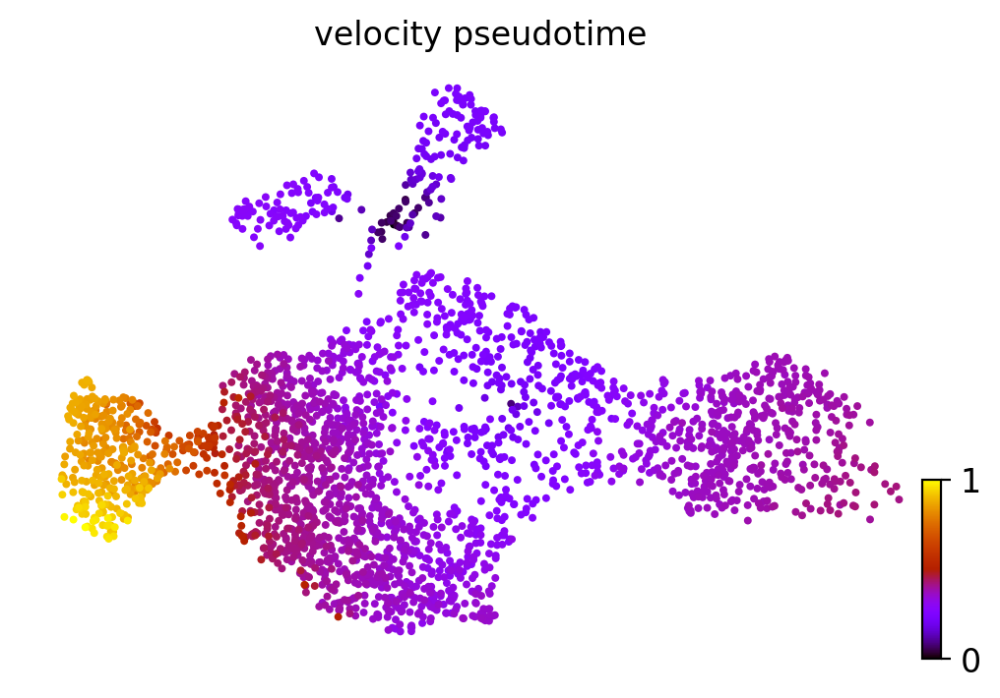

In [136]:
scv.pl.velocity_embedding(vadata, basis='X_emb', color="state_info")
scv.pl.velocity_embedding_grid(vadata, basis='X_emb', color="state_info")
scv.pl.velocity_embedding_stream(vadata, basis='X_emb', color="state_info")
scv.pl.velocity_embedding(vadata, arrow_length=3, arrow_size=2, dpi=120, basis='X_emb', color="state_info")
scv.pl.velocity_embedding_stream(vadata, basis='X_emb', color="state_info")
scv.tl.velocity_pseudotime(vadata)
scv.pl.scatter(vadata, color='velocity_pseudotime', cmap='gnuplot', basis='X_emb', )

In [137]:
# tar_l = ['3085A>G', '3955G>A', '1380G>A', '2501C>A', '1526T>A', '2349G>A', '2352T>A', '1525C>A', '1521T>A', '1522T>A']
tar_l = af_columns
_tmp_af = af_df[tar_l].copy()

_tmp_af[_tmp_af>=0.1] = 1
_tmp_af[_tmp_af<0.1] = 0
_tmp_af = _tmp_af.astype('int')
_tmp_af['barcode'] = af_df['barcode']
# _tmp_af.head()

In [138]:
m_df = pd.merge(t_larry_df, _tmp_af, how='left', on='barcode').dropna()
m_df.head()

,barcode,clone,7402C>T,7896G>A,7116C>T,2501C>A,2502C>A,6300G>A,15016C>A,3019G>A,...,8576T>G,1123C>A,13037C>T,2507A>T,9204A>G,12139A>G,8271A>T,2317G>A,6699G>A,8087T>G
0,AAACCCACAAGACCTT-1,GGTTTGAGCACAGATTACAATAGACCCGGTCTCGAGACAA,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,AAACCCAGTCAGGTAG-1,TGACTGAACTCATTCAACAAGGGAAAGAGTGGTAAGCGAA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,AAACCCATCAGGAACG-1,AGTATGATAACAGAATACTCAGGAGTCCGTTGGTAGCGGA-CACGT...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,AAACGAAAGCGTATAA-1,CCTTTGACAACATCAAACCAGTGACGTTGTTTAGAGATAT,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,AAACGAACAAACGAGC-1,CCCATGTCTTCATGTAACAAGGGAAGAAGTTCAAAGTCAA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [139]:
t_larry_df.shape, _tmp_af.shape, m_df.shape

((2667, 2), (5923, 36), (2628, 37))

In [141]:
_gy = m_df.groupby(['clone'], as_index=False)
m_cnt_t = _gy.agg({s: 'sum' for s in tar_l})

m_cnt_t['count'] = _gy.size().reset_index()['size']
print(m_cnt_t.shape)
# m_cnt_t.head()

(854, 37)


In [142]:
# tar_l = ['3085A>G', '3955G>A', '1380G>A', '2501C>A', '1526T>A', '2349G>A', '2352T>A', '1525C>A', '1521T>A', '1522T>A']
tar_l = af_columns
_tmp_af = af_df[tar_l].copy()

_tmp_af[_tmp_af>=0.1] = 1
_tmp_af[_tmp_af<0.1] = 0
_tmp_af = _tmp_af.astype('int')
_tmp_af['barcode'] = af_df['barcode']
_tmp_af['m_clone'] = tmp_merge_o['clone']
m_df = pd.merge(t_larry_df, _tmp_af, how='left', on='barcode').dropna()
tar_l = tmp_merge_o['clone'].unique().tolist()
for i in tar_l:
    m_df[i] = m_df.apply(lambda x: 1 if x['m_clone'] == i else 0, axis=1)
# m_df.head()

In [143]:
tmp_merge_o['clone'].unique().tolist()

['clone_A2', 'clone_A0', 'clone_A1']

In [144]:
_gy = m_df.groupby(['clone'], as_index=False)
m_cnt_t = _gy.agg({s: 'sum' for s in tar_l})

m_cnt_t['count'] = _gy.size().reset_index()['size']
print(m_cnt_t.shape)
# m_cnt_t.head()

(854, 5)


In [145]:
def check_conflict(x, tar_l):
    _mis_m, _m = 0, 0
    for i in tar_l:
        if x[i] == 0:
            continue
        else:
            if x[i] == x['count']:
                _m += 1
            else:
                _mis_m += 1
    if _mis_m == 0:
        return True
    elif _m > 1:
    # elif _m > _mis_m:
        return True
    return False
n_m_cnt_t = m_cnt_t.loc[m_cnt_t.apply(lambda x: check_conflict(x, tar_l), axis=1)]

In [146]:
pd.options.display.max_columns = None

print(n_m_cnt_t.shape)
n_m_cnt_t.head()

(408, 5)


,clone,clone_A2,clone_A0,clone_A1,count
0,AAAATGACCGCACCGTACCATAGAAGAGGTCTTGAGCAGC,2,0,0,2
1,AAAATGCAATCACAAGACTACTGAGCAGGTGTGGAGAGAA,0,0,2,2
3,AAACTGATGACAACAAACCCGTGACAGTGTATATAGATAA-CCCCT...,0,0,2,2
4,AAACTGCCCGCAAGACACTTGAGAGAATGTCCGAAGTAAG,0,0,2,2
5,AAACTGGAGGCAACTCACACATGAAATGGTGACTAGAGGC,0,0,2,2


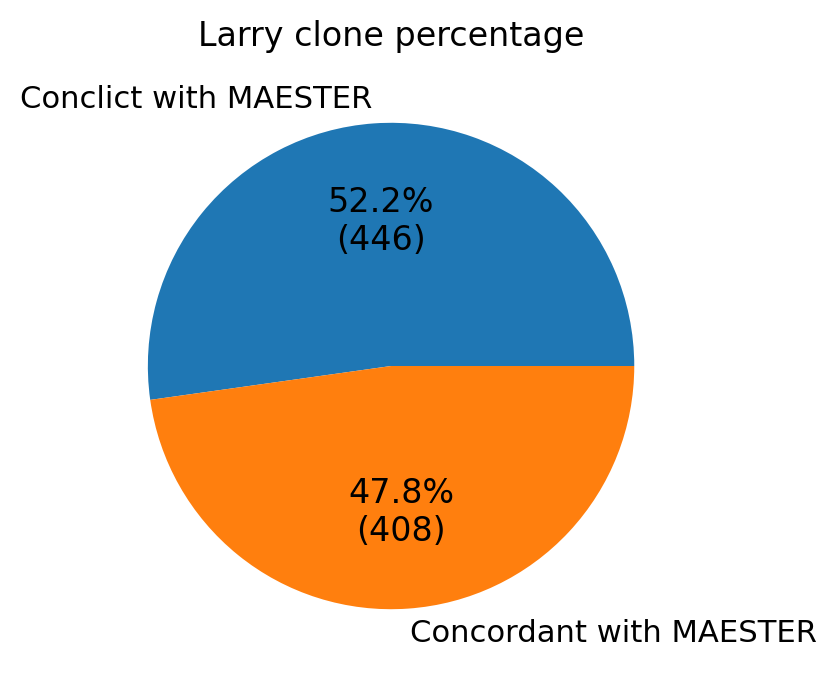

In [147]:
_t1, _t2 = m_cnt_t.shape[0] - n_m_cnt_t.shape[0], n_m_cnt_t.shape[0]
_tmp_p_tb = pd.DataFrame({'number': [_t1, _t2]},
                  index=['Conclict with MAESTER', 'Concordant with MAESTER'])

def autopct_format(values):
    def my_format(pct):
        total = values.sum().values[0]
        val = int(round(pct*total/100.0))
        return '{:.1f}%\n({v:d})'.format(pct, v=val)
    return my_format

# plt.pie(mydata,labels = mylabels, autopct=autopct_format(mydata))

fig, ax = plt.subplots( 
    nrows=1,
    ncols=1,
    figsize=(4, 4)
)
_tmp_p_tb.plot(kind='pie', y='number', autopct=autopct_format(_tmp_p_tb), ax=ax)
ax.set_title("Larry clone percentage")
ax.set_ylabel('')
ax.get_legend().remove()

In [154]:
n_larry_df = _larry_df[_larry_df['clone'].isin(n_m_cnt_t.clone)]

In [155]:
df1 = t_adata.obs['cell_type'].to_frame().reset_index().rename(columns={"index":"barcode"})
df2 = n_larry_df
_tar_df1 = pd.merge(df1, df2, how="inner", on="barcode").dropna()
_tar_df2 = _tar_df1.groupby("clone").agg({ "cell_type": lambda x: x.nunique(), "barcode": 'size'})
_l2_clone_size = len(_tar_df2.index)
_l2_clone_size_cell = _tar_df2.barcode.sum()
_l2_clone_ind_cellfate = len(_tar_df2[_tar_df2['cell_type'] <= 1].index)
_l2_clone_ind_cellfate_cell = _tar_df2[_tar_df2['cell_type'] <= 1].barcode.sum()
_l2_clone_size, _l2_clone_size_cell, _l2_clone_ind_cellfate, _l2_clone_ind_cellfate_cell

(408, 1021, 200, 439)

In [156]:
_cmb_df = pd.DataFrame({"": ["Larry only", "Larry with MAESTER"], 
              "Clone number": [_l1_clone_size, _l2_clone_size], 
              "Clones with Ind cell fate": [_l1_clone_ind_cellfate, _l2_clone_ind_cellfate], 
              "Cell number": [_l1_clone_size_cell, _l2_clone_size_cell], 
              "Cells with Ind cell fate": [_l2_clone_ind_cellfate_cell, _l2_clone_ind_cellfate_cell]})
_cmb_df['Clones with Ind cell fate %'] = _cmb_df['Clones with Ind cell fate'] / _cmb_df['Clone number'] * 100
_cmb_df['Cells with Ind cell fate %'] = _cmb_df['Cells with Ind cell fate'] / _cmb_df['Cell number'] * 100
_cmb_df

,,Clone number,Clones with Ind cell fate,Cell number,Cells with Ind cell fate,Clones with Ind cell fate %,Cells with Ind cell fate %
0,Larry only,857,360,2667,439,42.007001,16.460442
1,Larry with MAESTER,408,200,1021,439,49.019608,42.997062


In [157]:
# print(_cmb_df)

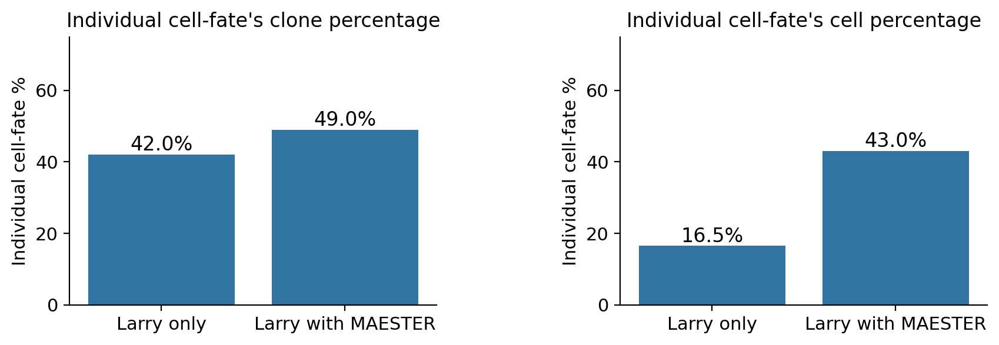

In [158]:
fig, axs = plt.subplots( 
    nrows=1,
    ncols=2,
    figsize=(10, 3)
)

ax = axs[0]
sns.barplot(_cmb_df, y='Clones with Ind cell fate %', x="", ax=ax)

# _tmp_p_tb.plot(kind='pie', y='number', autopct=autopct_format(_tmp_p_tb), ax=ax)
ax.set_title("Individual cell-fate's clone percentage")
ax.set_ylabel('Individual cell-fate %')
for container in ax.containers:
    ax.bar_label(container, fmt='%.1f%%')

ax.set(ylim=(0, 75))

ax = axs[1]
sns.barplot(_cmb_df, y='Cells with Ind cell fate %', x="", ax=ax)

# _tmp_p_tb.plot(kind='pie', y='number', autopct=autopct_format(_tmp_p_tb), ax=ax)
ax.set_title("Individual cell-fate's cell percentage")
ax.set_ylabel('Individual cell-fate %')
for container in ax.containers:
    ax.bar_label(container, fmt='%.1f%%')

ax.set(ylim=(0, 75))

fig.subplots_adjust(wspace=0.5)


In [160]:
t_adata = adata[adata.obs_names.isin(n_larry_df.barcode)]

t_df_time = pd.DataFrame(data={'time_info': [1] * len(t_adata.obs_names)})
t_df_time.head()
n_adata_orig = cs.pp.initialize_adata_object(
    X_state=t_adata.layers['counts'],
    gene_names=t_adata.var_names,
    cell_names=t_adata.obs_names,
    time_info=t_df_time["time_info"],
    state_info=t_adata.obs['cell_type'],
    X_emb=t_adata.obsm['X_umap'],
    X_pca =t_adata.obsm['X_pca'],
    data_des="my_data",
)

Create new anndata object
Time points with clonal info: []


Finding highly variable genes...


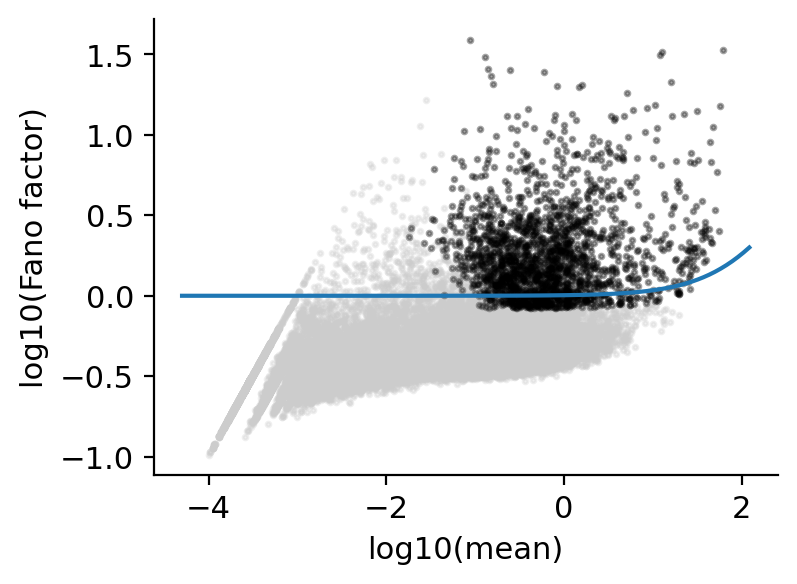

Keeping 1906 genes


In [161]:
cs.pp.get_highly_variable_genes(
    n_adata_orig,
    normalized_counts_per_cell=10000,
    min_counts=3,
    min_cells=3,
    min_gene_vscore_pctl=90,
)


In [162]:
cs.pp.get_X_clone(n_adata_orig, n_larry_df["barcode"], n_larry_df["clone"])

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1021/1021 [00:00<00:00, 900796.04it/s]

reorder clones


Text(0.5, 1.0, 'D4 dataset, concordant cell in LARRY and MAESTER')

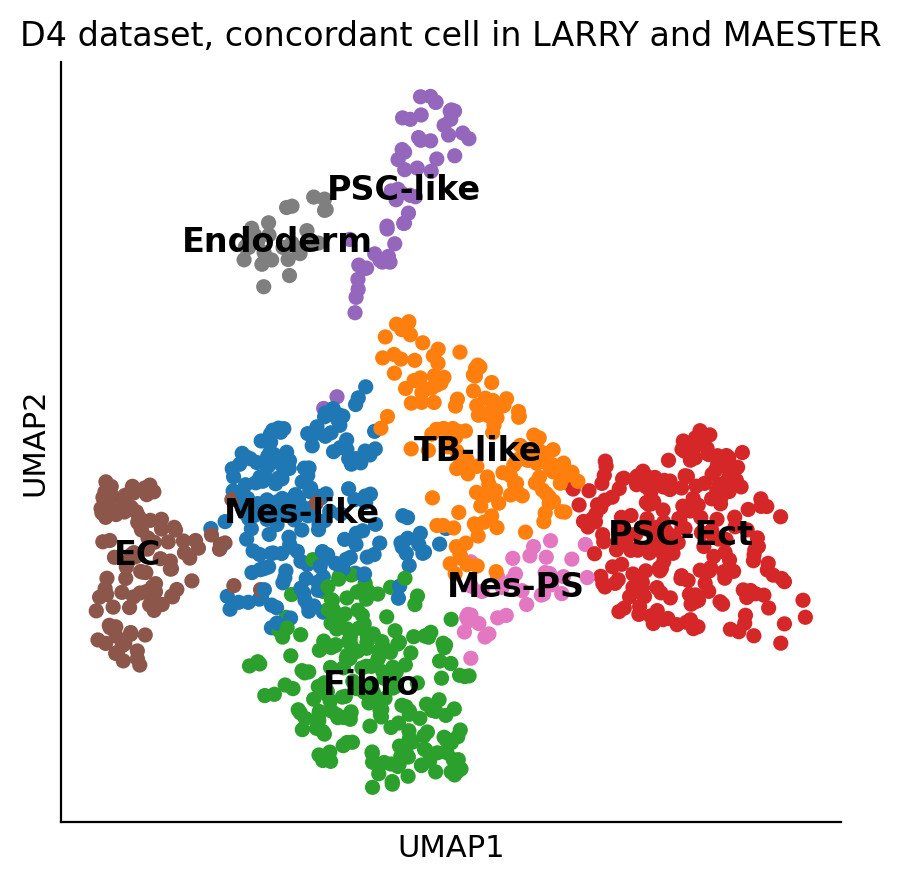

In [164]:
fig, ax = plt.subplots(figsize=(5, 5))
ax = sc.pl.embedding (n_adata_orig, basis="X_emb",  color="state_info", legend_loc="on data", show=False, ax=ax, size=120)
ax.set_xlabel('UMAP1')
ax.set_ylabel('UMAP2')
ax.set_title('D4 dataset, concordant cell in LARRY and MAESTER')

Data saved at adata.uns['barcode_heatmap']


<Axes: title={'center': '408 clones'}>

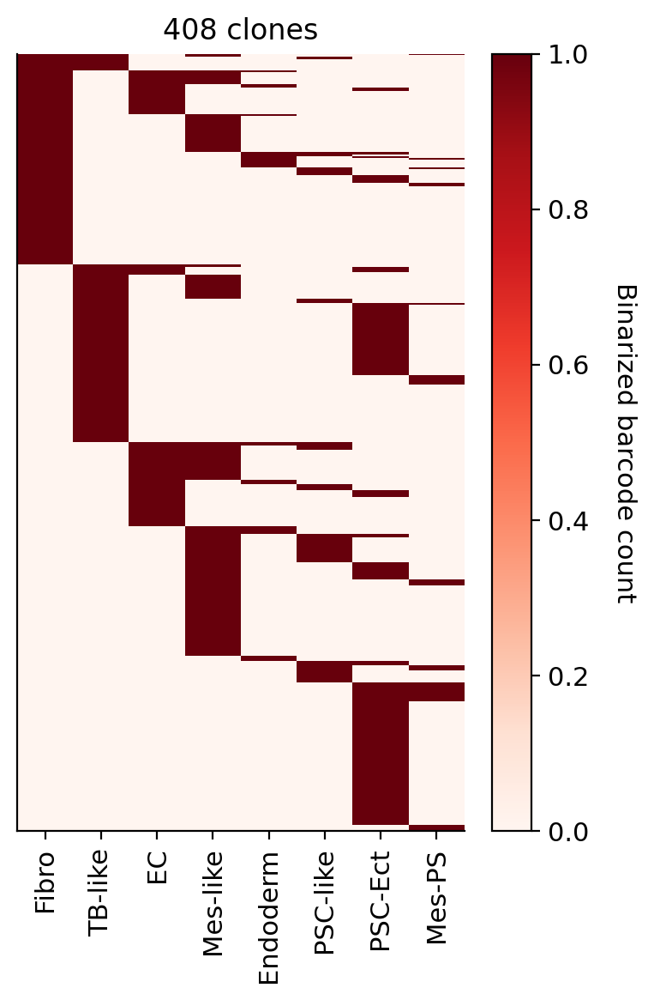

In [165]:
selected_times = None

cs.pl.barcode_heatmap(
    n_adata_orig,
    color_bar=True,
    log_transform=False,
    binarize=True,
)

normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
Results saved as dictionary at adata.uns['fate_coupling_X_clone']


Text(0.5, 1.0, 'Fate coupling score based on LARRY clone')

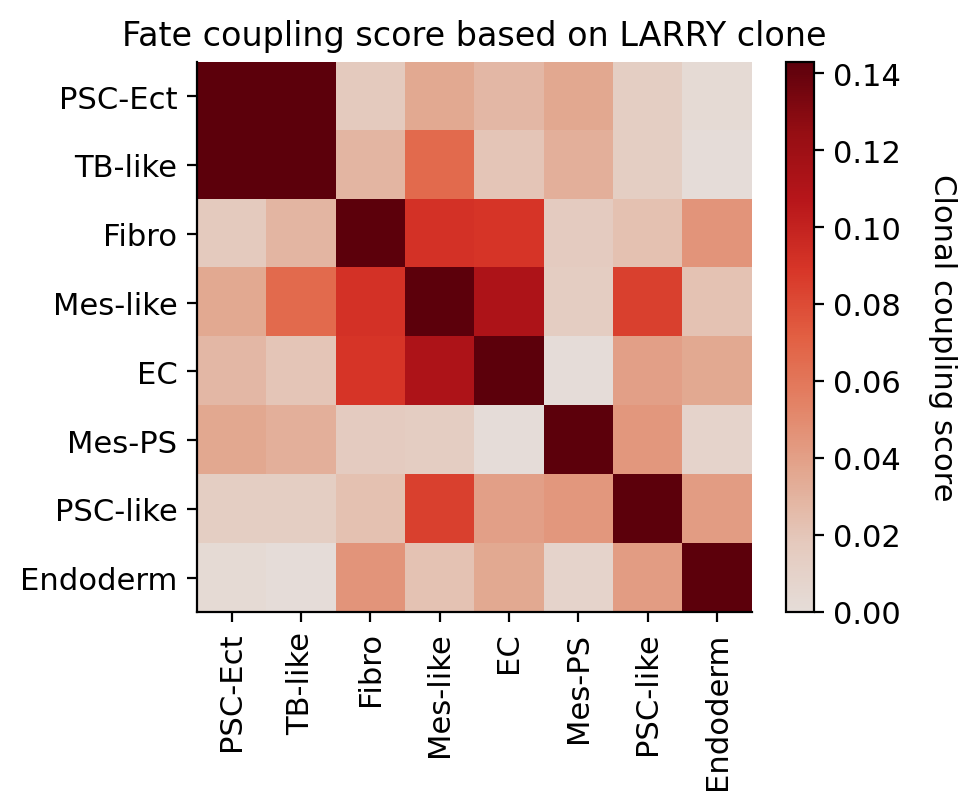

In [166]:
cs.tl.fate_coupling(
    n_adata_orig, source="X_clone"
)  # compute the fate coupling

fig, ax = plt.subplots(figsize=(5, 4))
cs.pl.fate_coupling(n_adata_orig, source="X_clone", ax=ax)  # actually plot the coupling
ax.set_title('Fate coupling score based on LARRY clone')

(8, 200) (8, 208)
1e-10
[0 1 2 3 4 5 6 7]


Text(0.5, -4.40277777777777, 'Cell type')

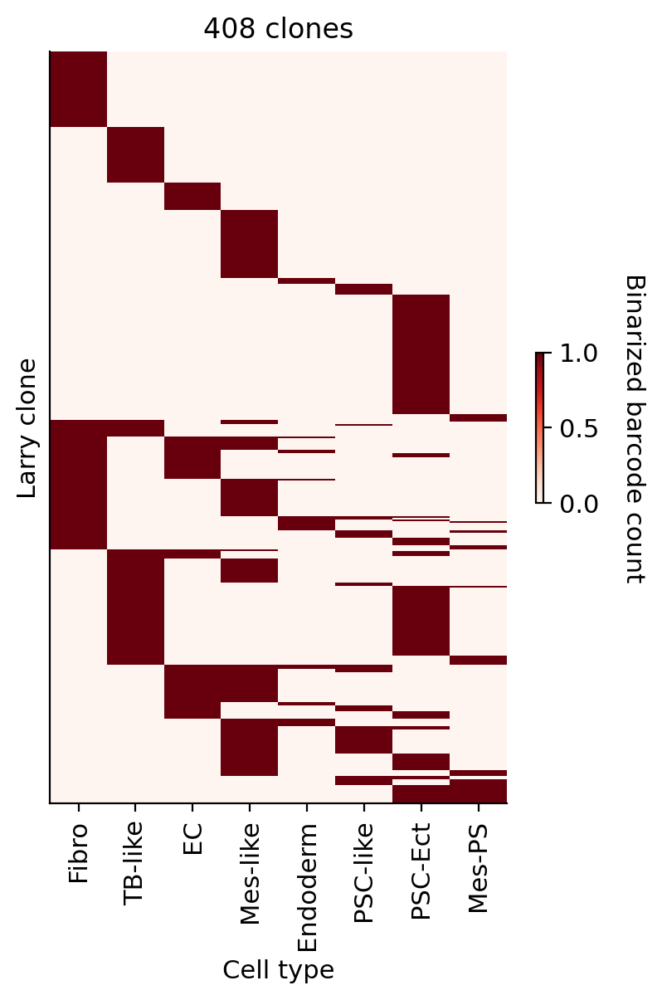

In [167]:
ax = barcode_heatmap(
    n_adata_orig,
    color_bar=True,
    log_transform=False,
    binarize=True,
)
ax.set_ylabel('Larry clone')
ax.set_xlabel('Cell type')

normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
Results saved as dictionary at adata.uns['fate_coupling_X_clone']
x_order: [0,1,2,3,4,5,6,7]
x_ticks: ['Fibro','TB-like','EC','Mes-like','Endoderm','PSC-like','PSC-Ect','Mes-PS']
y_order: [0,1,2,3,4,5,6,7]
y_ticks: ['Fibro','TB-like','EC','Mes-like','Endoderm','PSC-like','PSC-Ect','Mes-PS']


Text(0.5, 1.0, 'Fate coupling score based on LARRY clone')

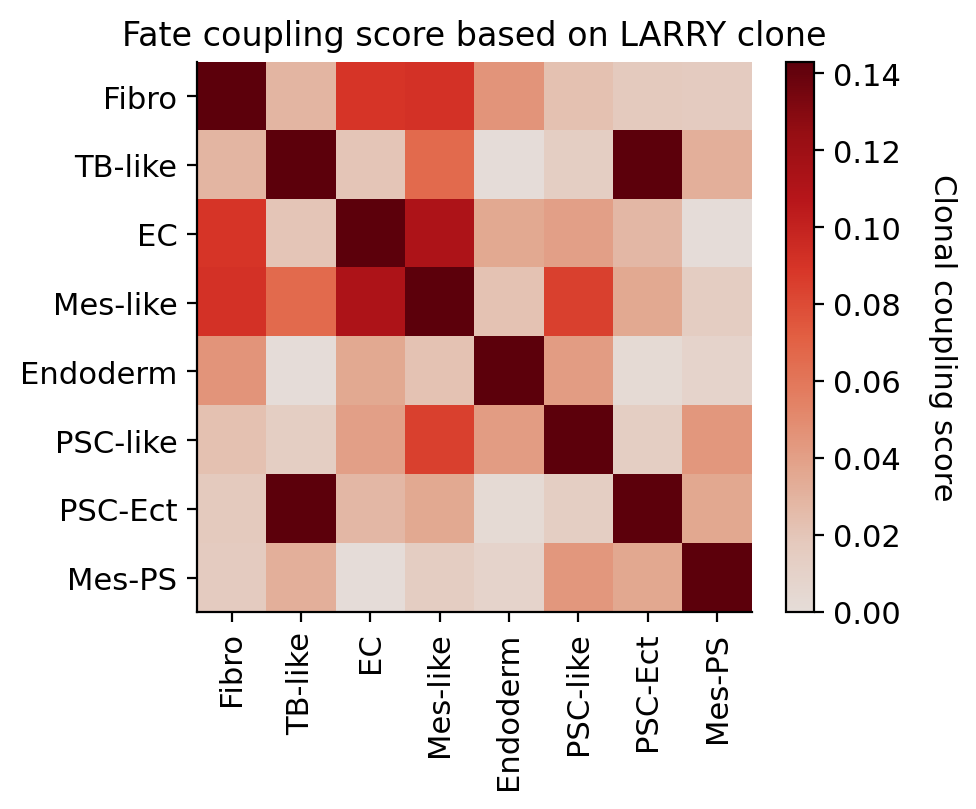

In [168]:
cs.tl.fate_coupling(
    n_adata_orig, source="X_clone"
)  # compute the fate coupling

fig, ax = plt.subplots(figsize=(5, 4))
cs.pl.fate_coupling(n_adata_orig, source="X_clone", ax=ax, order_map_x=False, order_map_y=False, print_ordered_labels=True)  # actually plot the coupling
# heatmap(adata_orig.uns["fate_coupling_X_clone"]["X_coupling"], ax=ax, order_map_x=True, order_map_y=True, print_ordered_labels=True)  # actually plot the coupling
ax.set_title('Fate coupling score based on LARRY clone')

In [169]:
cs.tl.fate_hierarchy(
    n_adata_orig, source="X_clone"
)  # compute the fate hierarchy
cs.pl.fate_hierarchy(n_adata_orig, source="X_clone")  # actually plot the hierarchy

normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
normalize by X_clone
each selected cluster has a unique time point. Normalize per time point
Results saved as dictionary at adata.uns['fate_hierarchy_X_clone']

         /-PSC-like
      /-|
     |   \-Endoderm
     |
   /-|         /-Mes-like
  |  |      /-|
  |  |   /-|   \-EC
  |  |  |  |
  |   \-|   \-Fibro
--|     |
  |     |   /-PSC-Ect
  |      \-|
  |         \-TB-like
  |
   \-Mes-PS


In [170]:
_n_adata_orig = n_adata_orig
vadata = scv.utils.merge(_n_adata_orig, ldata)
scv.pp.filter_and_normalize(vadata, log=False)
scv.pp.moments(vadata)

Normalized count data: spliced, unspliced.
computing neighbors


/tmp/ipykernel_906731/3475590343.py:4: DeprecationWarning: Automatic neighbor calculation is deprecated since scvelo==0.4.0 and will be removed in a future version of scVelo. Please compute neighbors first with Scanpy.
  scv.pp.moments(vadata)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scvelo/preprocessing/moments.py:71: DeprecationWarning: `neighbors` is deprecated since scvelo==0.4.0 and will be removed in a future version of scVelo. Please compute neighbors with Scanpy.
  neighbors(


    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


computing velocities


/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scvelo/tools/optimization.py:184: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  gamma[i] = np.linalg.pinv(A.T.dot(A)).dot(A.T.dot(y[:, i]))


    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/48 cores)


  0%|          | 0/1021 [00:00<?, ?cells/s]

/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/multiprocessing/popen_fork.py:66: DeprecationWarning: This process (pid=906731) is multi-threaded, use of fork() may lead to deadlocks in the child.
  self.pid = os.fork()


    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_emb', embedded velocity vectors (adata.obsm)


/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/autofs/ba

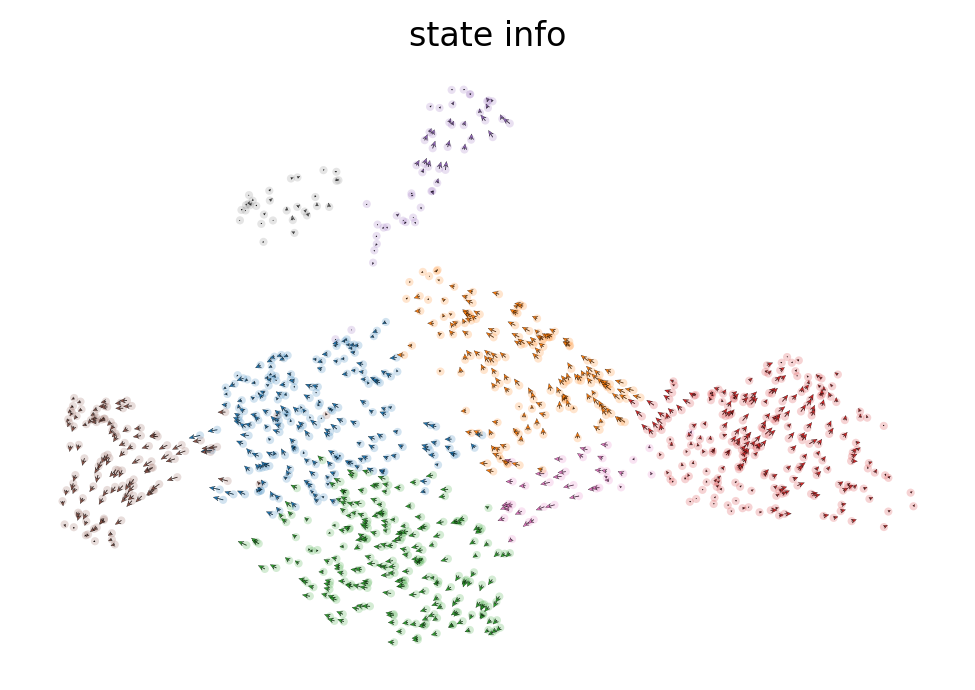

In [171]:
scv.tl.velocity(vadata, mode='stochastic')
scv.tl.velocity_graph(vadata)
scv.pl.velocity_embedding(vadata, basis='X_emb', color="state_info")
import warnings
warnings.filterwarnings("ignore")

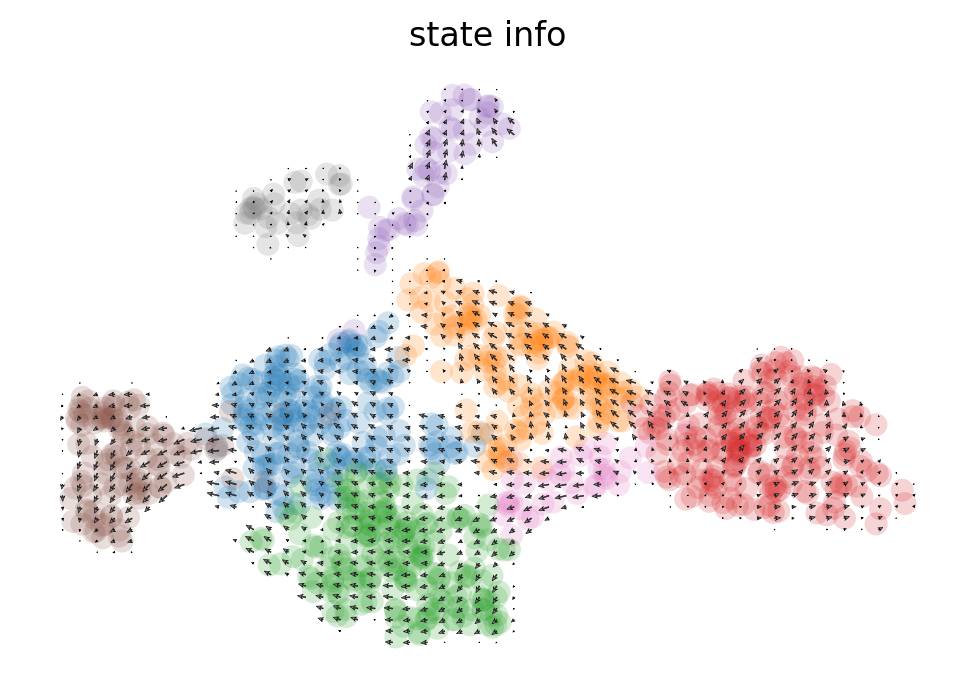

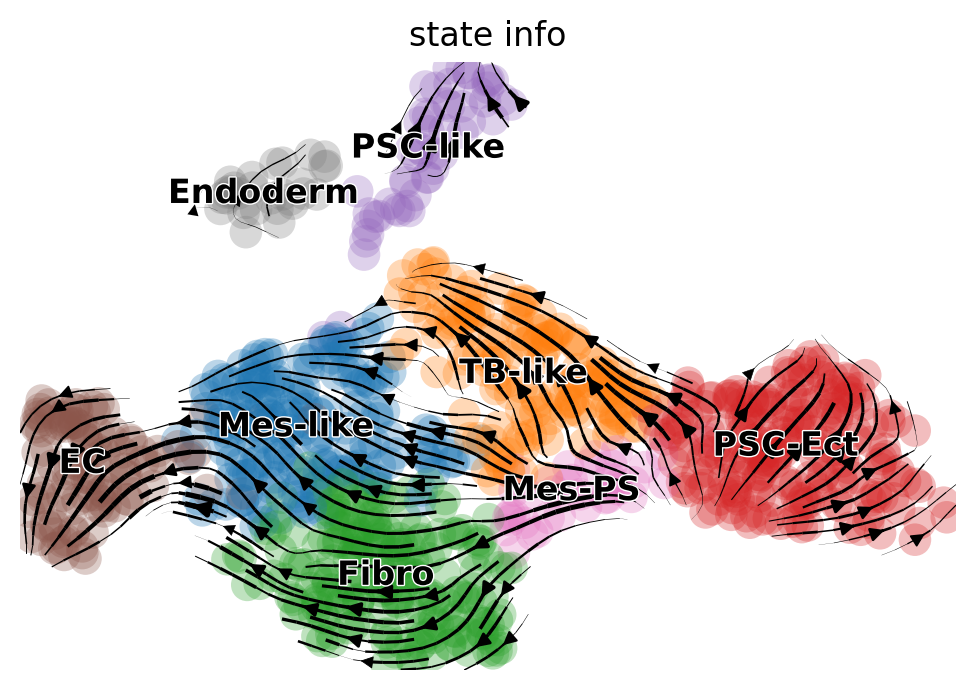

In [172]:
scv.pl.velocity_embedding_grid(vadata, basis='X_emb', color="state_info")
scv.pl.velocity_embedding_stream(vadata, basis='X_emb', color="state_info")

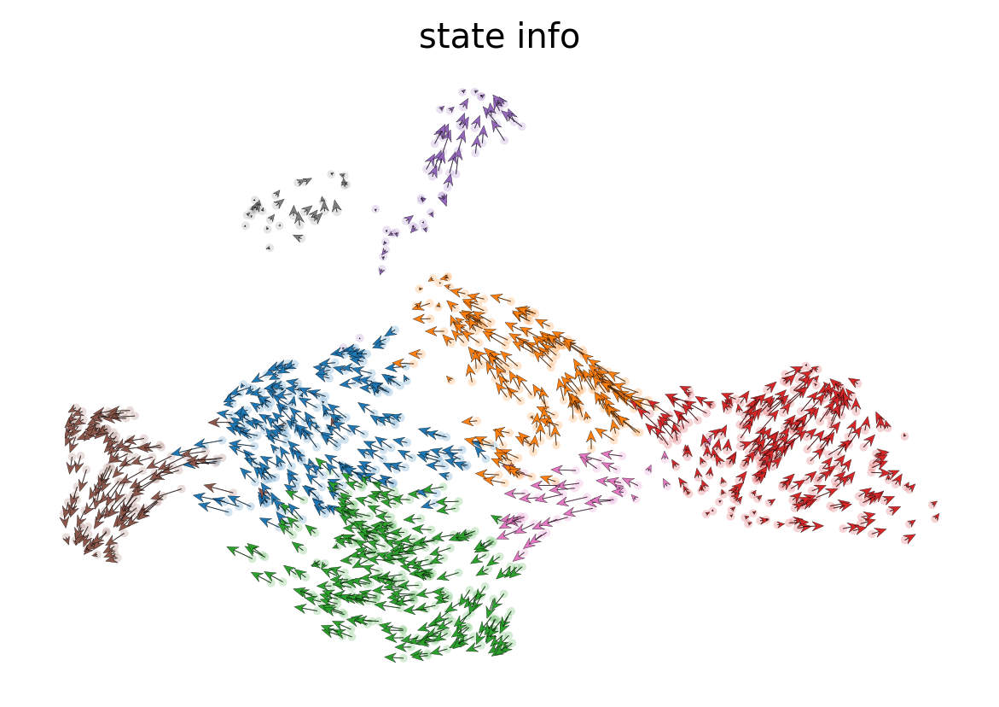

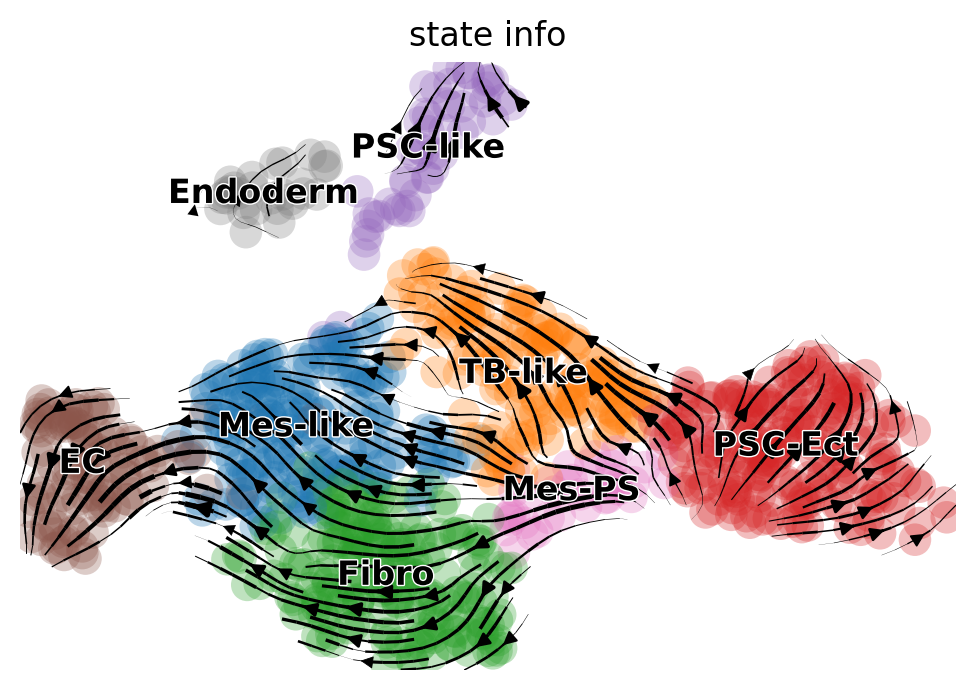

computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


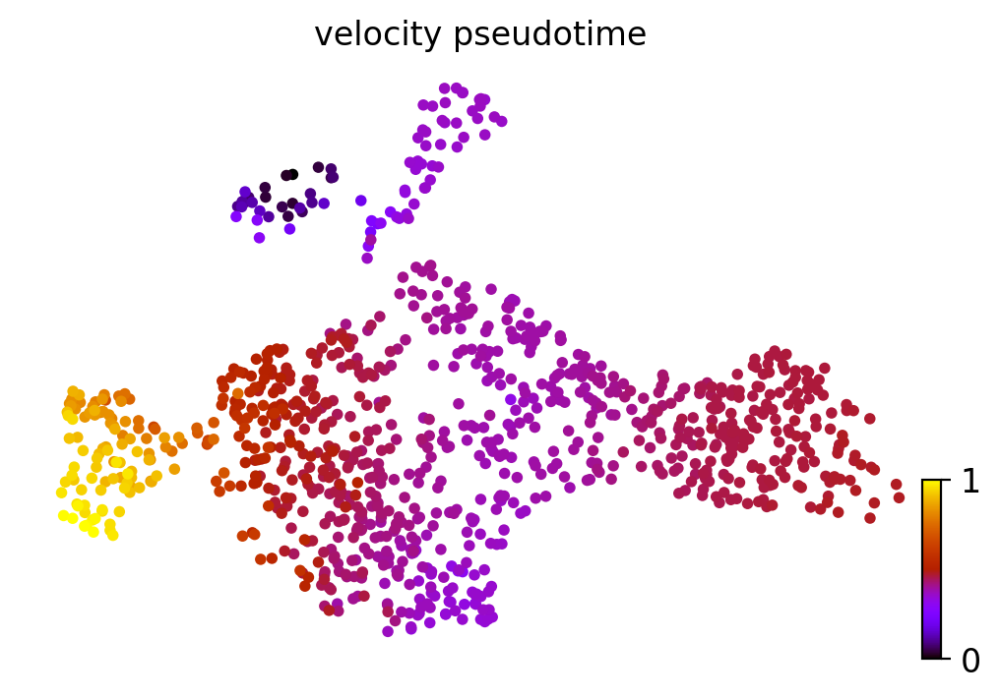

In [173]:
scv.pl.velocity_embedding(vadata, arrow_length=3, arrow_size=2, dpi=120, basis='X_emb', color="state_info")
scv.pl.velocity_embedding_stream(vadata, basis='X_emb', color="state_info")
scv.tl.velocity_pseudotime(vadata)
scv.pl.scatter(vadata, color='velocity_pseudotime', cmap='gnuplot', basis='X_emb', )

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)


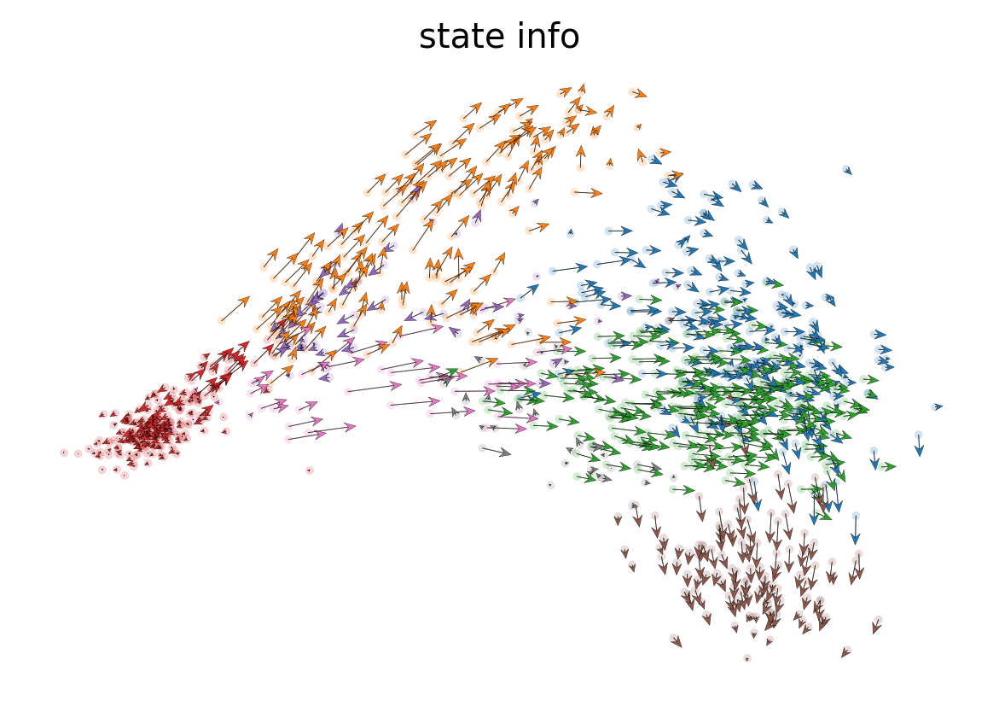

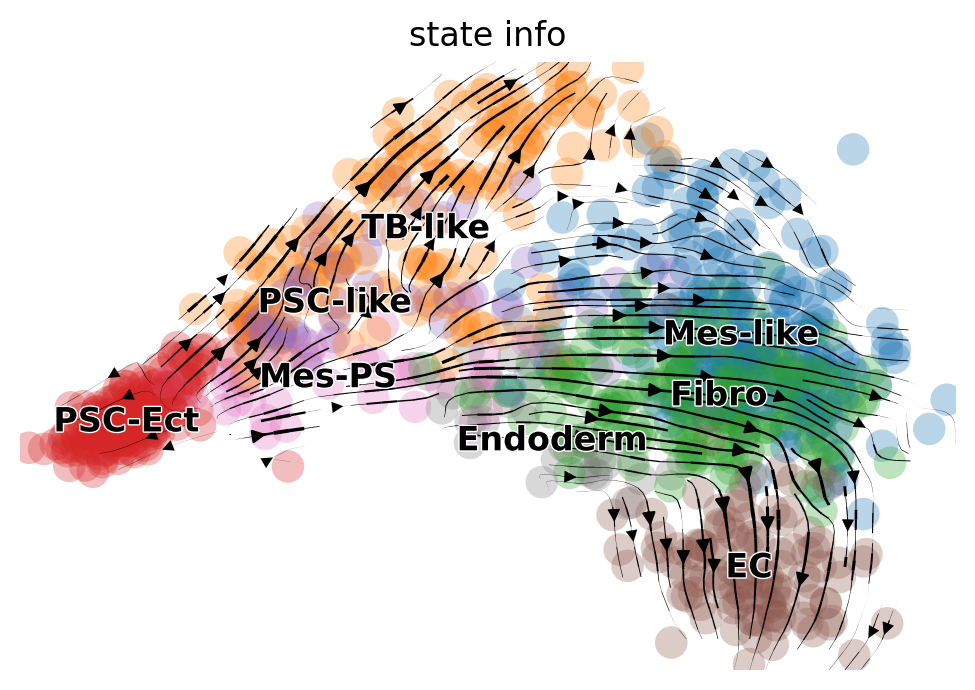

In [175]:
scv.pl.velocity_embedding(vadata, arrow_length=3, arrow_size=2, dpi=120, basis='pca', color="state_info")
scv.pl.velocity_embedding_stream(vadata, basis='pca', color="state_info")
# scv.tl.velocity_pseudotime(vadata)
# scv.pl.scatter(vadata, color='velocity_pseudotime', cmap='gnuplot')

In [176]:
# !pip install python-igraph --upgrade --quiet

In [177]:
# this is needed due to a current bug - bugfix is coming soon.
vadata.uns['neighbors']['distances'] = vadata.obsp['distances']
vadata.uns['neighbors']['connectivities'] = vadata.obsp['connectivities']

In [178]:
scv.tl.paga(vadata, groups='state_info')
# df = scv.get_df(vadata, 'paga/transitions_confidence', precision=2).T
# df.style.background_gradient(cmap='Blues').format('{:.2g}')

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


<Axes: >

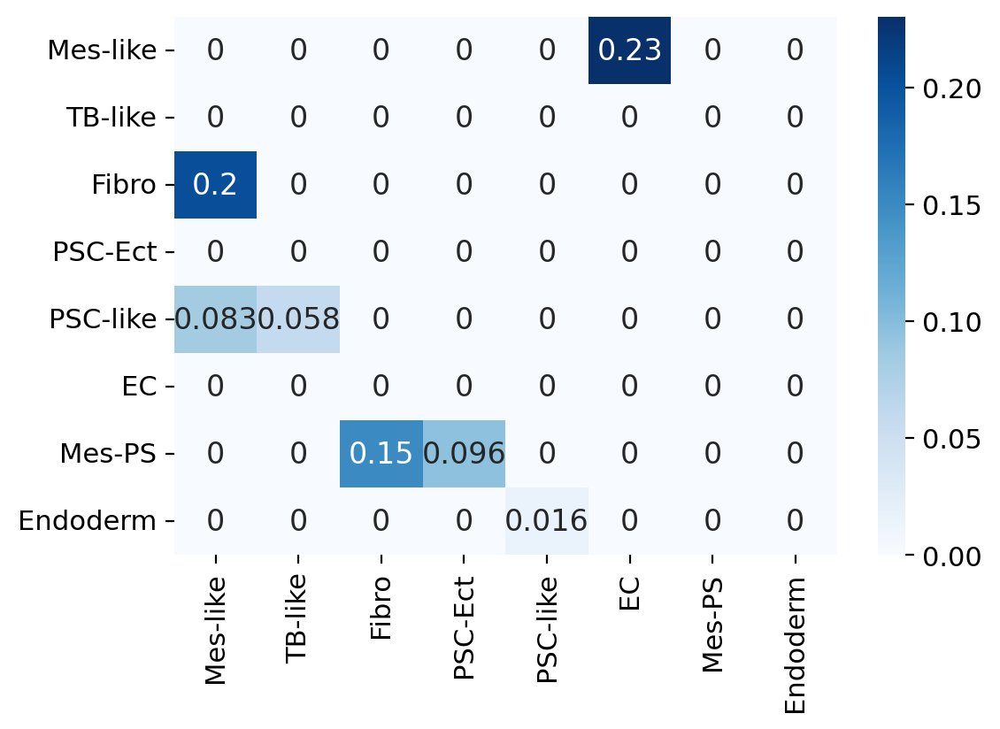

In [179]:
df = scv.get_df(vadata, 'paga/transitions_confidence', precision=2).T
sns.heatmap(df, annot=True, cmap='Blues')

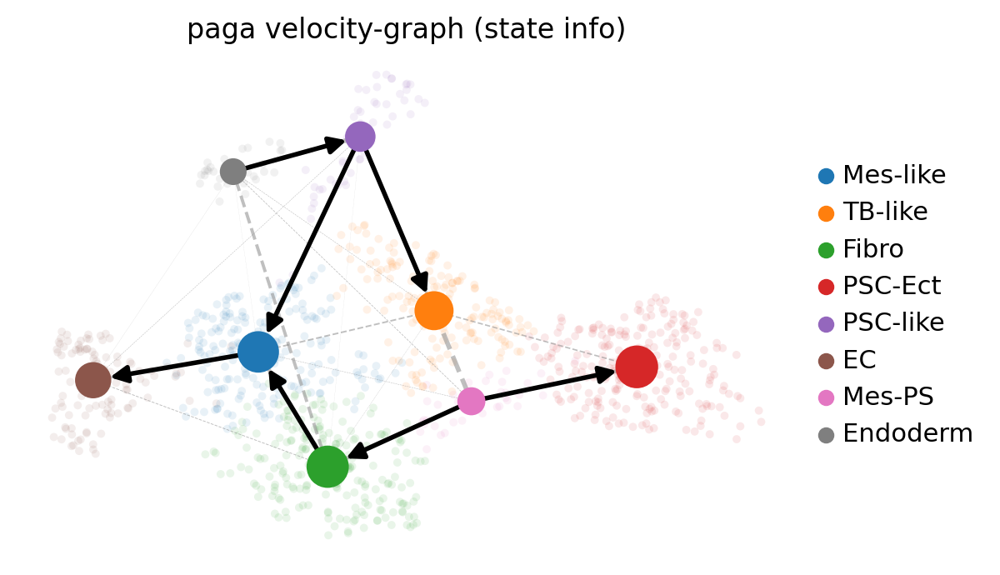

In [180]:
scv.pl.paga(vadata, basis='emb', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5)

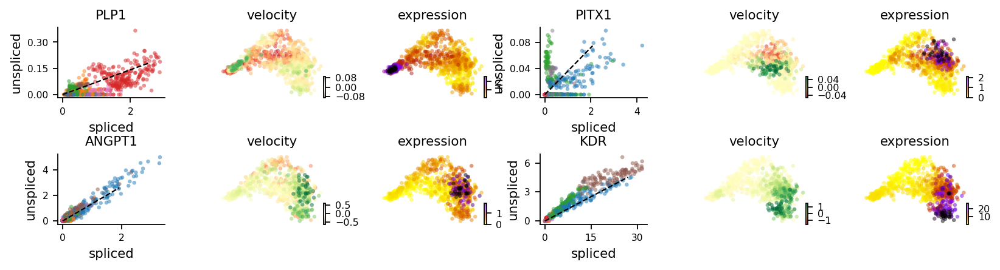

In [181]:
scv.pl.velocity(vadata, ['PLP1',  'PITX1', 'ANGPT1', 'KDR'], ncols=2, color="state_info")


In [182]:
scv.tl.rank_velocity_genes(vadata, groupby='state_info', min_corr=.3)

df = pd.DataFrame(vadata.uns['rank_velocity_genes']['names'])
df.head()

ranking velocity genes
    finished (0:00:10) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,Mes-like,TB-like,Fibro,PSC-Ect,PSC-like,EC,Mes-PS,Endoderm
0,ATP8B4,UNC13C,CDH11,LINC01162,EPHA6,IQGAP2,GRPR,PCSK2
1,GLI3,PATJ,GPC6,ESRP1,CRYM,MOB1B,ENPP1,GRPR
2,RBMS1,CNTN4,DYNC1I1,OPCML,PSTPIP2,PTPRM,NETO2,PDE3B
3,HMCN1,PRKD1,SVEP1,CACNA2D3,APELA,ZEB2,SHISAL2B,FAM122C
4,LHFPL2,MARK1,ADAM19,AL392023.1,HDAC9,CD109,DLL3,CRHBP


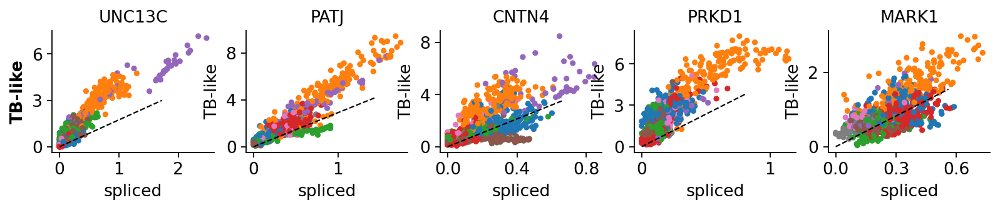

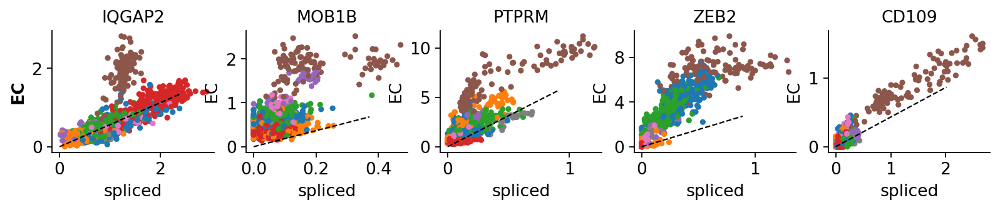

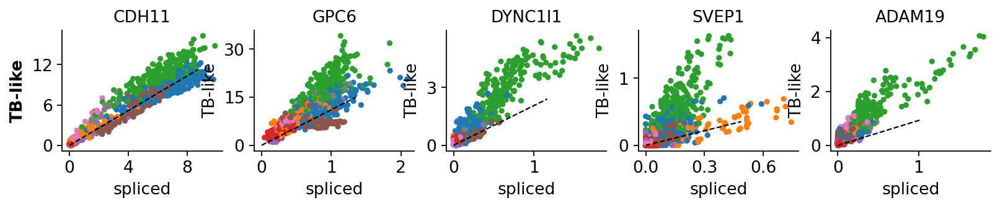

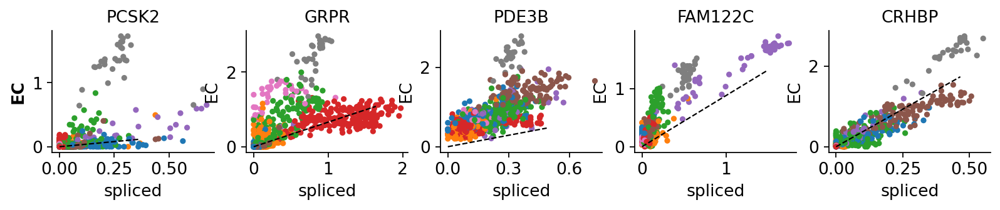

In [183]:
# kwargs = dict(frameon=False, size=10, linewidth=1.5,
#               add_outline='TB-like, EC')

scv.pl.scatter(vadata, df['TB-like'][:5], ylabel='TB-like', color='state_info')
scv.pl.scatter(vadata, df['EC'][:5], ylabel='EC', color='state_info')
scv.pl.scatter(vadata, df['Fibro'][:5], ylabel='TB-like', color='state_info')
scv.pl.scatter(vadata, df['Endoderm'][:5], ylabel='EC', color='state_info')

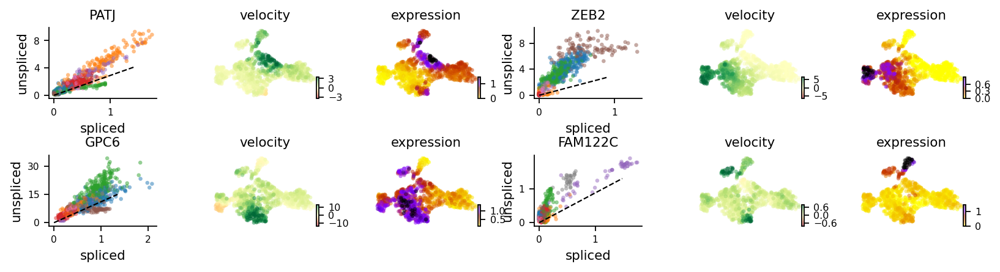

In [184]:
scv.pl.velocity(vadata, ['PATJ',  'ZEB2', 'GPC6', 'FAM122C'], basis='emb', ncols=2, color="state_info")
